# Load libraries

In [1]:
import copy
import os
import pprint
import dill

import numpy as np
import pynbody as pnb

# import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from matplotlib.legend import Legend
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# import yt
# import caesar

# import oppenheimer21.groups_profiles_all as plot_group_data
# from oppenheimer21.groups_profiles_all import run_plotting_script as opp21_plot
# import oppenheimer21.group_data

from astro_constants import NA_no_units, NA, kB_no_units, kB, mH, mp_no_units, mp, mu_e, mu, G_no_units, G
# from astro_constants import R500_OVER_R200, R200_OVER_R500, M500_OVER_M200, M200_OVER_M500

from palettable.cartocolors.sequential import DarkMint_7, BurgYl_7, Purp_7, Sunset_7, agGrnYl_7

import gc

In [2]:
R500_OVER_R200 = 0.65  # Approximately for NFW profiles, from Reiprich+13
R200_OVER_R500 = 1/R500_OVER_R200  # Approximately for NFW profiles, from Reiprich+13
# R2500_OVER_R200 = 0.3  # Porciani/Basu (Uni Bonn)
# R200_OVER_R2500 = 1/R2500_OVER_R200
# R2500_OVER_R500 = R2500_OVER_R200 * R200_OVER_R500
# R500_OVER_R2500 = 1/R2500_OVER_R500
# # R500_OVER_R200 = 0.7  # Porciani/Basu (Uni Bonn)
# # R2500_OVER_R200 = 0.4  # Liu+2023


M200_OVER_M500 = 1.4  # Eyeballed average of values from Pointecouteau+2005/Arnaud+2005
# M200_OVER_M500 = 1.5  # Suhada+2011
# M200_OVER_M500 = 1.425  # Anderson+2015
M500_OVER_M200 = 1/M200_OVER_M500

# Load simulation profiles

In [19]:
sim_dict = {
    ## Obsidian N1024L100
    r'Obsidian N1024L100 snaphsot 150 (3D)':{
        'profiles_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_150-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-extra_props.pkl',
        'params_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_150-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-parameters.pkl',
        'sim':'Simba',
    },

    r'Obsidian N1024L100 snapshot 145 (3D)':{
        'profiles_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_145-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-extra_props.pkl',
        'params_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_145-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-parameters.pkl',
        'sim':'Simba',
    },

    r'Obsidian N1024L100 snapshot 140 (3D)':{
        'profiles_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_140-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-extra_props.pkl',
        'params_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_140-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-parameters.pkl',
        'sim':'Simba',
    },
    
    r'Obsidian N1024L100 snapshot 130 (3D)':{
        'profiles_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_130-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-extra_props.pkl',
        'params_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_130-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-parameters.pkl',
        'sim':'Simba',
    },

    r'Obsidian N1024L100 snapshot 120 (3D)':{
        'profiles_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_120-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-extra_props.pkl',
        'params_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_120-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-parameters.pkl',
        'sim':'Simba',
    },

    r'Obsidian N1024L100 snapshot 110 (3D)':{
        'profiles_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_110-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-extra_props.pkl',
        'params_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_110-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-parameters.pkl',
        'sim':'Simba',
    },

    r'Obsidian N1024L100 snapshot 100 (3D)':{
        'profiles_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_100-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-extra_props.pkl',
        'params_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_100-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-parameters.pkl',
        'sim':'Simba',
    },

    r'Obsidian N1024L100 snapshot 075 (3D)':{
        'profiles_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_075-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-extra_props.pkl',
        'params_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_075-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-parameters.pkl',
        'sim':'Simba',
    },

    r'Obsidian N1024L100 snapshot 051 (3D)':{
        'profiles_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_051-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-extra_props.pkl',
        'params_file':'/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_051-3d_sphere_profiles-xscale_r500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-igrm_props-parameters.pkl',
        'sim':'Simba',
    },
}

In [20]:
for sim, sim_info in sim_dict.items():
    print(sim)

    with open(sim_info['profiles_file'], 'rb') as f:
        sim_info['profile'] = dill.load(f)

    with open(sim_info['params_file'], 'rb') as f:
        sim_info['parameters'] = dill.load(f)

    print()

Obsidian N1024L100 snaphsot 150 (3D)

Obsidian N1024L100 snapshot 145 (3D)

Obsidian N1024L100 snapshot 140 (3D)

Obsidian N1024L100 snapshot 130 (3D)

Obsidian N1024L100 snapshot 120 (3D)

Obsidian N1024L100 snapshot 110 (3D)

Obsidian N1024L100 snapshot 100 (3D)

Obsidian N1024L100 snapshot 075 (3D)

Obsidian N1024L100 snapshot 051 (3D)



In [21]:
list(sim_dict.keys())

['Obsidian N1024L100 snaphsot 150 (3D)',
 'Obsidian N1024L100 snapshot 145 (3D)',
 'Obsidian N1024L100 snapshot 140 (3D)',
 'Obsidian N1024L100 snapshot 130 (3D)',
 'Obsidian N1024L100 snapshot 120 (3D)',
 'Obsidian N1024L100 snapshot 110 (3D)',
 'Obsidian N1024L100 snapshot 100 (3D)',
 'Obsidian N1024L100 snapshot 075 (3D)',
 'Obsidian N1024L100 snapshot 051 (3D)']

In [11]:
sim_dict

{'Obsidian N1024L100 (3D), $z=0$': {'profiles_file': '/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_150-3d_Sphere_profiles-xscale_R500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-all_props-extra_props.pkl',
  'params_file': '/scratch/aspadawe/snapshots/Obsidian/N1024L100/Groups/profiles/obsidian-snapshot_150-3d_Sphere_profiles-xscale_R500-temp_cut=5e5 K-nh_cut=0.13 cm**-3-all_props-parameters.pkl',
  'sim': 'Simba',
  'profile': {'xaxis': {'full': {'scale': 'R500',
     'bins': SimArray([0.00000000e+00, 1.00000000e-04, 1.27877687e-04, 1.63527029e-04,
               2.09114582e-04, 2.67410891e-04, 3.41958863e-04, 4.37289085e-04,
               5.59195168e-04, 7.15085847e-04, 9.14435242e-04, 1.16935864e-03,
               1.49534878e-03, 1.91221744e-03, 2.44529943e-03, 3.12699236e-03,
               3.99872550e-03, 5.11347769e-03, 6.53899700e-03, 8.36191812e-03,
               1.06930275e-02, 1.36739963e-02, 1.74859901e-02, 2.23606798e-02,
               2.859432

# Metal Information

In [6]:
## Indexes of different metals in Simba and Simba-C
metals_idx_simbac = {'H': 0, 'He': 1, 'Li': 2, 'Be': 3, 'B': 4, 'C': 5, 'N': 6, 'O': 7, 'F': 8, 'Ne': 9, 'Na': 10, 'Mg': 11, 'Al':12,
              'Si': 13, 'P': 14, 'S': 15, 'Cl': 16, 'Ar': 17, 'K': 18,'Ca': 19, 'Sc': 20, 'Ti': 21, 'V': 22, 'Cr': 23,
              'Mn': 24, 'Fe': 25, 'Co': 26, 'Ni': 27, 'Cu': 28, 'Zn': 29}
metals_idx_simba = {'H':0, 'He': 1, 'C': 2, 'N': 3, 'O': 4, 'Ne': 5, 'Mg': 6, 'Si': 7, 'S': 8, 'Ca': 9, 'Fe': 10}
metals_idx = {'Simba':metals_idx_simba, 'Simba-C':metals_idx_simbac}

# Extra Functions for Plotting

In [7]:
def ne_X(X, fb, rho_crit, mu_e, mH):
    return X*fb*rho_crit/(mu_e*mH)

def kBT_X(M_X, R_X, G, mu, mH):
    return G*M_X*mu*mH/R_X

def K(kBT, ne):
    return kBT*ne**(-2.,3.)

def P(kBT, ne):
    return kBT*ne

In [8]:
def plot_obs_entropy_baseline(paper, ax=plt,
                              xscale='r200', xunits='1',
                              yscale='k200', yunits='1',
                              n_points=2, plot_kwargs=None):
    assert xscale.lower() in ['r200', 'r500']
    assert yscale.lower() in ['k200', 'k500']
    assert paper.lower() in ['voit2005', 'mccarthy2008']

    left, right = ax.get_xlim()
    x = np.linspace(left, right, n_points)
    x_ = pnb.array.SimArray(x, units=xunits).in_units('1')

    if xscale.lower() == 'r500':
        x_ *= R500_OVER_R200

    if paper.lower() == 'voit2005':
        y = 1.32 * x_**1.1
    elif paper.lower() == 'mccarthy2008':
        y = 1.47 * x_**1.22
    
    if yscale.lower() == 'k500':
        # ne500 = ne_X(500., calc_kwargs['fb'], calc_kwargs['rho_crit'], mu_e, mp).in_units('cm**-3')
        # ne200 = ne_X(200., calc_kwargs['fb'], calc_kwargs['rho_crit'], mu_e, mp).in_units('cm**-3')
        K200_OVER_K500 = M200_OVER_M500 * R500_OVER_R200 * (500./200.)**(2./3.)
        y *= K200_OVER_K500

    y = pnb.array.SimArray(y, units='1').in_units(yunits)
    
    ax.plot(x, y, **plot_kwargs)


def plot_obs_entropy(paper, ax=plt,
                     xscale='physical', xunits='kpc', xscale_value=pnb.array.SimArray(1, units='1'),
                     yscale='physical', yunits='keV cm**2', yscale_value=pnb.array.SimArray(1, units='1'),
                     n_points=2, plot_kwargs=None):
    assert xscale.lower() in ['physical', 'r200', 'r500']
    assert yscale.lower() in ['physical', 'k200', 'k500']
    assert paper.lower() in ['panagoulia2014']

    left, right = ax.get_xlim()
    x = np.linspace(left, right, n_points)
    x_ = pnb.array.SimArray(x, units=xunits)
    x_ *= xscale_value

    x_ = x_.in_units('kpc')/pnb.array.SimArray(100, units='kpc')

    if paper.lower() == 'panagoulia2014':
        y = pnb.array.SimArray(95.4, units='keV cm**2') * x_**0.7

    y /= yscale_value
    y = y.in_units(yunits)
    
    ax.plot(x, y, **plot_kwargs)

# Plot profiles

## Volume

kpc**3
kpc**3
kpc**3
kpc**3
kpc**3
kpc**3
kpc**3
kpc**3


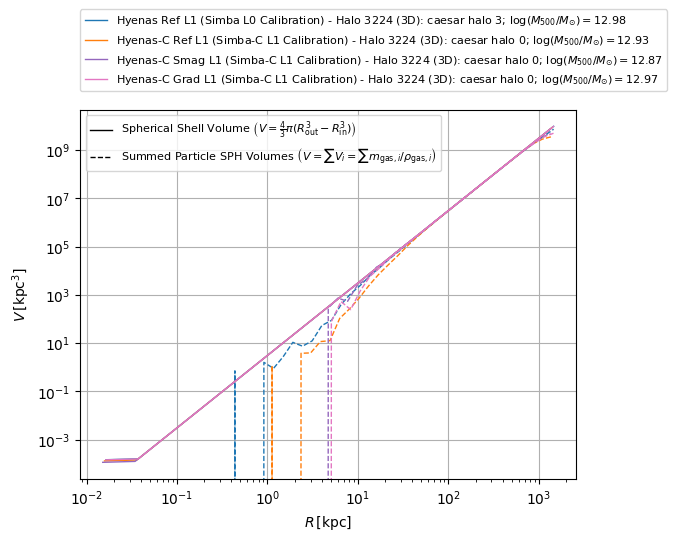

In [61]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['volume']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['volume_sph']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$V\,[\mathrm{kpc^3}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',)],
              labels=[r'Spherical Shell Volume $\left(V=\frac{4}{3}\pi(R_{\mathrm{out}}^3-R_{\mathrm{in}}^3)\right)$',
                      r'Summed Particle SPH Volumes $\left(V=\sum V_i=\sum m_{\mathrm{gas},i}/\rho_{\mathrm{gas},i}\right)$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

## Number of particles

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


IndexError: list index out of range

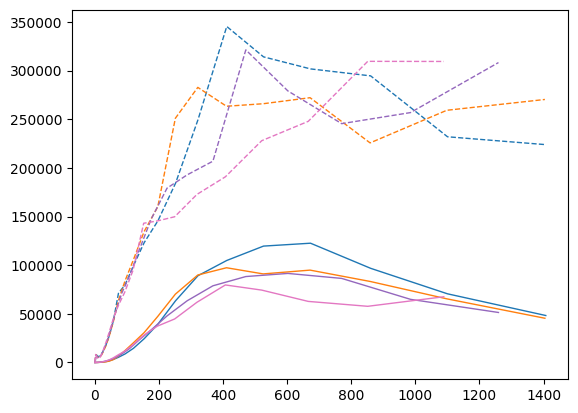

In [158]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['n']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['n']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        plt.axvline(x=r500, color=color, alpha=0.75, lw=1, ls=':', zorder=zorder_list[j])
        
        
        i += 1


plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$N_{\mathrm{part}}$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


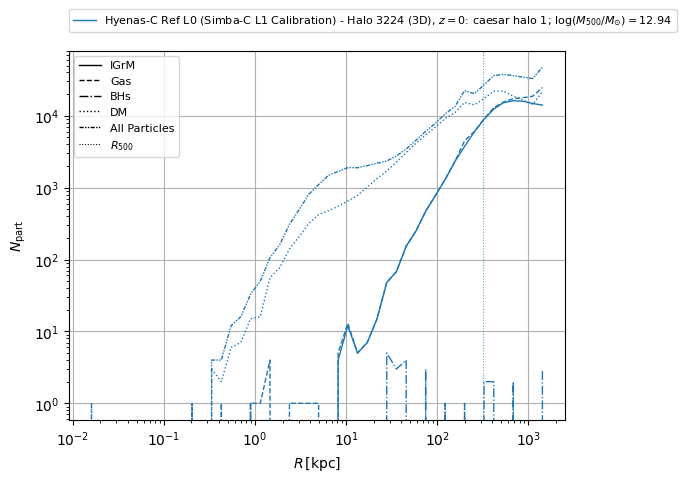

In [8]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['n']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['n']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['y']['n']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['n']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',)


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['n']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$N_{\mathrm{part}}(R)$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['IGrM', 'Gas', 'BHs', 'DM', 'All Particles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


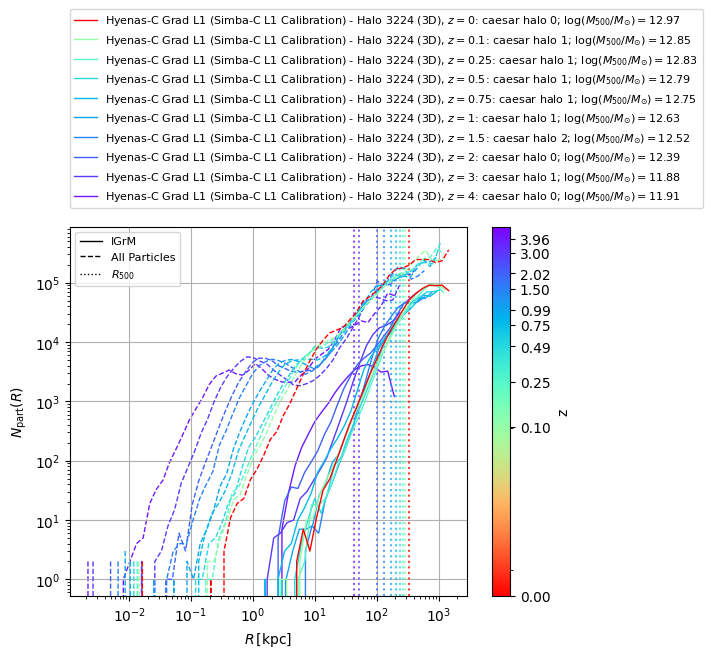

In [447]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['n']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['n']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$N_{\mathrm{part}}(R)$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['IGrM', 'All Particles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


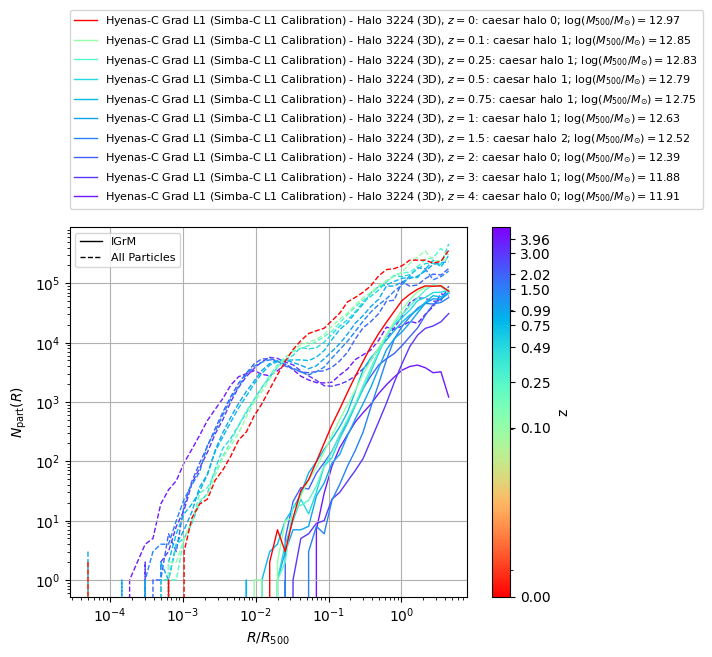

In [448]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['n']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['rbin_r500_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['n']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$N_{\mathrm{part}}(R)$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),],
                           # Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['IGrM', 'All Particles',],# r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

## Mass

Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol


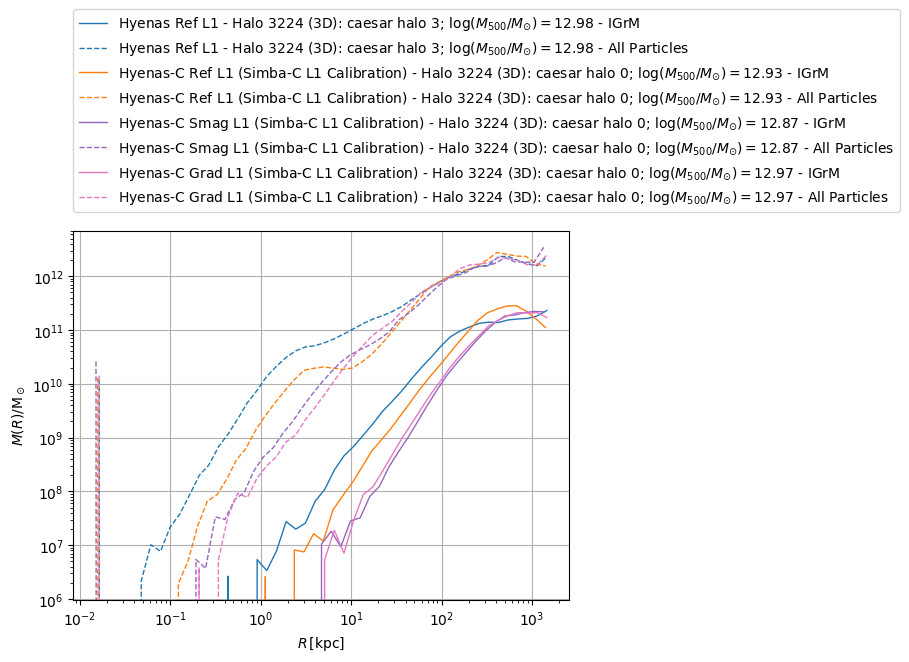

In [260]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$M(R)/\mathrm{M_\odot}$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol


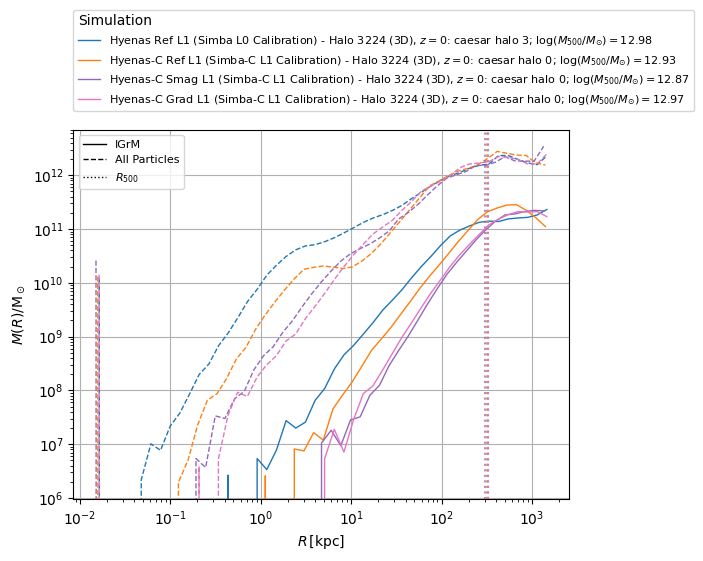

In [505]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, ls=':')
        
        i += 1

ax = plt.gca()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$M(R)/\mathrm{M_\odot}$')
ax.legend(fontsize=8, loc=(0, 1.05), title=r'Simulation', alignment='left')
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['IGrM', 'All Particles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

Msol
Msol
Msol
Msol
Msol


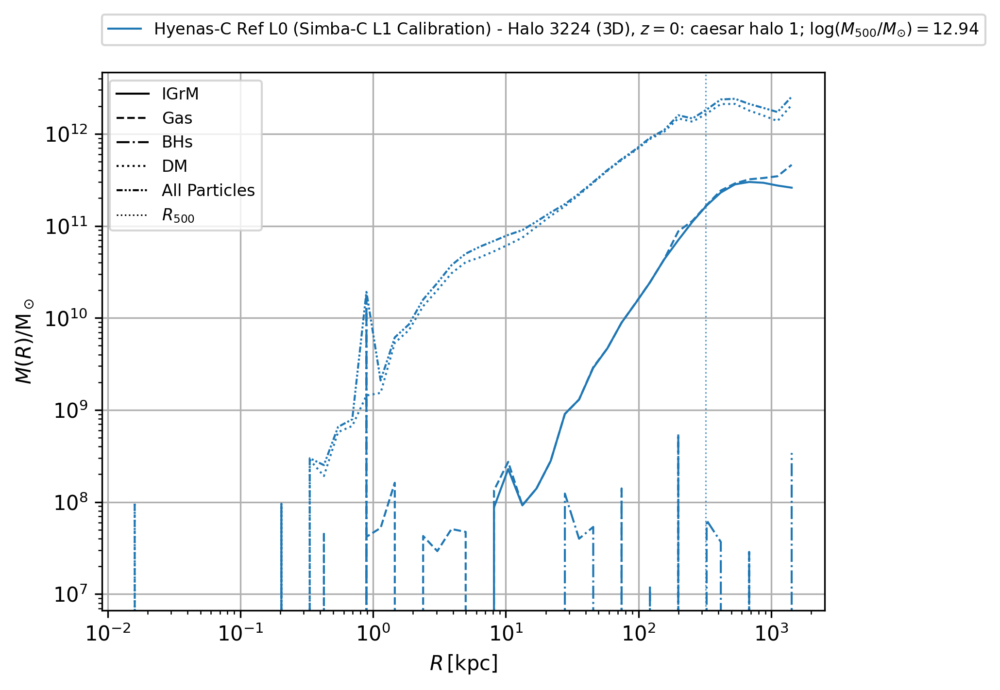

In [15]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'Msol'
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$M(R)/\mathrm{M_\odot}$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['IGrM', 'Gas', 'BHs', 'DM', 'All Particles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol


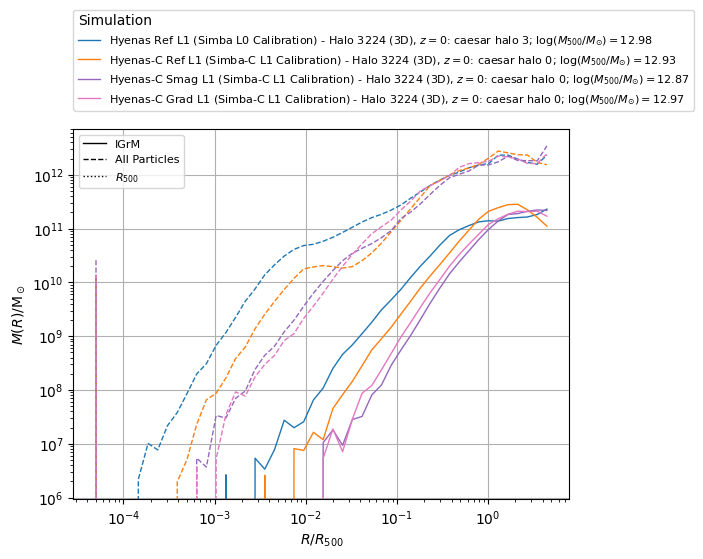

In [507]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['rbin_r500_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        
        # plt.axvline(x=r500, color=color_list[i], alpha=0.75, ls=':')
        
        i += 1

ax = plt.gca()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$M(R)/\mathrm{M_\odot}$')
ax.legend(fontsize=8, loc=(0, 1.05), title=r'Simulation', alignment='left')
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['IGrM', 'All Particles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol


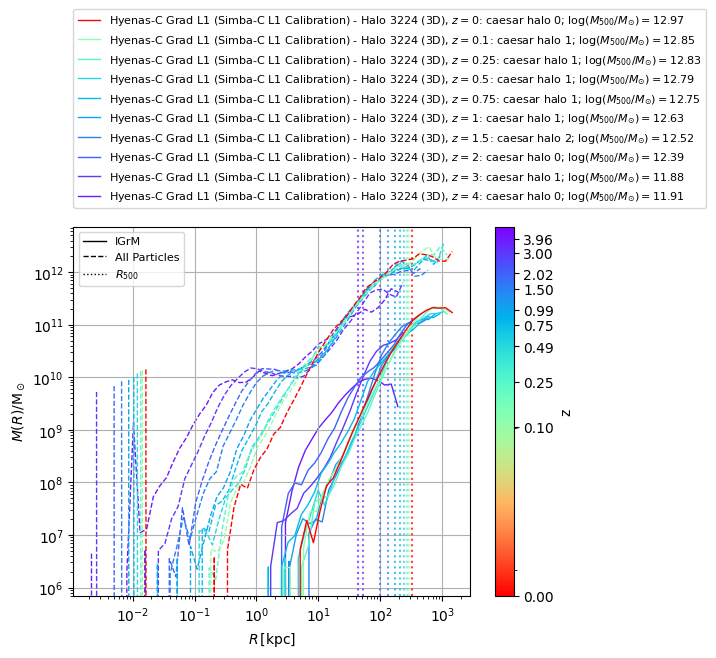

In [449]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'Msol'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$M(R)/\mathrm{M_\odot}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['IGrM', 'All Particles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol


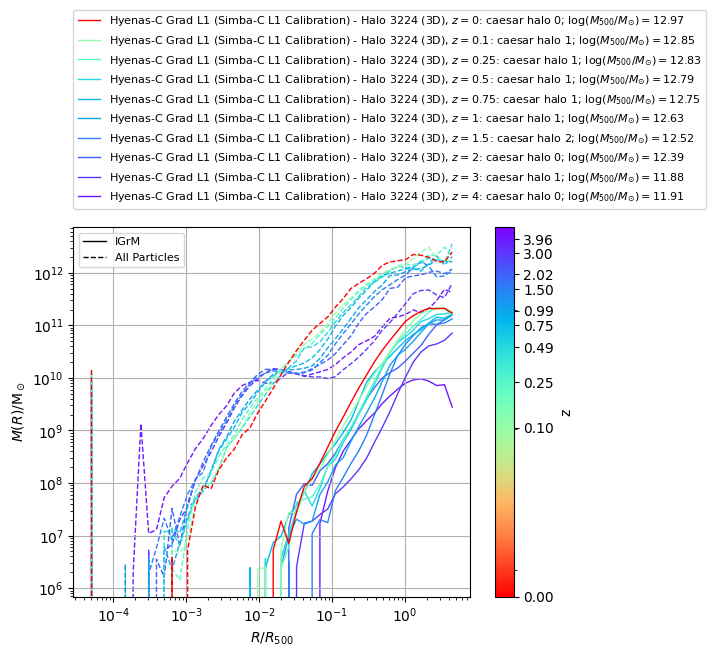

In [450]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'Msol'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['rbin_r500_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$M(R)/\mathrm{M_\odot}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),],
                           # Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['IGrM', 'All Particles',],# r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol


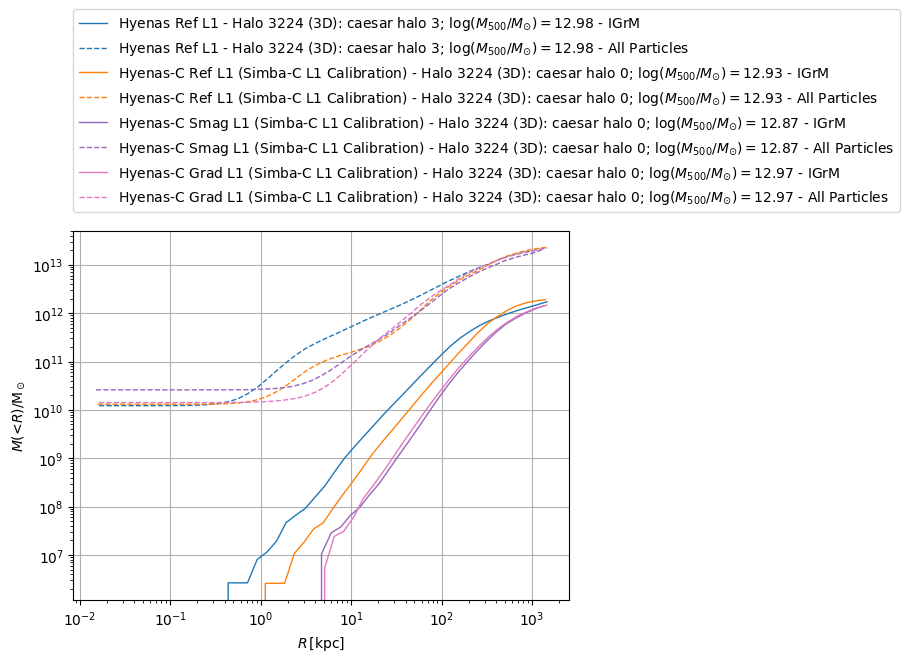

In [261]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$M($<$R)/\mathrm{M_\odot}$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol


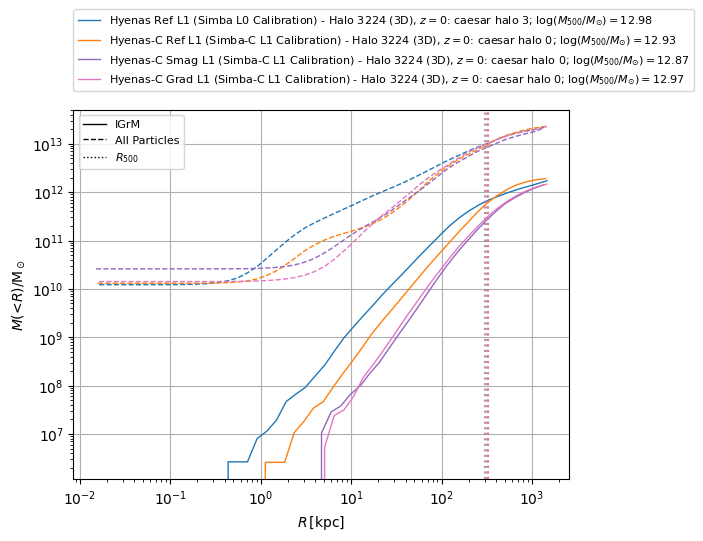

In [506]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, ls=':')
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$M($<$R)/\mathrm{M_\odot}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['IGrM', 'All Particles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol


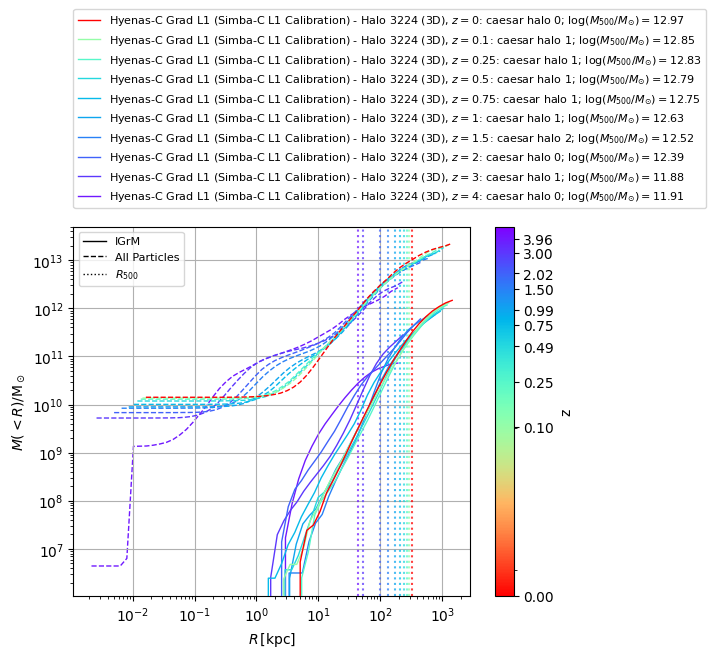

In [451]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'Msol'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$M(<R)/\mathrm{M_\odot}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['IGrM', 'All Particles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol
Msol


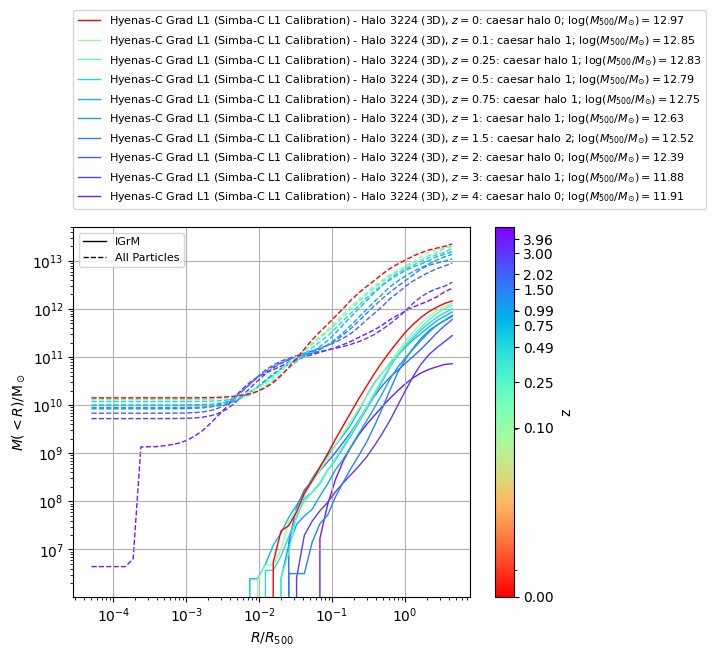

In [452]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'Msol'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['rbin_r500_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$M(<R)/\mathrm{M_\odot}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),],
                           # Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['IGrM', 'All Particles',],# r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

## Mass density

Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3


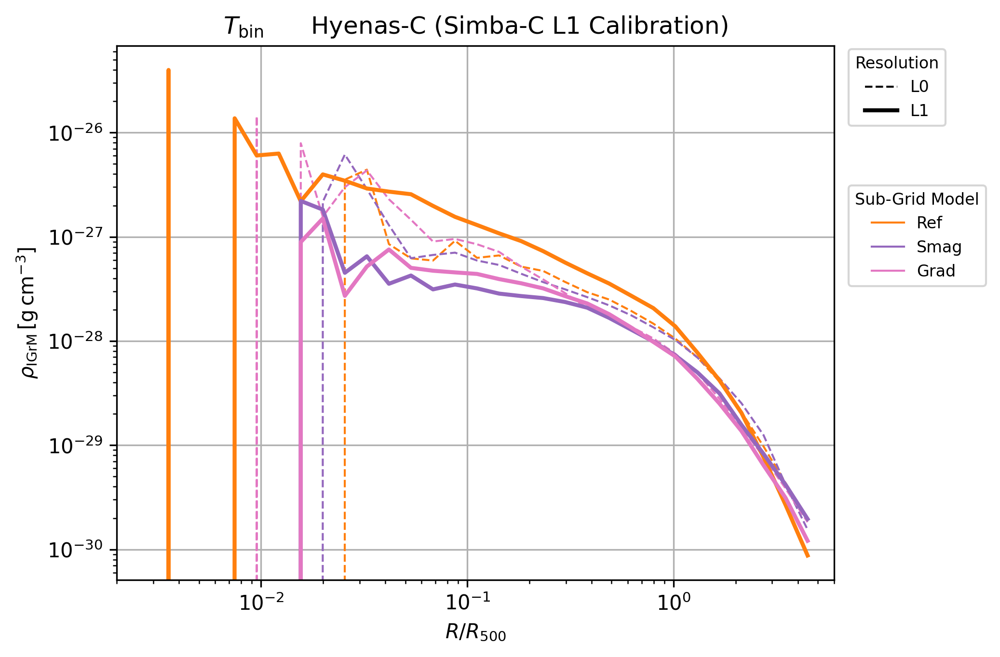

In [15]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = [#'C0',  # Hyenas Ref L0
              # 'C1',  # Hyenas-C Ref L0 (L0 Cali)
              # 'C4', 'C4', 'C4', 'C4',  # Hyenas-C Smag (all, u, v, z) L0 (L0 Cali)
              # 'C6', 'C6', 'C6',  # Hyenas-C Grad (all, v, z) L0 (L0 Cali)
              'C1', 'C4', 'C6',  # Hyenas-C Ref, Smag, Grad L0 (L1 Cali)
              # 'C0',  # Hyenas Ref L1
              'C1',  # Hyenas-C Ref L1 (L1 Cali)
              'C4',  # Hyenas-C Smag L1 (L1 Cali)
              'C6',  # Hyenas-C Grad L1 (L1 Cali)
             ]

lw_list = [#1,
           # 1,
           # 1, 1, 1, 1,
           # 1, 1, 1,
           1, 1, 1,
           # 2,
           2,
           2,
           2,
          ]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = [#'-',
           # '-',
           # '-', '--', '-.', ':',
           # '-', '-.', ':',
           # '-', '-', '-',
            '--', '--', '--',
           # '-',
           '-',
           '-',
           '-',
          ]

alpha_list = [#1,
              # 0.5,
              # 0.5, 0.5, 0.5, 0.5,
              # 0.5, 0.5, 0.5,
              1, 1, 1,
              # 1,
              1,
              1,
              1,
             ]
# alpha_list = [1,
#               1,
#               # 1,1,1,1,
#               # 1,1,1,
#               1,# 1, 1,
#               1,
#               1,
#               # 1,
#               # 1,
#              ]

i = 0

units = 'g cm**-3'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_density']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=ls_list[i], alpha=alpha_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(2e-3, 6e0)
# plt.ylim(3e-2, 1e1)

plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$\rho_{\mathrm{IGrM}}\,[\mathrm{g\,cm^{-3}}]$')

title = r'$T_{\mathrm{bin}}$'
# title += '\tL0 (Simba-C L0 Calibration)'
# title += '\t(Simba-C L1 Calibration)'
title += '\tHyenas-C (Simba-C L1 Calibration)'
plt.title(title)

ax = plt.gca()
fig = plt.gcf()



# plot_obs_entropy_baseline('voit2005', ax=ax, xscale='r500', yscale='k500', n_points=2,
#                           plot_kwargs={'color':'black', 'ls':'--',
#                                        'label':r'$K/K_{200}=1.32(R/R_{200})^{1.1}$ (Voit+2005)'})
# plot_obs_entropy_baseline('mccarthy2008', ax=ax, xscale='r500', yscale='k500', n_points=2,
#                           plot_kwargs={'color':'black', 'ls':'-.',
#                                        'label':r'$K/K_{200}=1.47(R/R_{200})^{1.22}$ (McCarthy+2008)'})

# print()
# sim0 = list(sim_dict.keys())[0]
# print(sim0)
# halo0 = list(sim_dict[sim0]['profile']['halo_info'].keys())[0]
# print(halo0)
# xscale_value = sim_dict[sim0]['profile']['halo_info'][halo0]['R']['500']
# print(xscale_value, xscale_value.units)
# yscale_value = sim_dict[sim0]['profile']['halo_info'][halo0]['K']['500ideal']
# print(yscale_value, yscale_value.units)
# print()
# plot_obs_entropy('panagoulia2014', ax=ax,
#                  xscale='r500', xunits='1', xscale_value=xscale_value,
#                  yscale='k500', yunits='1', yscale_value=yscale_value,
#                  n_points=2,
#                  plot_kwargs={'color':'black', 'ls':':',
#                               'label':r'$K(R)=95.4\,\mathrm{keV\,cm^2}\times(R/100\,\mathrm{kpc})^{0.7}$ (Panagoulia+2014)'})

# ax.legend(fontsize=8, loc=(0, 1.1))


leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=2,ls='-',color='black',),],
              labels=['L0', 'L1'],
              title='Resolution', title_fontsize=8,
              fontsize=8, loc=(1.02,0.85))
ax.add_artist(leg2)

# leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C0',),
#                            Line2D([],[],lw=1,ls='-',color='C1',),
#                            Line2D([],[],lw=1,ls='-',color='C4',),
#                            Line2D([],[],lw=1,ls='-',color='C6',),],
#               labels=['Hyenas Ref', 'Hyenas-C Ref', 'Hyenas-C Smag', 'Hyenas-C Grad'],
#               title='Sub-Grid Model', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.55))
# ax.add_artist(leg3)
leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C1',),
                           Line2D([],[],lw=1,ls='-',color='C4',),
                           Line2D([],[],lw=1,ls='-',color='C6',),],
              labels=['Ref', 'Smag', 'Grad'],
              title='Sub-Grid Model', title_fontsize=8,
              fontsize=8, loc=(1.02,0.55))
ax.add_artist(leg3)

# leg4 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',),
#                            Line2D([],[],lw=1,ls='-.',color='black',),
#                            Line2D([],[],lw=1,ls=':',color='black',),],
#               labels=['Full Model', 'Energy Only', 'Momentum Only', 'Metals Only'],
#               title='Turbulent Diffusion', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.25))
# ax.add_artist(leg4)

# leg5 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',alpha=0.5,color='black',),
#                            Line2D([],[],lw=1,ls='-',alpha=1,color='black',),],
#               labels=['L0 Calibration', 'L1 Calibration'],
#               title='Hyenas-C Parameters', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.05))
# ax.add_artist(leg5)


fig.set_dpi(300)
plt.show()

Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3


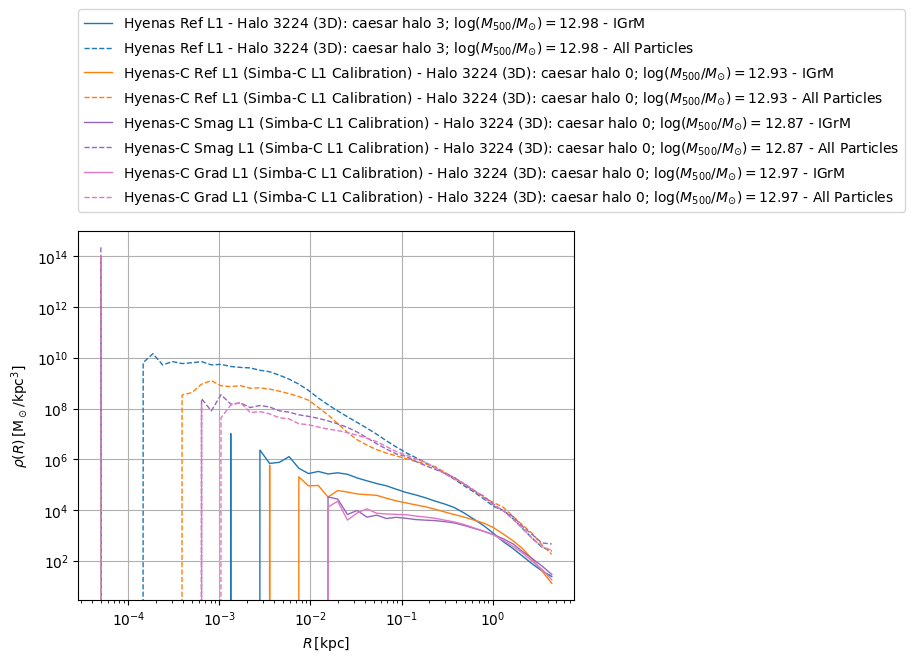

In [262]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_density']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['rbin_r500_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass_density']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\rho(R)\,[\mathrm{M_\odot/kpc^3}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3


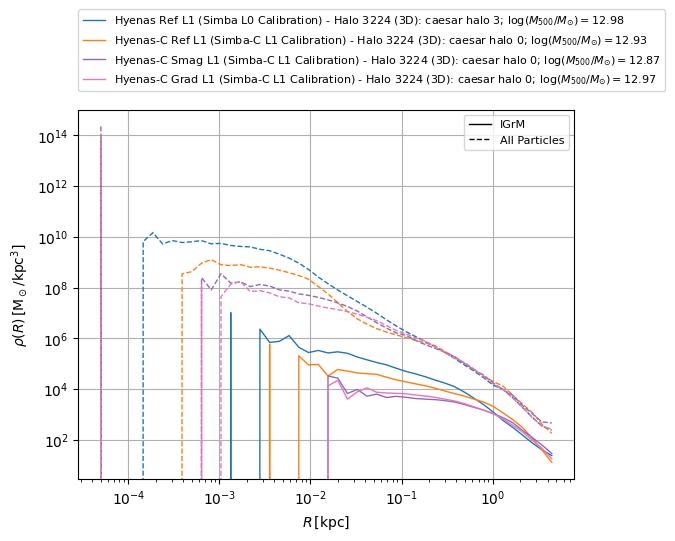

In [38]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_density']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['rbin_r500_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass_density']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\rho(R)\,[\mathrm{M_\odot/kpc^3}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',)],
              labels=['IGrM', 'All Particles'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3


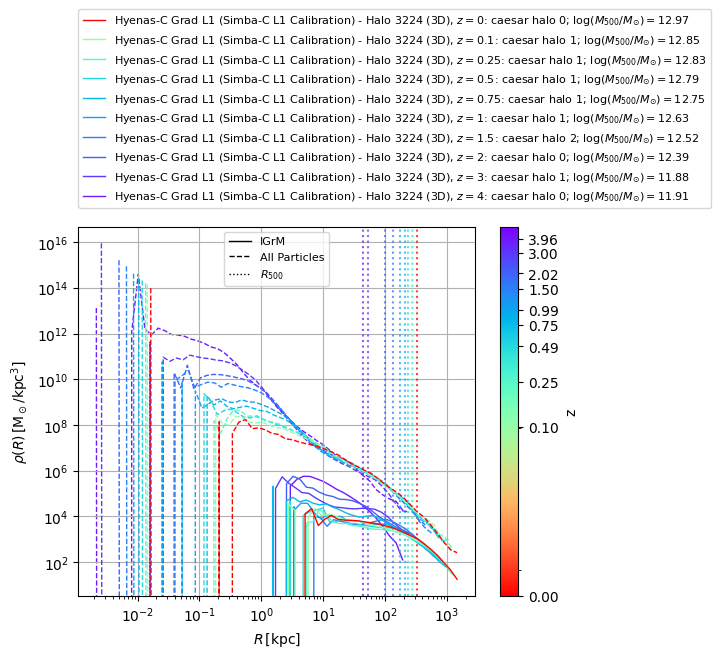

In [453]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'Msol kpc**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_density']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass_density']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\rho(R)\,[\mathrm{M_\odot/kpc^3}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['IGrM', 'All Particles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3


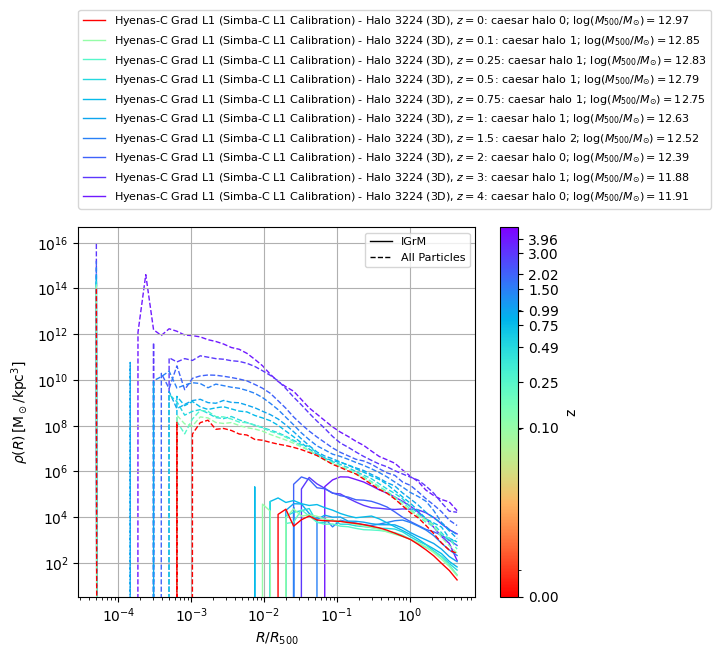

In [454]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'Msol kpc**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_density']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['rbin_r500_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass_density']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$\rho(R)\,[\mathrm{M_\odot/kpc^3}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),],
                           # Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['IGrM', 'All Particles',],# r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3


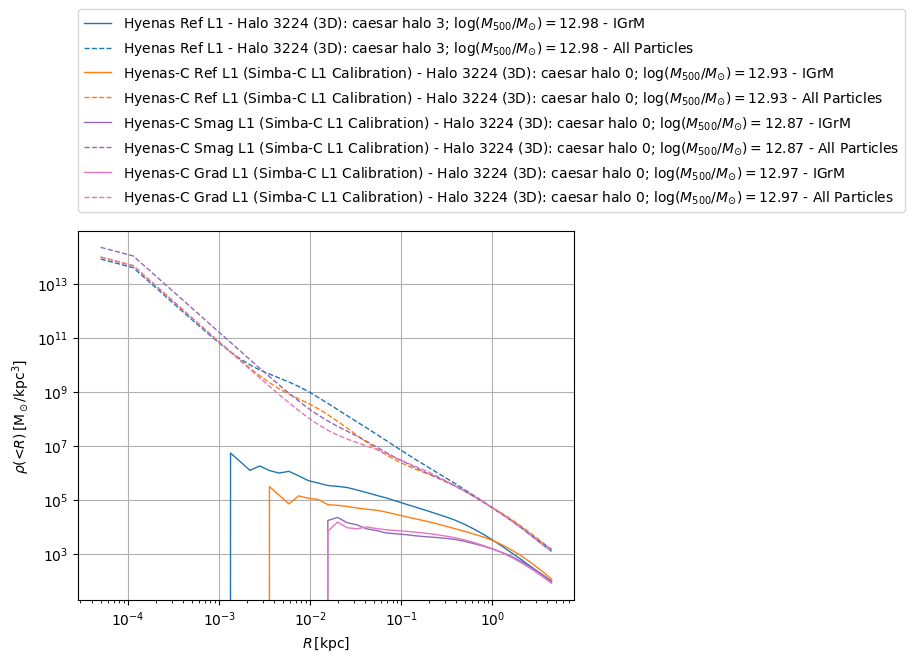

In [263]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_density_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['rbin_r500_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass_density_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\rho($<$R)\,[\mathrm{M_\odot/kpc^3}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3


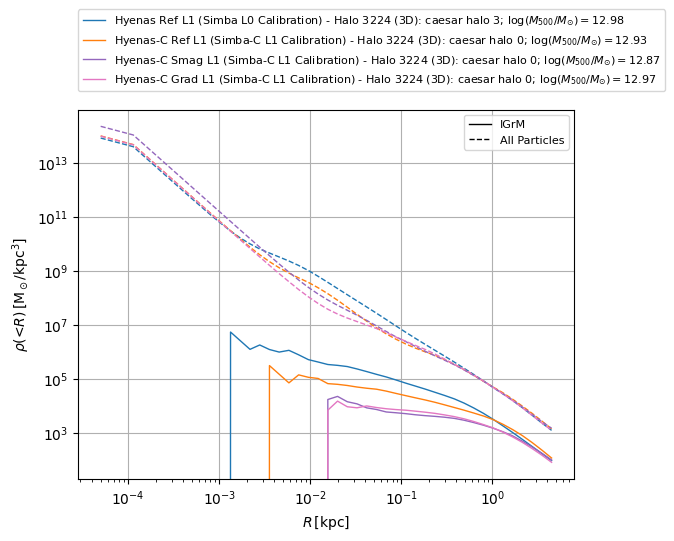

In [39]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_density_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['rbin_r500_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass_density_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\rho($<$R)\,[\mathrm{M_\odot/kpc^3}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',)],
              labels=['IGrM', 'All Particles'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3


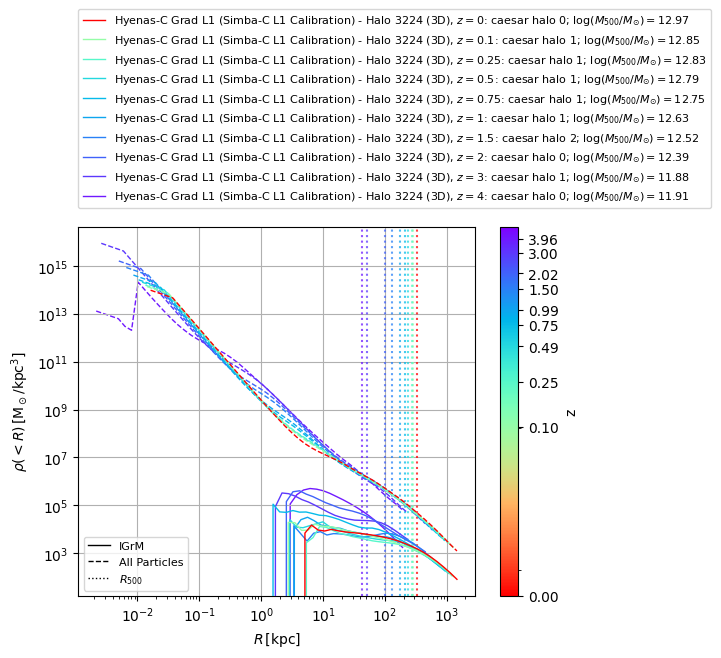

In [455]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'Msol kpc**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_density_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass_density_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\rho(<R)\,[\mathrm{M_\odot/kpc^3}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['IGrM', 'All Particles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3
Msol kpc**-3


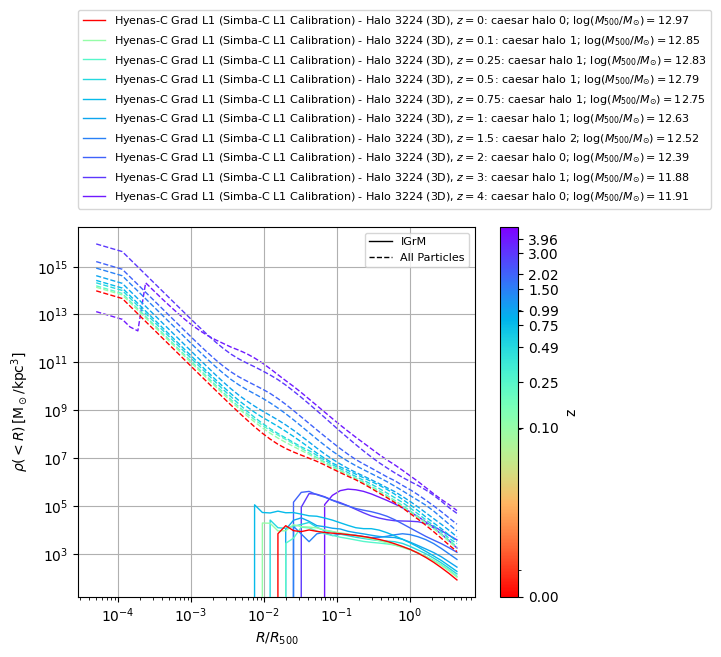

In [456]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'Msol kpc**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_density_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['rbin_r500_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass_density_enc']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - All Particles')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$\rho(<R)\,[\mathrm{M_\odot/kpc^3}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),],
                           # Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['IGrM', 'All Particles',],# r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

## Gravitational Potential

km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2


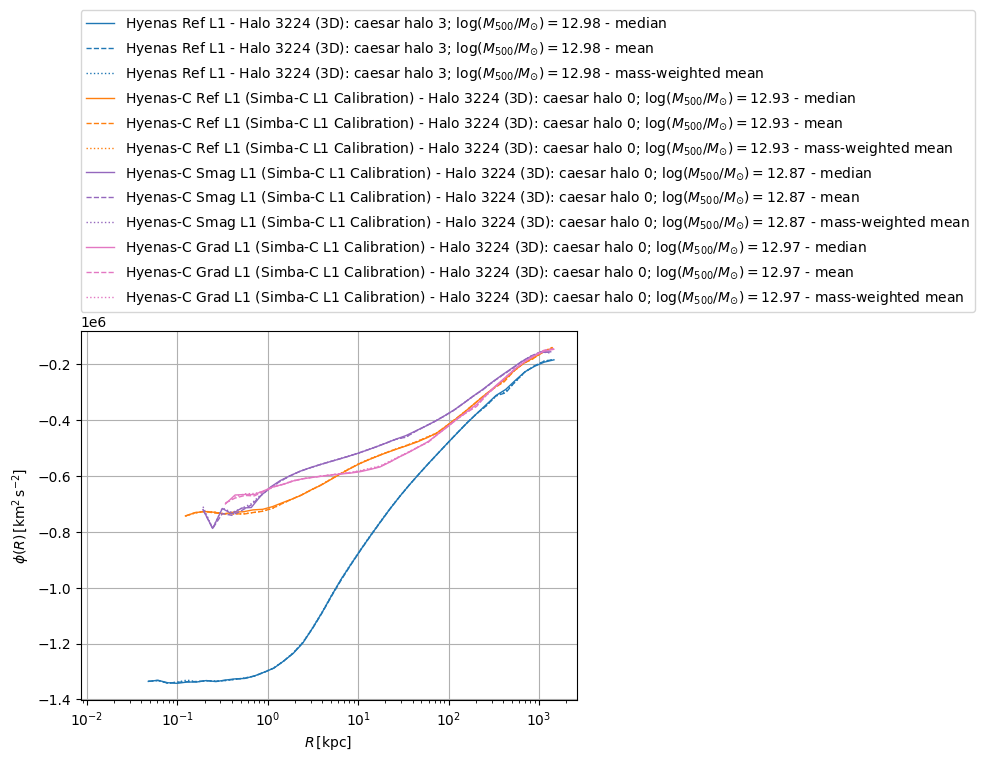

In [266]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'erg g**-1'

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['phi-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['phi-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - median')

        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['phi-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - mean')

        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['phi-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - mass-weighted mean')
        
        
        i += 1

plt.grid()
plt.xscale('log')
# plt.yscale('symlog')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\phi(R)\,[\mathrm{km^2\,s^{-2}}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2


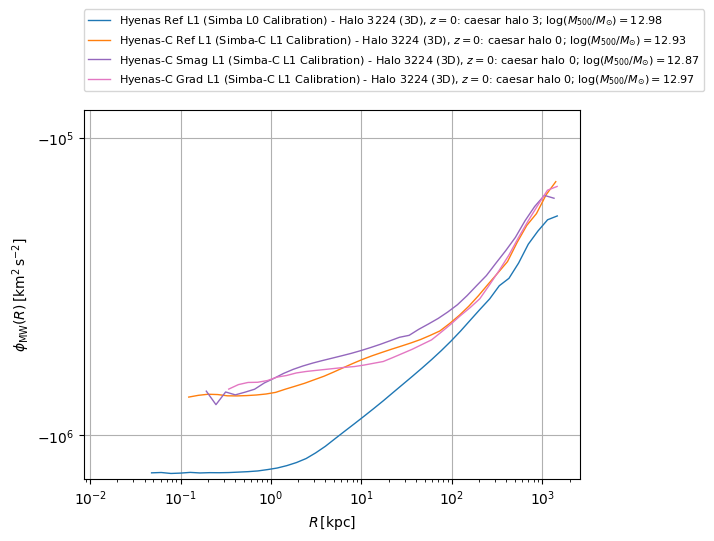

In [509]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km**2 s**-2' #'erg g**-1'

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['phi-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['phi-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,#.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - median')

        # y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['phi-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,#.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - mean')

        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['phi-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('symlog')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\phi_{\mathrm{MW}}(R)\,[\mathrm{km^2\,s^{-2}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',)],
#               labels=['IGrM', 'All Particles'],
#               fontsize=8)
# ax.add_artist(leg2)
plt.show()

keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1


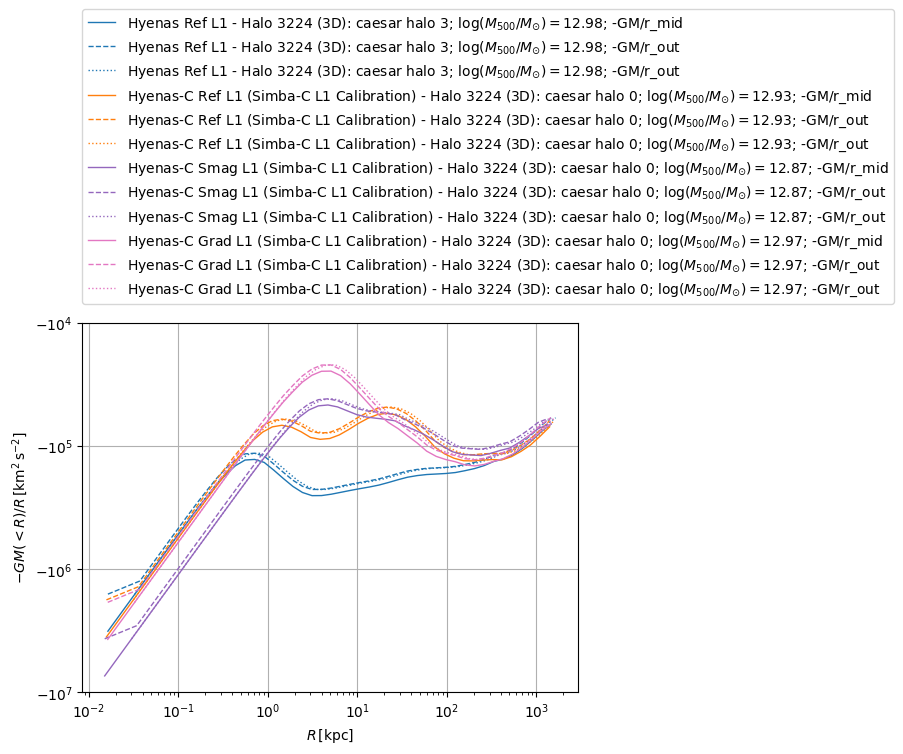

In [269]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km**2 s**-2'

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['phi-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GM/r_mid']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; -GM/r_mid')

        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GM/r_out']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; -GM/r_out')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbins'][1:]
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GM/r_out']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; -GM/r_out')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('symlog')
plt.ylim(-1e7, -1e4)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$-GM(<R)/R\,[\mathrm{km^2\,s^{-2}}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1


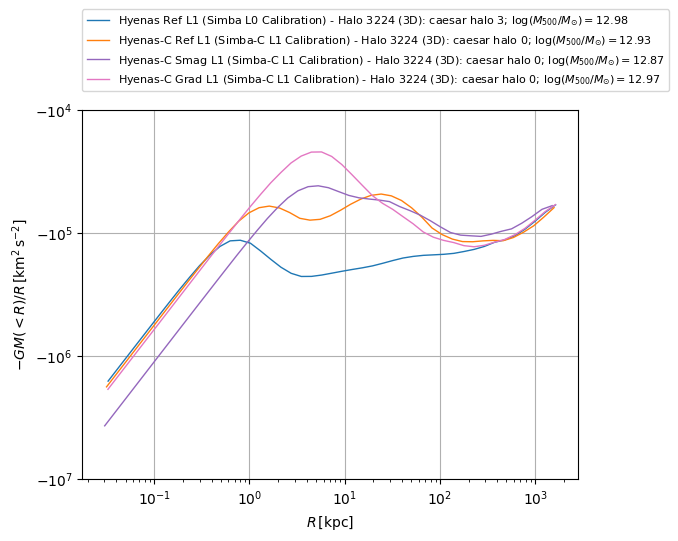

In [41]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km**2 s**-2'

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['phi-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GM/r_mid']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; -GM/r_mid')

        # y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GM/r_out']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; -GM/r_out')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbins'][1:]
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GM/r_out']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('symlog')
plt.ylim(-1e7, -1e4)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$-GM(<R)/R\,[\mathrm{km^2\,s^{-2}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',)],
#               labels=['IGrM', 'All Particles'],
#               fontsize=8)
# ax.add_artist(leg2)
plt.show()

keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1


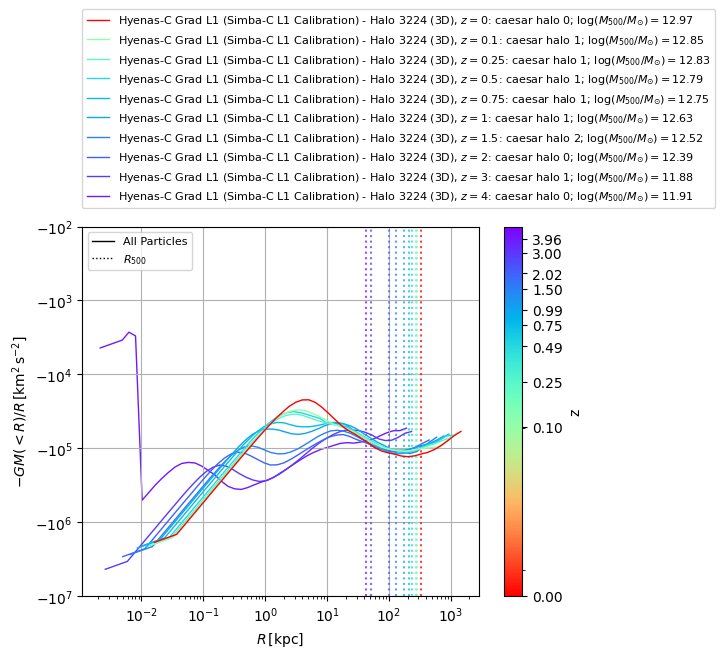

In [457]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'km**2 s**-2'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_density']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GM/r_out']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('symlog')
plt.ylim(-1e7, -1e2)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$-GM(<R)/R\,[\mathrm{km^2\,s^{-2}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['All Particles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1
keV Msol**-1


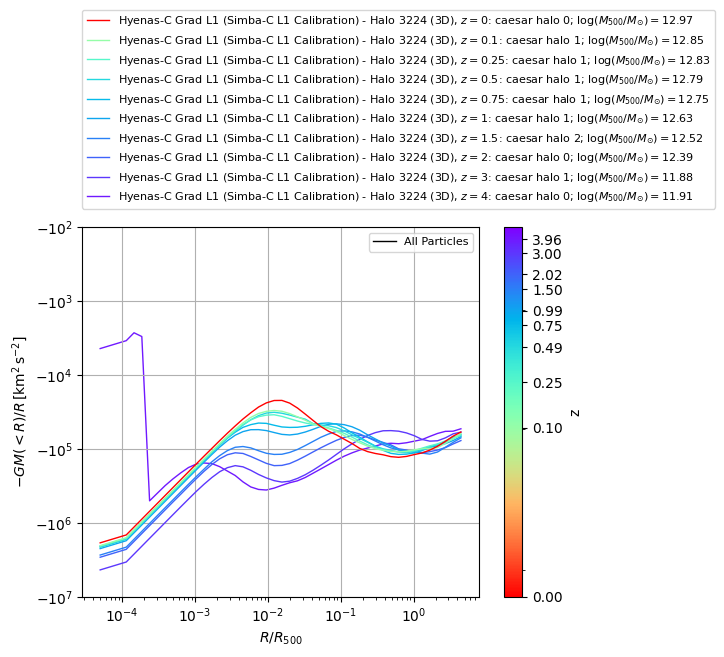

In [458]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'km**2 s**-2'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['mass_density']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['rbin_r500_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GM/r_out']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('symlog')
plt.ylim(-1e7, -1e2)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$-GM(<R)/R\,[\mathrm{km^2\,s^{-2}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls=':',color='black',)],
              labels=['All Particles',],# r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

keV Msol**-1 kpc**-1
keV Msol**-1 kpc**-1
keV Msol**-1 kpc**-1
keV kpc**-1 Msol**-1
keV kpc**-1 Msol**-1
keV kpc**-1 Msol**-1
keV kpc**-1 Msol**-1
keV kpc**-1 Msol**-1
keV kpc**-1 Msol**-1
keV kpc**-1 Msol**-1
keV kpc**-1 Msol**-1
keV kpc**-1 Msol**-1


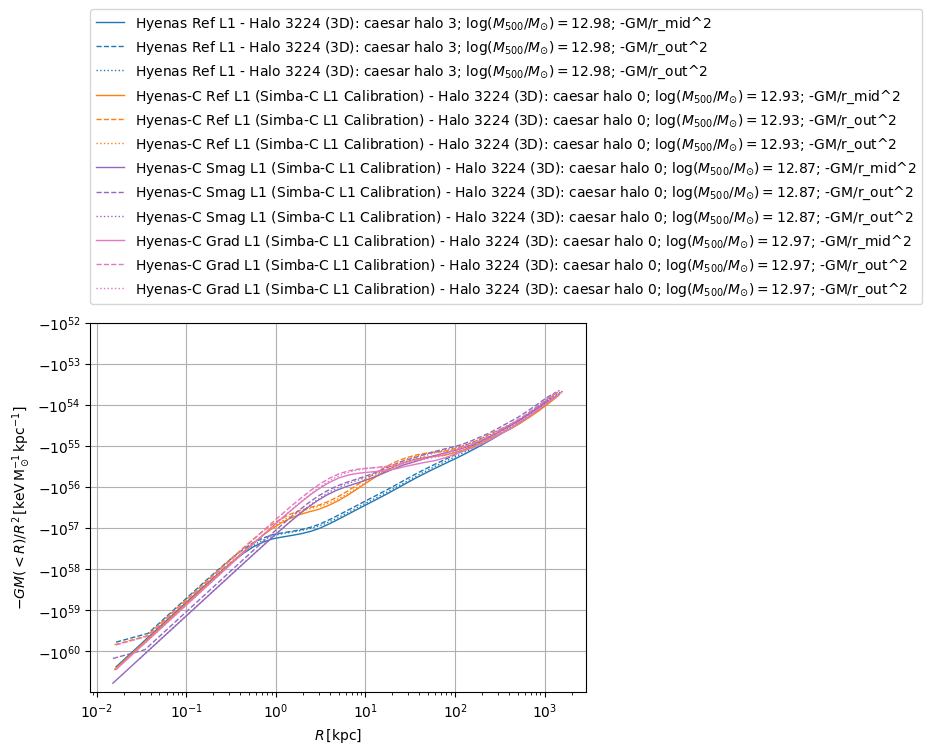

In [271]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-2'

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['phi-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GM/r_mid^2']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; -GM/r_mid^2')

        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GM/r_out^2']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; -GM/r_out^2')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbins'][1:]
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GM/r_out^2']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; -GM/r_out^2')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('symlog')
plt.ylim(-1e61, -1e52)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$-GM(<R)/R^2\,[\mathrm{keV\,M_\odot^{-1}\,kpc^{-1}}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

keV kpc**-4
keV kpc**-4
keV kpc**-4
keV kpc**-4
keV kpc**-4
keV kpc**-4
keV kpc**-4
keV kpc**-4
keV kpc**-4
keV kpc**-4
keV kpc**-4
keV kpc**-4


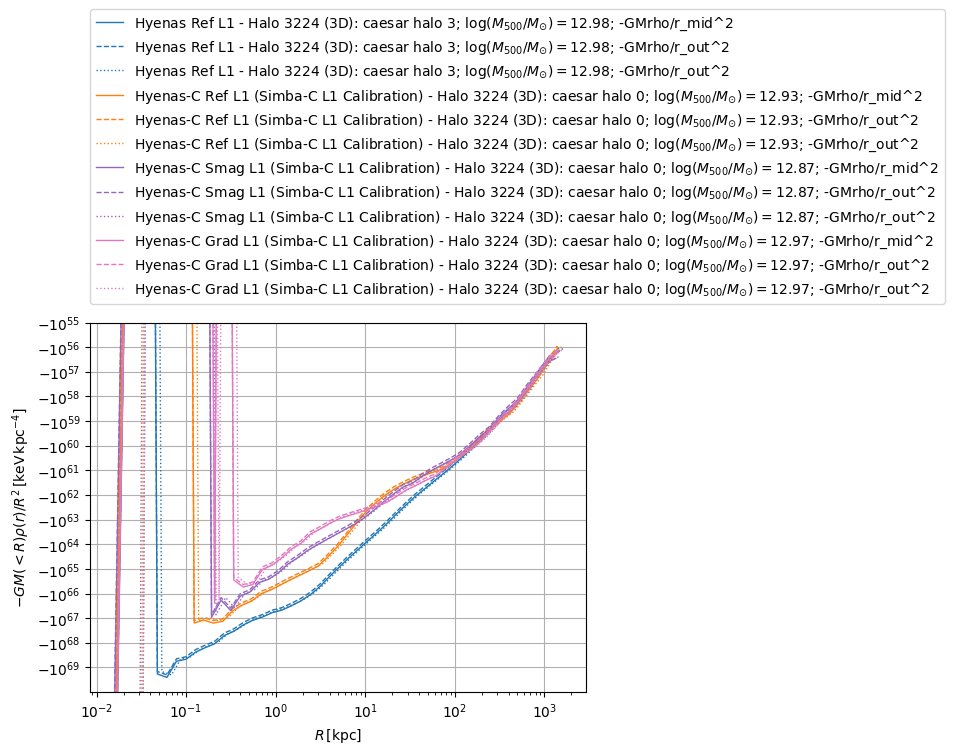

In [273]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-2'

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['phi-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_mid^2']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; -GMrho/r_mid^2')

        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_out^2']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; -GMrho/r_out^2')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbins'][1:]
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_out^2']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; -GMrho/r_out^2')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('symlog')
plt.ylim(-1e70, -1e55)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$-GM(<R)\rho(r)/R^2\,[\mathrm{keV\,kpc^{-4}}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

## Hydrostatic Equilibrium

keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4


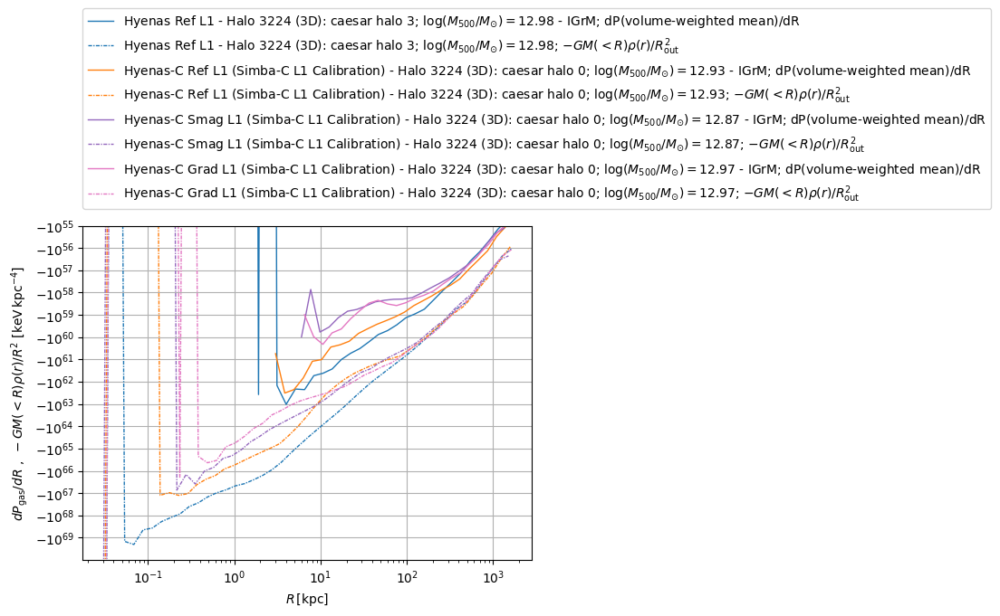

In [277]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'keV kpc**-4'

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(median)/dR')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(mass-weighted mean)/dR')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(volume-weighted mean)/dR')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-volume_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(volume-weighted mean; bin T)/dR')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-volume_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(volume-weighted mean; bin T, ne)/dR')


        
        # x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_mid^2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,#.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - -GMrho/r_mid^2')

        # y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_out^2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,#.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - -GMrho/r_out^2')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbins'][1:]
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_out^2']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$-GM(<R)\rho(r)/R_{\mathrm{out}}^2$')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('symlog')
plt.ylim(-1e70, -1e55)
# plt.ylim(-1e3, 1)
# plt.ylim(-0.1, 0.1)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$dP_{\mathrm{gas}}/dR \,\,,\,\, -GM(<R)\rho(r)/R^2\,\,[\mathrm{keV\,kpc^{-4}}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4


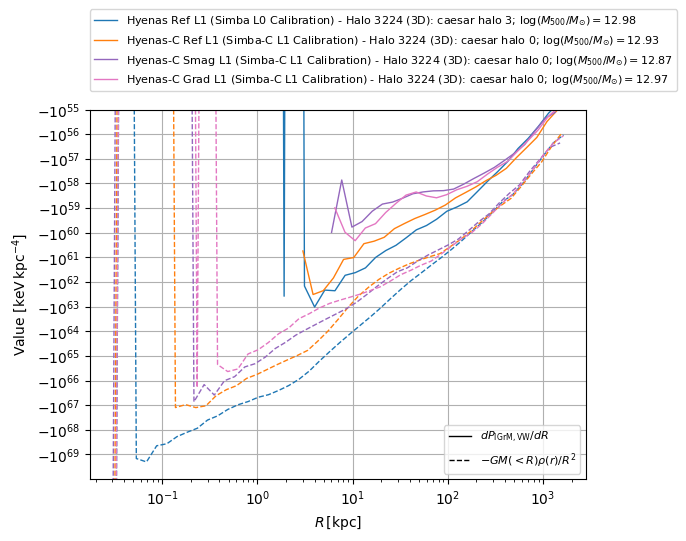

In [47]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'keV kpc**-4'

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(median)/dR')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(mass-weighted mean)/dR')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-volume_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(volume-weighted mean; bin T)/dR')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-volume_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(volume-weighted mean; bin T, ne)/dR')


        
        # x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_mid^2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,#.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - -GMrho/r_mid^2')

        # y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_out^2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,#.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - -GMrho/r_out^2')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbins'][1:]
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_out^2']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('symlog')
plt.ylim(-1e70, -1e55)
# plt.ylim(-1e3, 1)
# plt.ylim(-0.1, 0.1)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\mathrm{Value}\,\,[\mathrm{keV\,kpc^{-4}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',)],
              labels=[r'$dP_{\mathrm{IGrM,VW}}/dR$', r'$-GM(<R)\rho(r)/R^2$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4


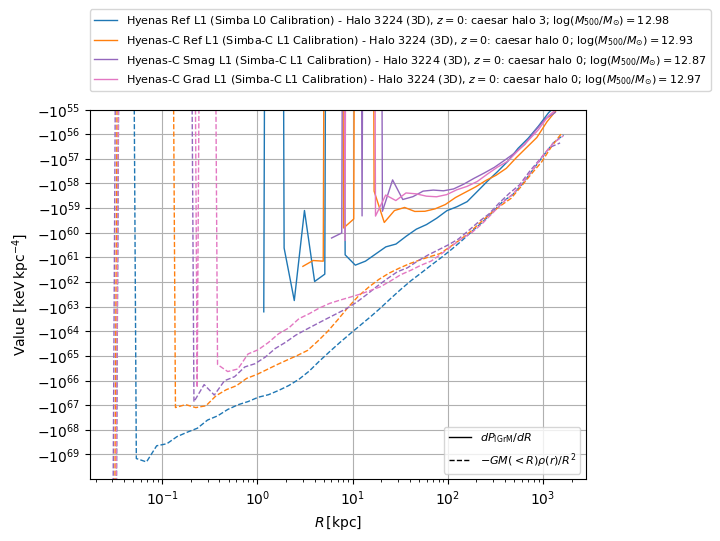

In [510]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'keV kpc**-4'

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(median)/dR')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(mass-weighted mean)/dR')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-mass_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-volume_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(volume-weighted mean; bin T)/dR')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-volume_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(volume-weighted mean; bin T, ne)/dR')


        
        # x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_mid^2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,#.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - -GMrho/r_mid^2')

        # y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_out^2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,#.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - -GMrho/r_out^2')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbins'][1:]
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_out^2']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('symlog')
plt.ylim(-1e70, -1e55)
# plt.ylim(-1e3, 1)
# plt.ylim(-0.1, 0.1)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\mathrm{Value}\,\,[\mathrm{keV\,kpc^{-4}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',)],
              labels=[r'$dP_{\mathrm{IGrM}}/dR$', r'$-GM(<R)\rho(r)/R^2$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

keV kpc**-1 cm**-3
km**2 Msol s**-2 kpc**-4
keV kpc**-1 cm**-3
km**2 Msol s**-2 kpc**-4
keV kpc**-1 cm**-3
km**2 Msol s**-2 kpc**-4
keV kpc**-1 cm**-3
km**2 Msol s**-2 kpc**-4


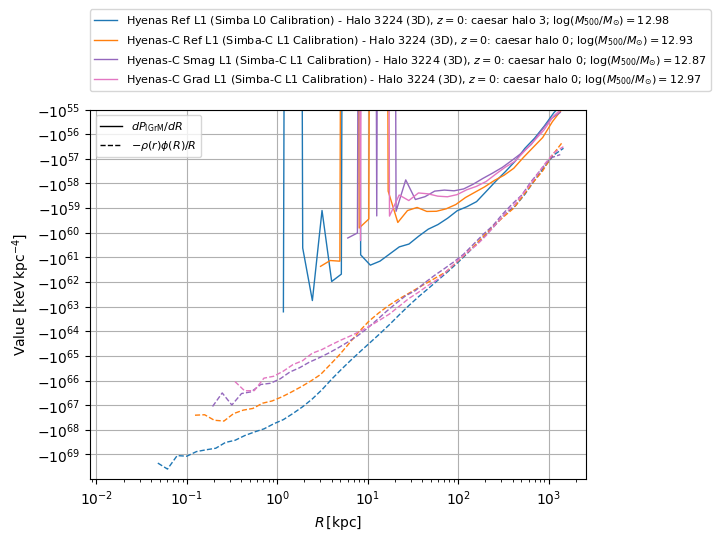

In [511]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'keV kpc**-4'

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(median)/dR')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(mass-weighted mean)/dR')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-mass_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-volume_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(volume-weighted mean; bin T)/dR')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-volume_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - IGrM; dP(volume-weighted mean; bin T, ne)/dR')


        
        # x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_mid^2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,#.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - -GMrho/r_mid^2')

        # y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_out^2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,#.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f} - -GMrho/r_out^2')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['phi-mass_weighted_mean']
        y_profile *= sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['mass_density']
        y_profile /= sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')
        
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('symlog')
plt.ylim(-1e70, -1e55)
# plt.ylim(-1e3, 1)
# plt.ylim(-0.1, 0.1)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\mathrm{Value}\,\,[\mathrm{keV\,kpc^{-4}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',)],
              labels=[r'$dP_{\mathrm{IGrM}}/dR$', r'$-\rho(r)\phi(R)/R$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4


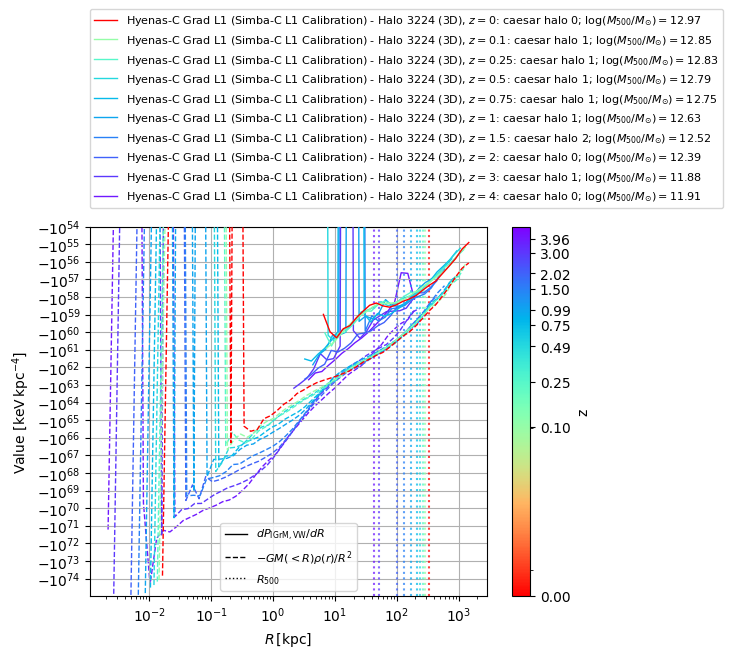

In [459]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV kpc**-4'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_out^2']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('symlog')
plt.ylim(-1e75, -1e54)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\mathrm{Value}\,\,[\mathrm{keV\,kpc^{-4}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'$dP_{\mathrm{IGrM,VW}}/dR$', r'$-GM(<R)\rho(r)/R^2$', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4
keV kpc**-1 cm**-3
keV kpc**-4


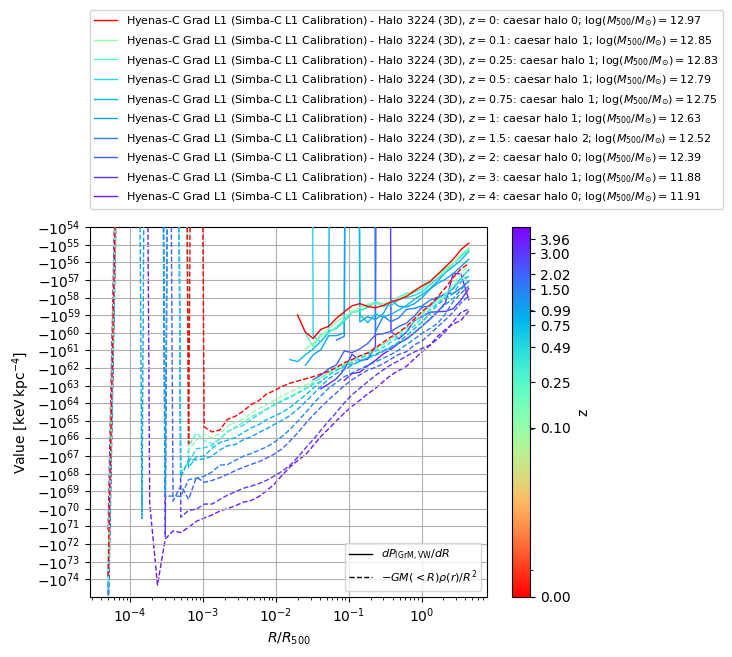

In [460]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV kpc**-4'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['d_P-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['rbin_r500_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['-GMrho/r_out^2']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('symlog')
plt.ylim(-1e75, -1e54)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$\mathrm{Value}\,\,[\mathrm{keV\,kpc^{-4}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),],
                           # Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'$dP_{\mathrm{IGrM,VW}}/dR$', r'$-GM(<R)\rho(r)/R^2$',],# r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

## Number of Wind Launches

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


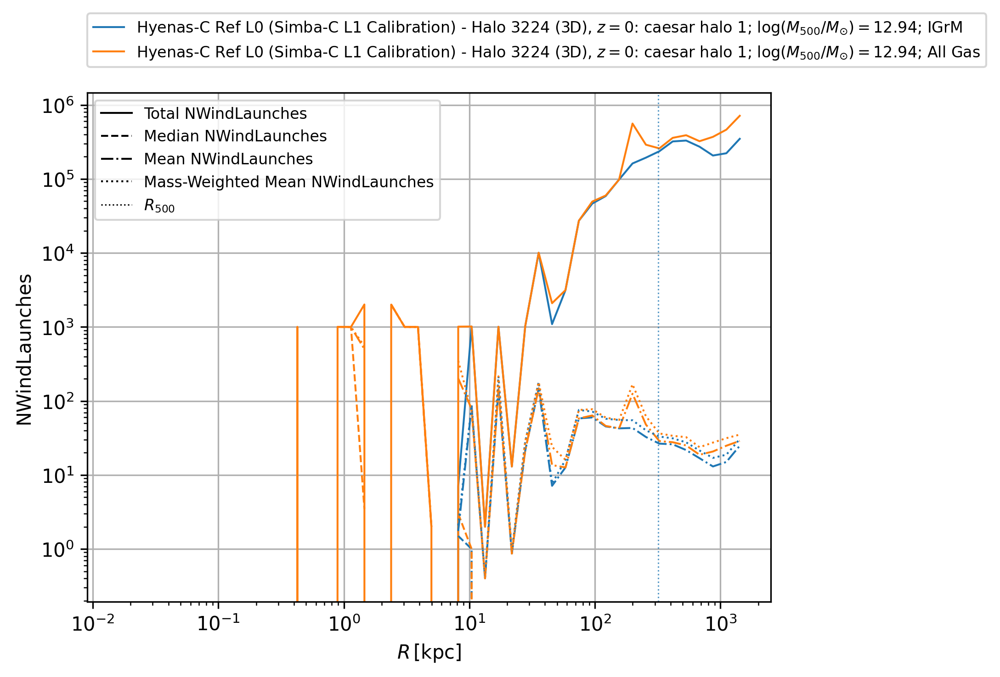

In [27]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('NWindLaunches')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total NWindLaunches', 'Median NWindLaunches', 'Mean NWindLaunches',
                      'Mass-Weighted Mean NWindLaunches', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


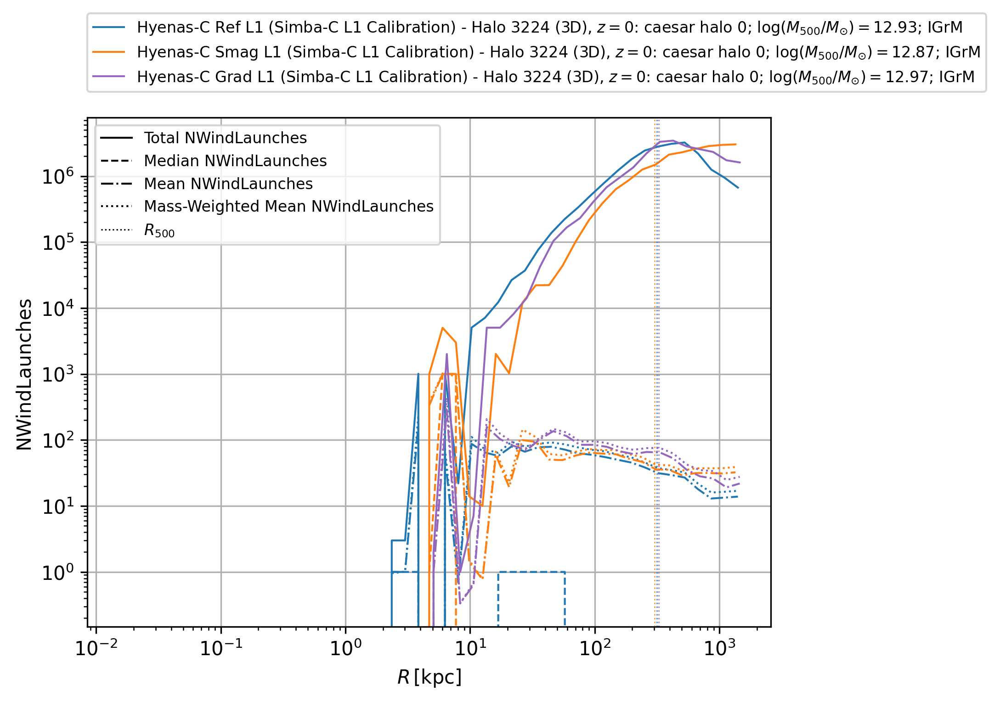

In [13]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('NWindLaunches')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total NWindLaunches', 'Median NWindLaunches', 'Mean NWindLaunches',
                      'Mass-Weighted Mean NWindLaunches', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


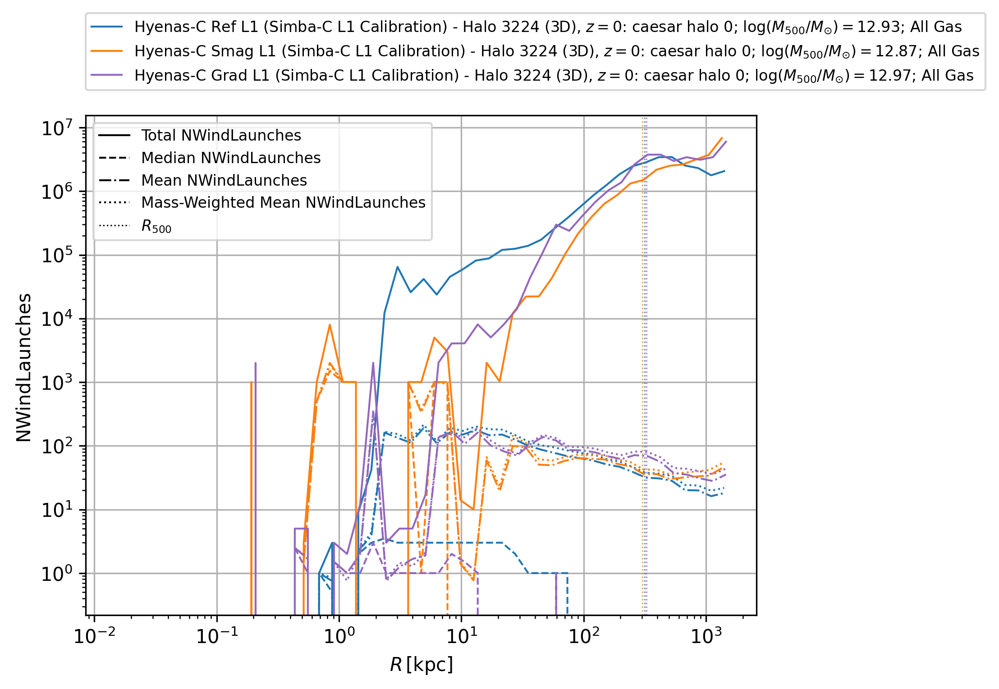

In [15]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('NWindLaunches')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total NWindLaunches', 'Median NWindLaunches', 'Mean NWindLaunches',
                      'Mass-Weighted Mean NWindLaunches', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()


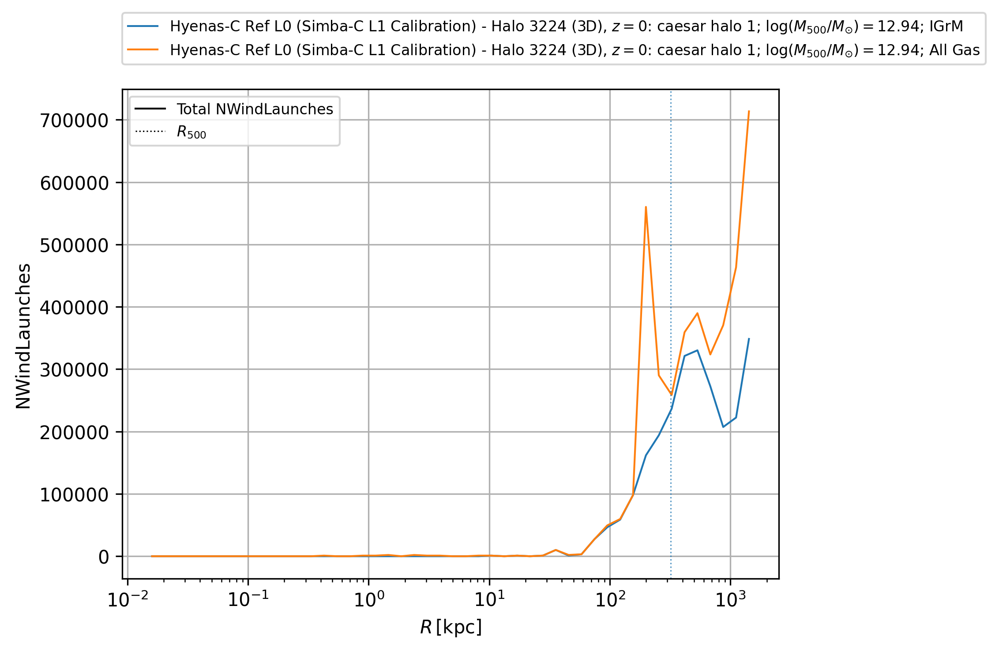

In [29]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('NWindLaunches')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total NWindLaunches',
                      # 'Median NWindLaunches', 'Mean NWindLaunches',
                      # 'Mass-Weighted Mean NWindLaunches', 
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()


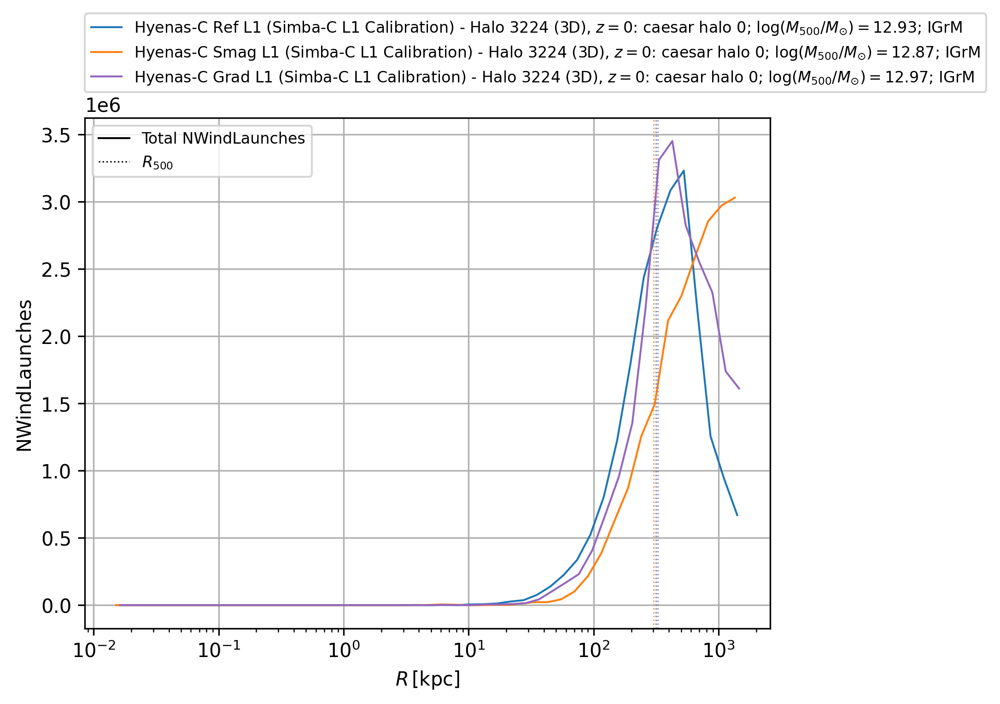

In [16]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('NWindLaunches')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total NWindLaunches',
                      # 'Median NWindLaunches', 'Mean NWindLaunches',
                      # 'Mass-Weighted Mean NWindLaunches', 
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()


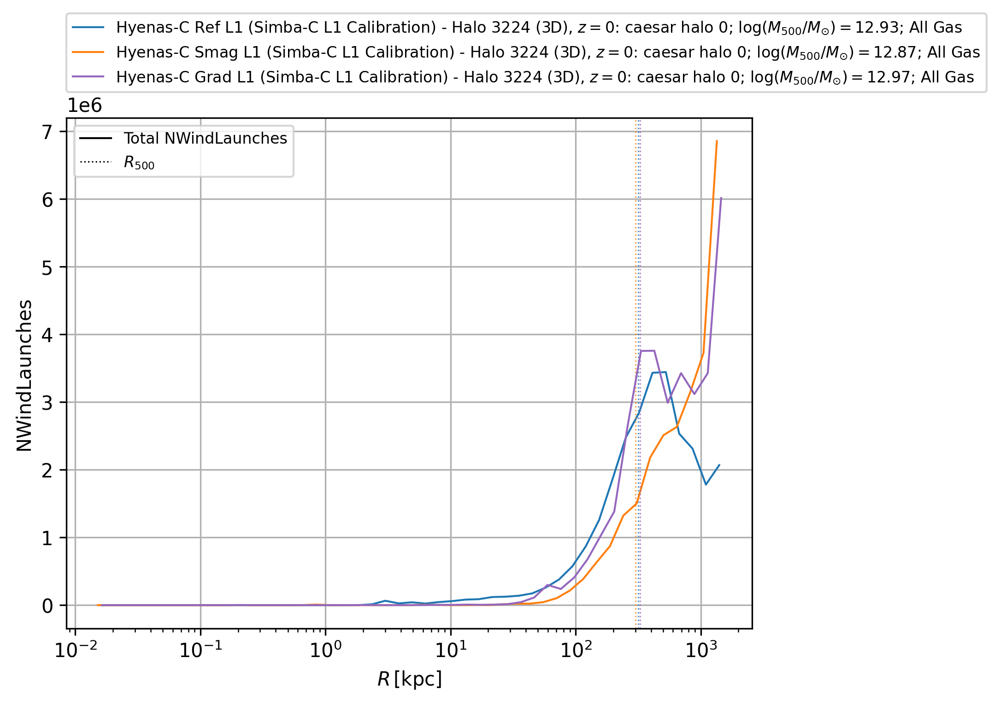

In [17]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('NWindLaunches')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total NWindLaunches',
                      # 'Median NWindLaunches', 'Mean NWindLaunches',
                      # 'Mass-Weighted Mean NWindLaunches', 
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


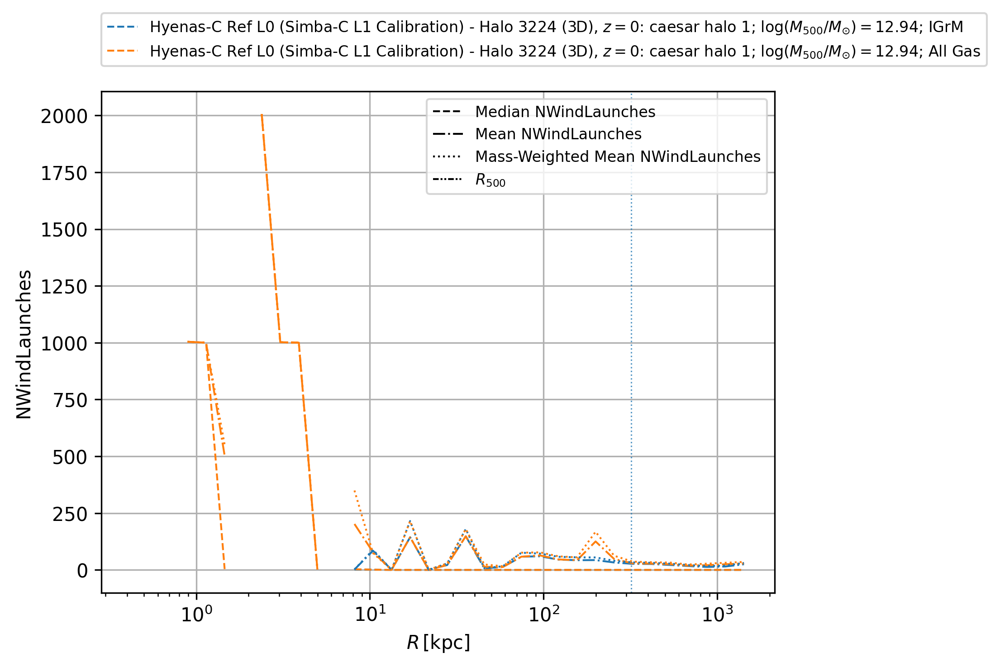

In [30]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('NWindLaunches')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[
    # Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=[
                  # 'Total NWindLaunches',
                      'Median NWindLaunches', 'Mean NWindLaunches',
                      'Mass-Weighted Mean NWindLaunches', 
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


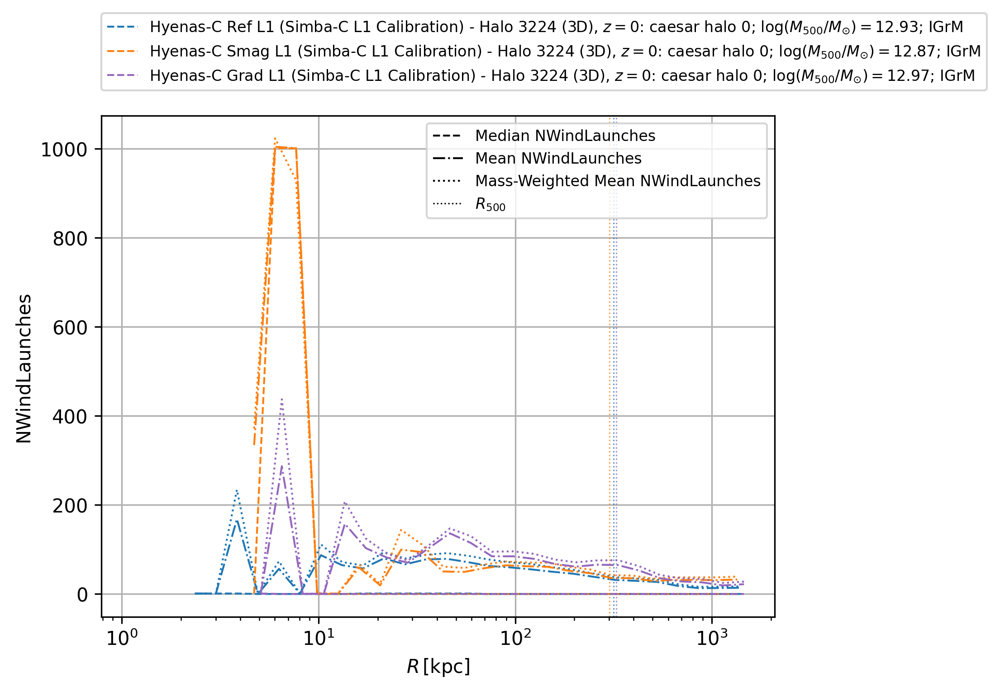

In [18]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('NWindLaunches')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[
    # Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=[
                  # 'Total NWindLaunches',
                      'Median NWindLaunches', 'Mean NWindLaunches',
                      'Mass-Weighted Mean NWindLaunches', 
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


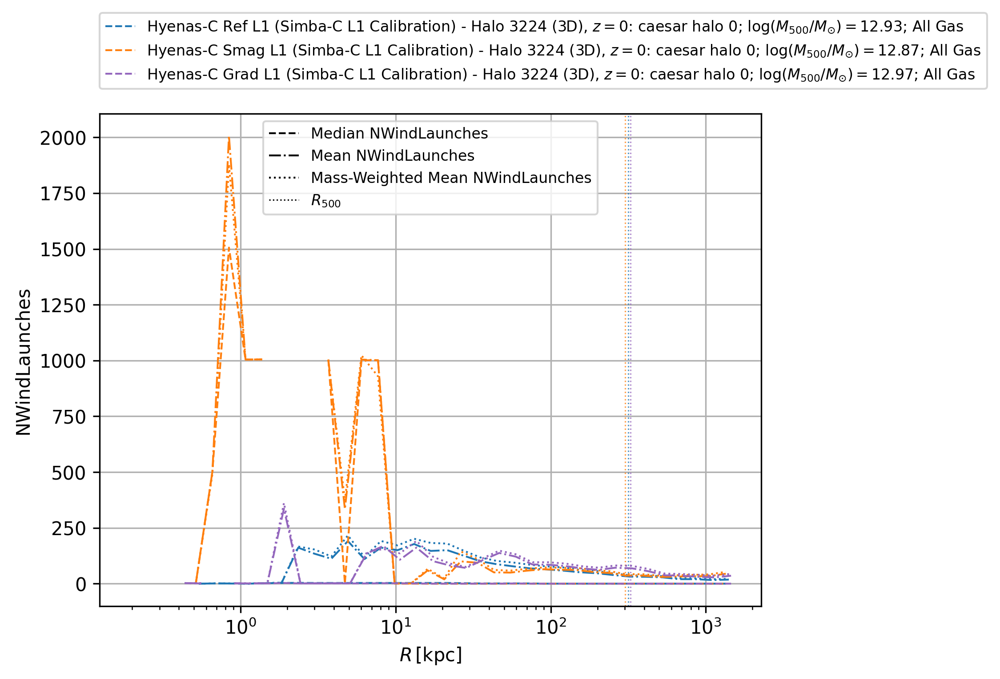

In [19]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('NWindLaunches')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[
    # Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=[
                  # 'Total NWindLaunches',
                      'Median NWindLaunches', 'Mean NWindLaunches',
                      'Mass-Weighted Mean NWindLaunches', 
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

## Delay Time

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


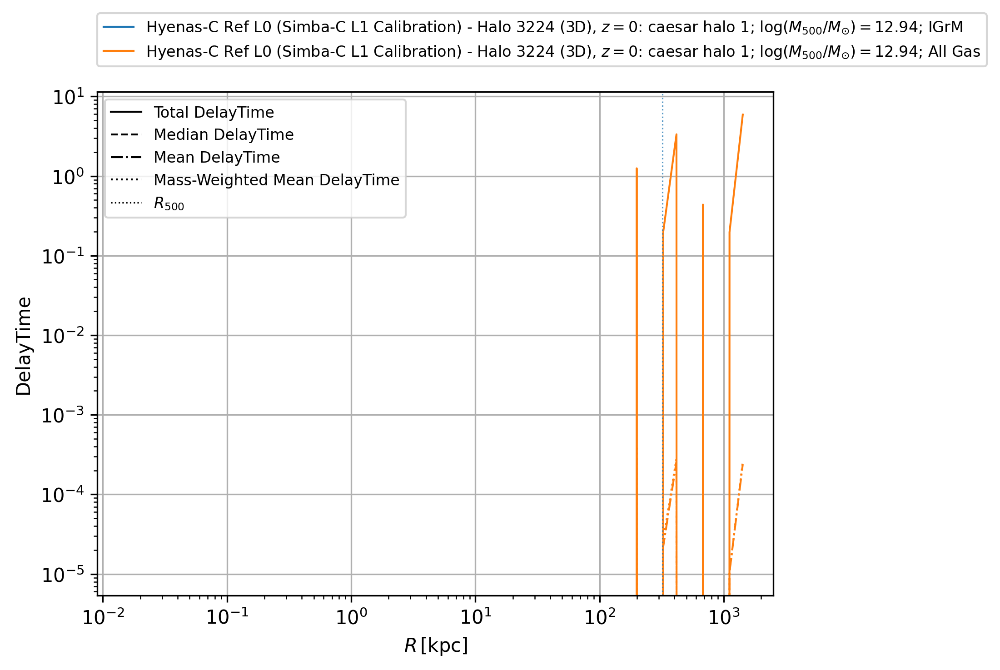

In [32]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('DelayTime')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total DelayTime', 'Median DelayTime', 'Mean DelayTime',
                      'Mass-Weighted Mean DelayTime', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


/tmp/ipykernel_2576845/2395360660.py:98: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  plt.yscale('log')


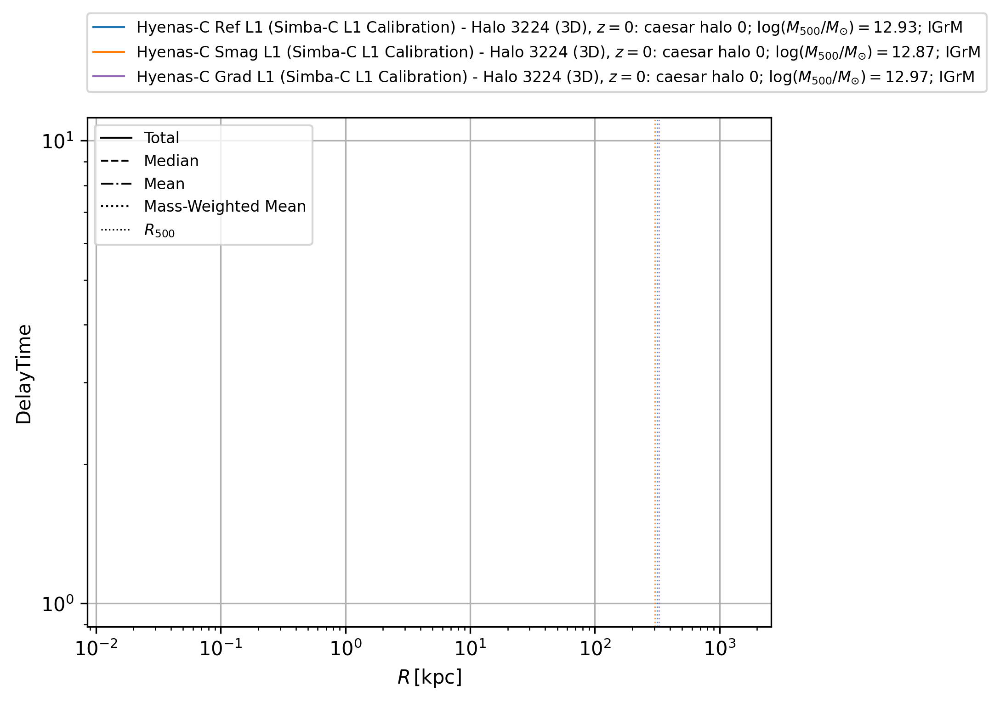

In [20]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('DelayTime')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total', 'Median', 'Mean',
                      'Mass-Weighted Mean', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


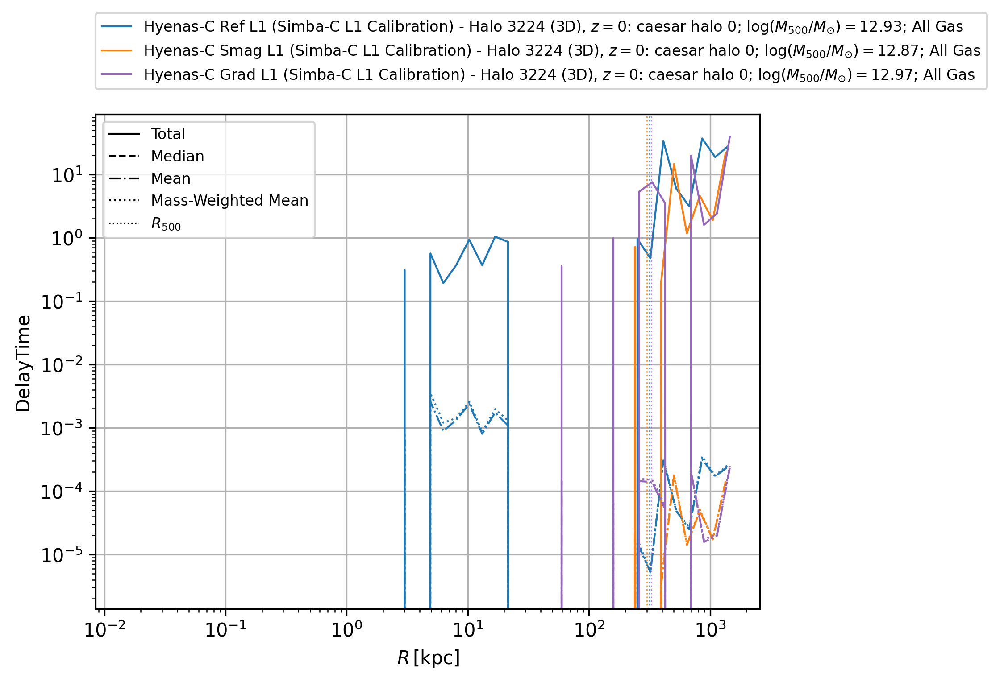

In [21]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('DelayTime')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total', 'Median', 'Mean',
                      'Mass-Weighted Mean', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()


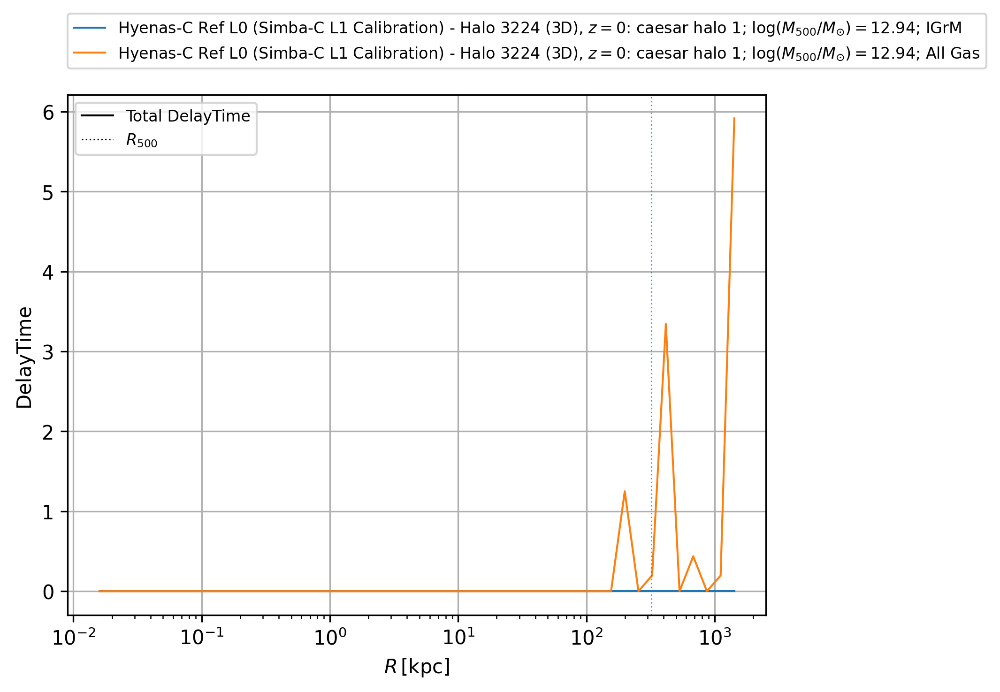

In [33]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('DelayTime')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total DelayTime',
                      # 'Median NWindLaunches', 'Mean NWindLaunches',
                      # 'Mass-Weighted Mean NWindLaunches', 
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()


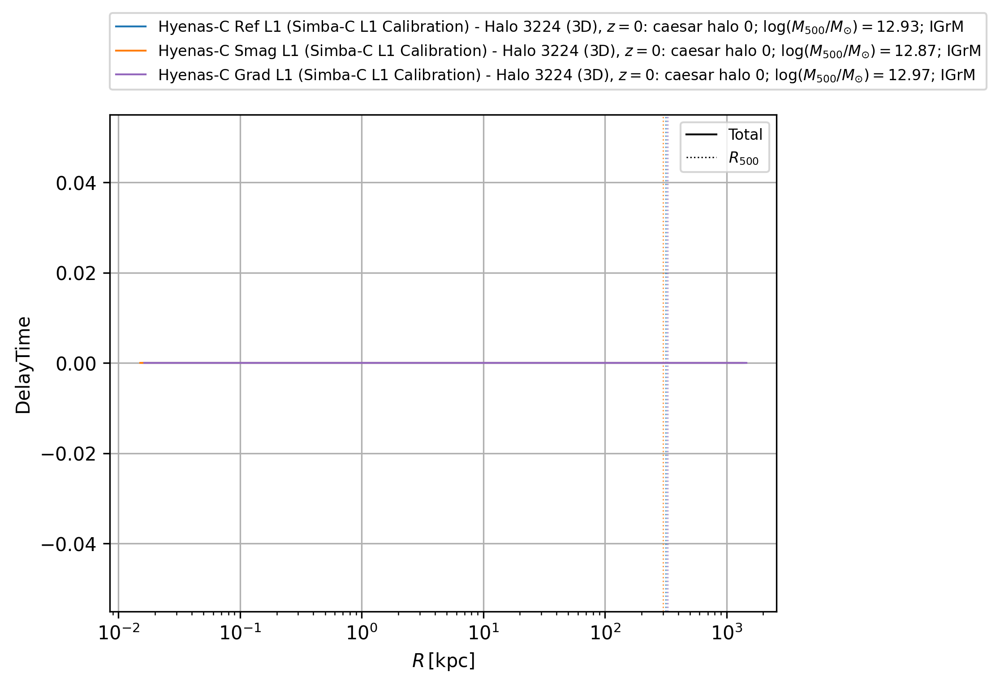

In [22]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('DelayTime')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total',
                      # 'Median NWindLaunches', 'Mean NWindLaunches',
                      # 'Mass-Weighted Mean NWindLaunches', 
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()


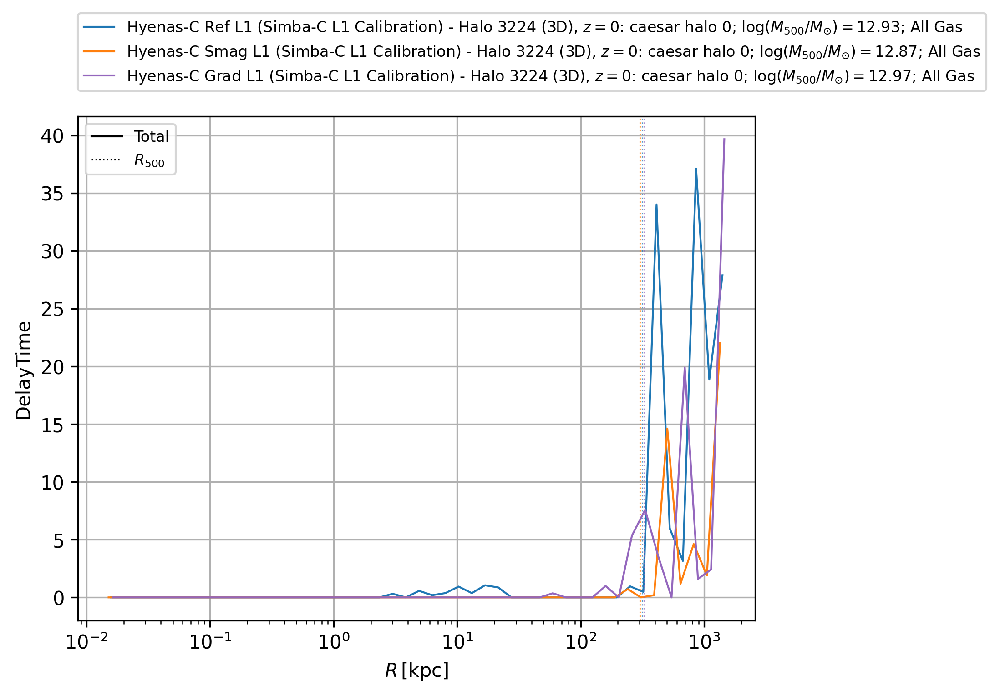

In [23]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('DelayTime')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total',
                      # 'Median NWindLaunches', 'Mean NWindLaunches',
                      # 'Mass-Weighted Mean NWindLaunches', 
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


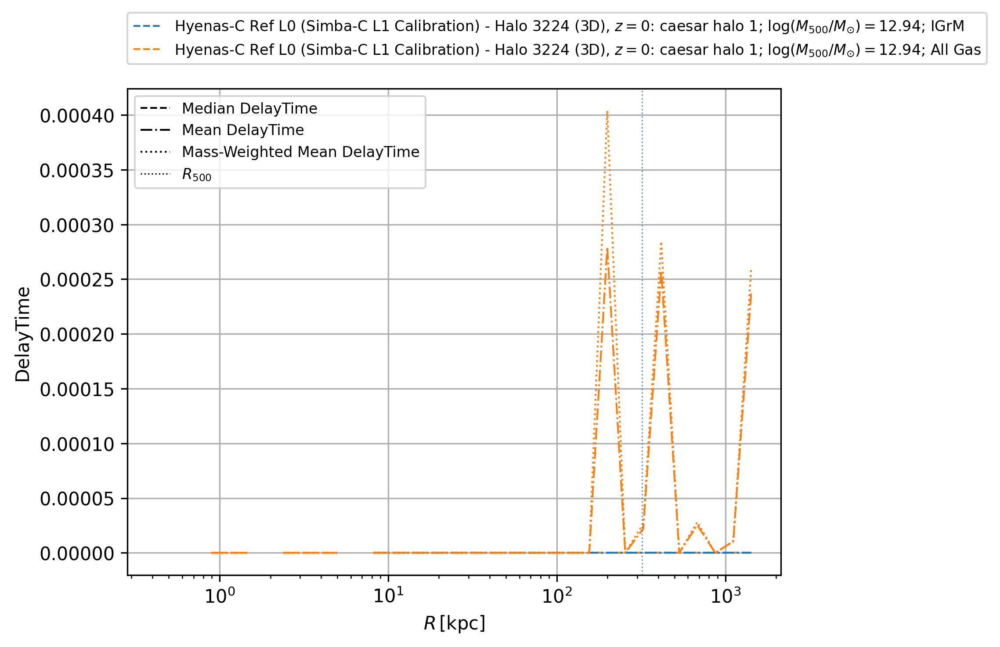

In [35]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('DelayTime')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[
    # Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=[
                  # 'Total NWindLaunches',
                      'Median DelayTime', 'Mean DelayTime',
                      'Mass-Weighted Mean DelayTime', 
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


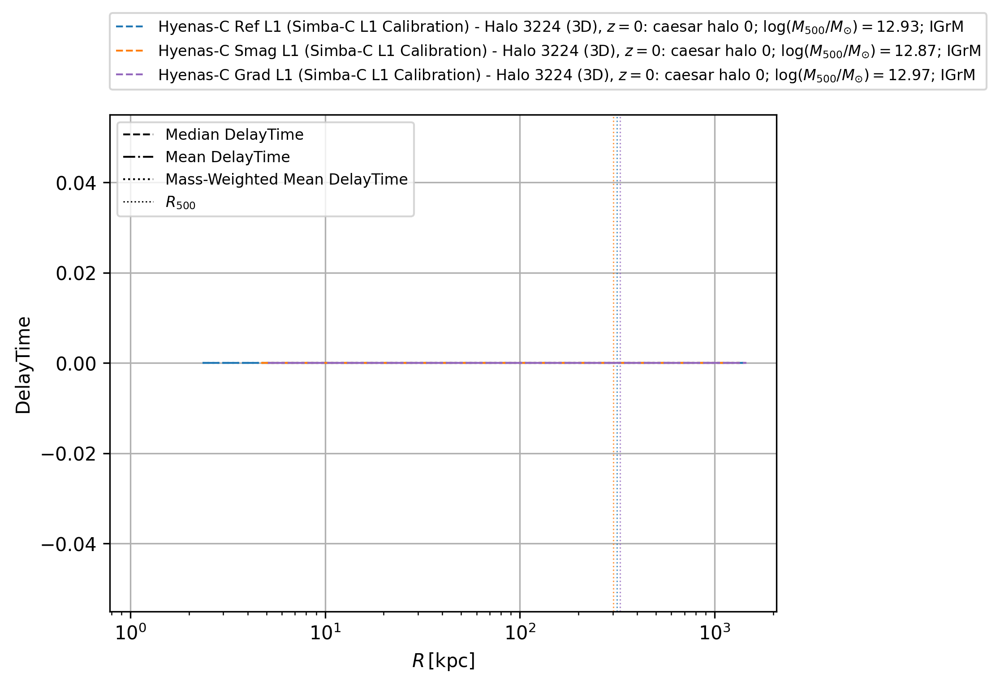

In [24]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('DelayTime')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[
    # Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=[
                  # 'Total NWindLaunches',
                      'Median DelayTime', 'Mean DelayTime',
                      'Mass-Weighted Mean DelayTime', 
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


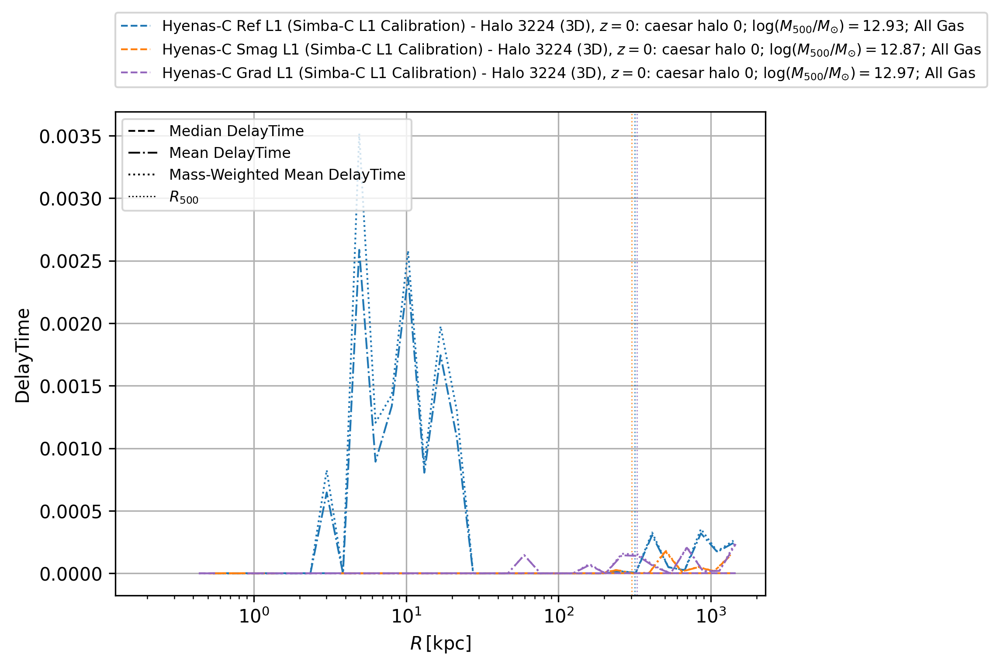

In [25]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['NWindLaunches']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i+1], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['DelayTime-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['DelayTime-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('DelayTime')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[
    # Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=[
                  # 'Total NWindLaunches',
                      'Median DelayTime', 'Mean DelayTime',
                      'Mass-Weighted Mean DelayTime', 
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

## Contamination Count

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


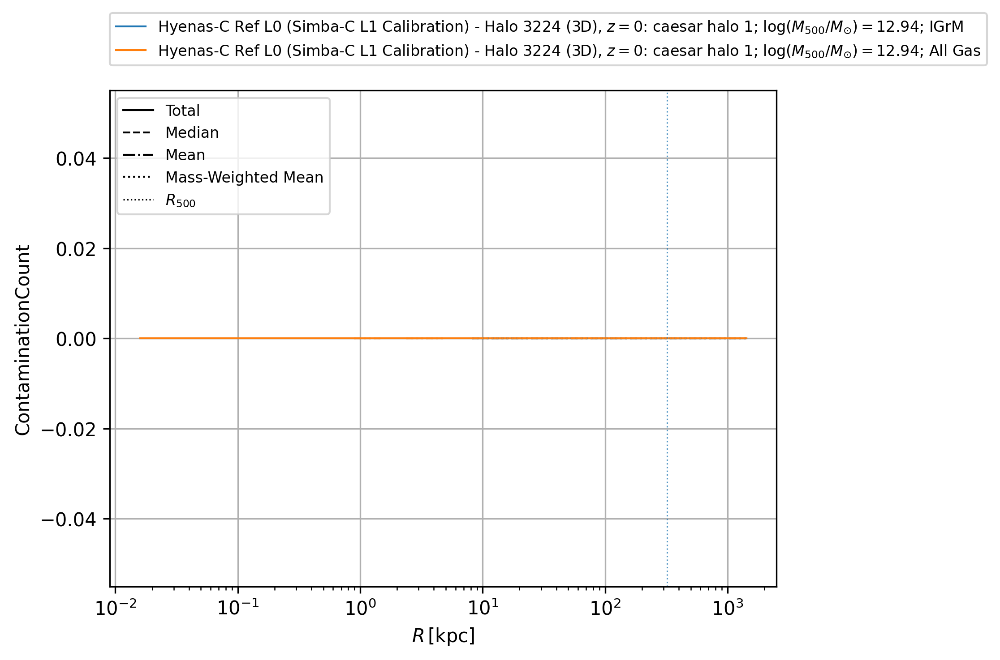

In [37]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ContaminationCount']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['ContaminationCount']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ContaminationCount-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['ContaminationCount-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ContaminationCount-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['ContaminationCount-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ContaminationCount-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['ContaminationCount-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('ContaminationCount')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total', 'Median', 'Mean',
                      'Mass-Weighted Mean', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()


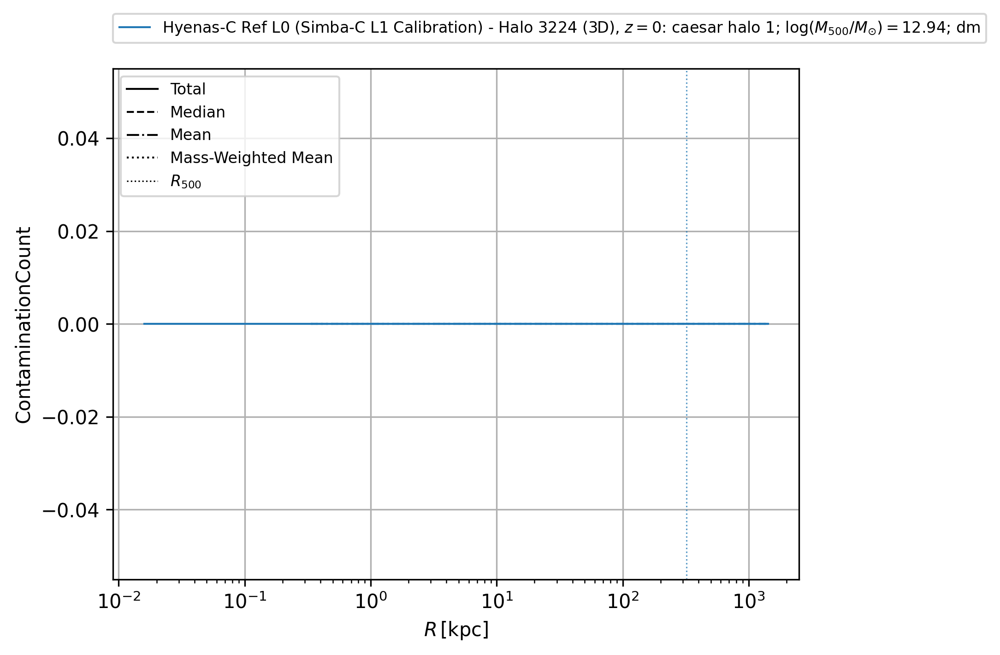

In [38]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['dm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['ContaminationCount']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; dm')


        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['ContaminationCount-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['ContaminationCount-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['ContaminationCount-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('ContaminationCount')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total', 'Median', 'Mean',
                      'Mass-Weighted Mean', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()


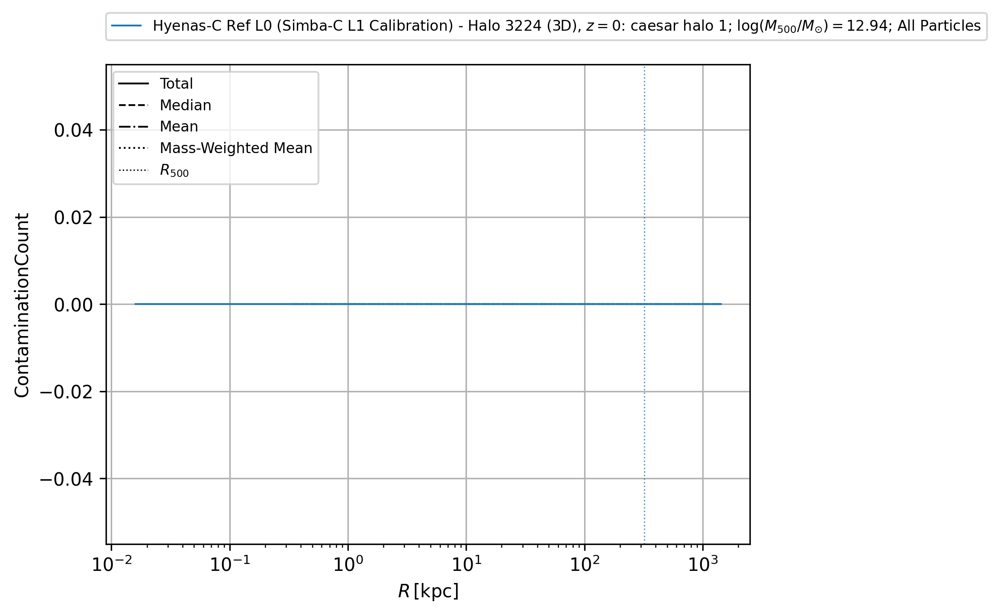

In [39]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['all_particles']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['ContaminationCount']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Particles')


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['ContaminationCount-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['ContaminationCount-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['all_particles'][halo_id]['full']['y']['ContaminationCount-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel('ContaminationCount')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Total', 'Median', 'Mean',
                      'Mass-Weighted Mean', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

## Temperature

K
K
K
K
K
K


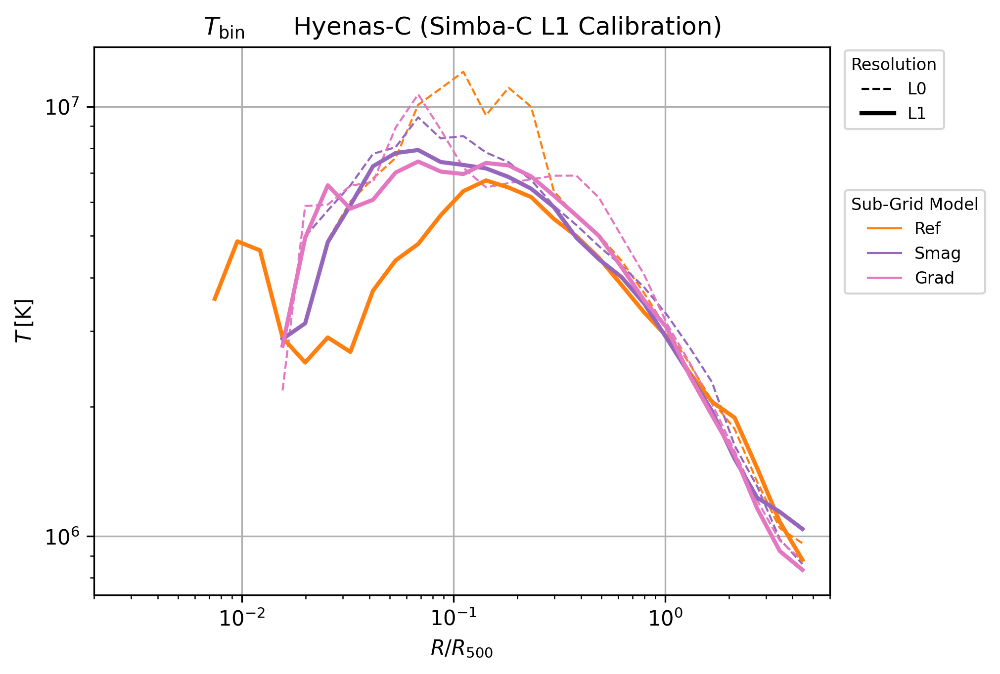

In [18]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = [#'C0',  # Hyenas Ref L0
              # 'C1',  # Hyenas-C Ref L0 (L0 Cali)
              # 'C4', 'C4', 'C4', 'C4',  # Hyenas-C Smag (all, u, v, z) L0 (L0 Cali)
              # 'C6', 'C6', 'C6',  # Hyenas-C Grad (all, v, z) L0 (L0 Cali)
              'C1', 'C4', 'C6',  # Hyenas-C Ref, Smag, Grad L0 (L1 Cali)
              # 'C0',  # Hyenas Ref L1
              'C1',  # Hyenas-C Ref L1 (L1 Cali)
              'C4',  # Hyenas-C Smag L1 (L1 Cali)
              'C6',  # Hyenas-C Grad L1 (L1 Cali)
             ]

lw_list = [#1,
           # 1,
           # 1, 1, 1, 1,
           # 1, 1, 1,
           1, 1, 1,
           # 2,
           2,
           2,
           2,
          ]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = [#'-',
           # '-',
           # '-', '--', '-.', ':',
           # '-', '-.', ':',
           # '-', '-', '-',
            '--', '--', '--',
           # '-',
           '-',
           '-',
           '-',
          ]

alpha_list = [#1,
              # 0.5,
              # 0.5, 0.5, 0.5, 0.5,
              # 0.5, 0.5, 0.5,
              1, 1, 1,
              # 1,
              1,
              1,
              1,
             ]
# alpha_list = [1,
#               1,
#               # 1,1,1,1,
#               # 1,1,1,
#               1,# 1, 1,
#               1,
#               1,
#               # 1,
#               # 1,
#              ]

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=ls_list[i], alpha=alpha_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(2e-3, 6e0)
# plt.ylim(3e-2, 1e1)

plt.xlabel(r'$R/R_{500}$')
# plt.ylabel(r'$T/T_{500}$')
plt.ylabel(r'$T\,[\mathrm{K}]$')

title = r'$T_{\mathrm{bin}}$'
# title += '\tL0 (Simba-C L0 Calibration)'
# title += '\t(Simba-C L1 Calibration)'
title += '\tHyenas-C (Simba-C L1 Calibration)'
plt.title(title)

ax = plt.gca()
fig = plt.gcf()



# plot_obs_entropy_baseline('voit2005', ax=ax, xscale='r500', yscale='k500', n_points=2,
#                           plot_kwargs={'color':'black', 'ls':'--',
#                                        'label':r'$K/K_{200}=1.32(R/R_{200})^{1.1}$ (Voit+2005)'})
# plot_obs_entropy_baseline('mccarthy2008', ax=ax, xscale='r500', yscale='k500', n_points=2,
#                           plot_kwargs={'color':'black', 'ls':'-.',
#                                        'label':r'$K/K_{200}=1.47(R/R_{200})^{1.22}$ (McCarthy+2008)'})

# print()
# sim0 = list(sim_dict.keys())[0]
# print(sim0)
# halo0 = list(sim_dict[sim0]['profile']['halo_info'].keys())[0]
# print(halo0)
# xscale_value = sim_dict[sim0]['profile']['halo_info'][halo0]['R']['500']
# print(xscale_value, xscale_value.units)
# yscale_value = sim_dict[sim0]['profile']['halo_info'][halo0]['K']['500ideal']
# print(yscale_value, yscale_value.units)
# print()
# plot_obs_entropy('panagoulia2014', ax=ax,
#                  xscale='r500', xunits='1', xscale_value=xscale_value,
#                  yscale='k500', yunits='1', yscale_value=yscale_value,
#                  n_points=2,
#                  plot_kwargs={'color':'black', 'ls':':',
#                               'label':r'$K(R)=95.4\,\mathrm{keV\,cm^2}\times(R/100\,\mathrm{kpc})^{0.7}$ (Panagoulia+2014)'})

# ax.legend(fontsize=8, loc=(0, 1.1))


leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=2,ls='-',color='black',),],
              labels=['L0', 'L1'],
              title='Resolution', title_fontsize=8,
              fontsize=8, loc=(1.02,0.85))
ax.add_artist(leg2)

# leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C0',),
#                            Line2D([],[],lw=1,ls='-',color='C1',),
#                            Line2D([],[],lw=1,ls='-',color='C4',),
#                            Line2D([],[],lw=1,ls='-',color='C6',),],
#               labels=['Hyenas Ref', 'Hyenas-C Ref', 'Hyenas-C Smag', 'Hyenas-C Grad'],
#               title='Sub-Grid Model', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.55))
# ax.add_artist(leg3)
leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C1',),
                           Line2D([],[],lw=1,ls='-',color='C4',),
                           Line2D([],[],lw=1,ls='-',color='C6',),],
              labels=['Ref', 'Smag', 'Grad'],
              title='Sub-Grid Model', title_fontsize=8,
              fontsize=8, loc=(1.02,0.55))
ax.add_artist(leg3)

# leg4 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',),
#                            Line2D([],[],lw=1,ls='-.',color='black',),
#                            Line2D([],[],lw=1,ls=':',color='black',),],
#               labels=['Full Model', 'Energy Only', 'Momentum Only', 'Metals Only'],
#               title='Turbulent Diffusion', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.25))
# ax.add_artist(leg4)

# leg5 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',alpha=0.5,color='black',),
#                            Line2D([],[],lw=1,ls='-',alpha=1,color='black',),],
#               labels=['L0 Calibration', 'L1 Calibration'],
#               title='Hyenas-C Parameters', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.05))
# ax.add_artist(leg5)


fig.set_dpi(300)
plt.show()

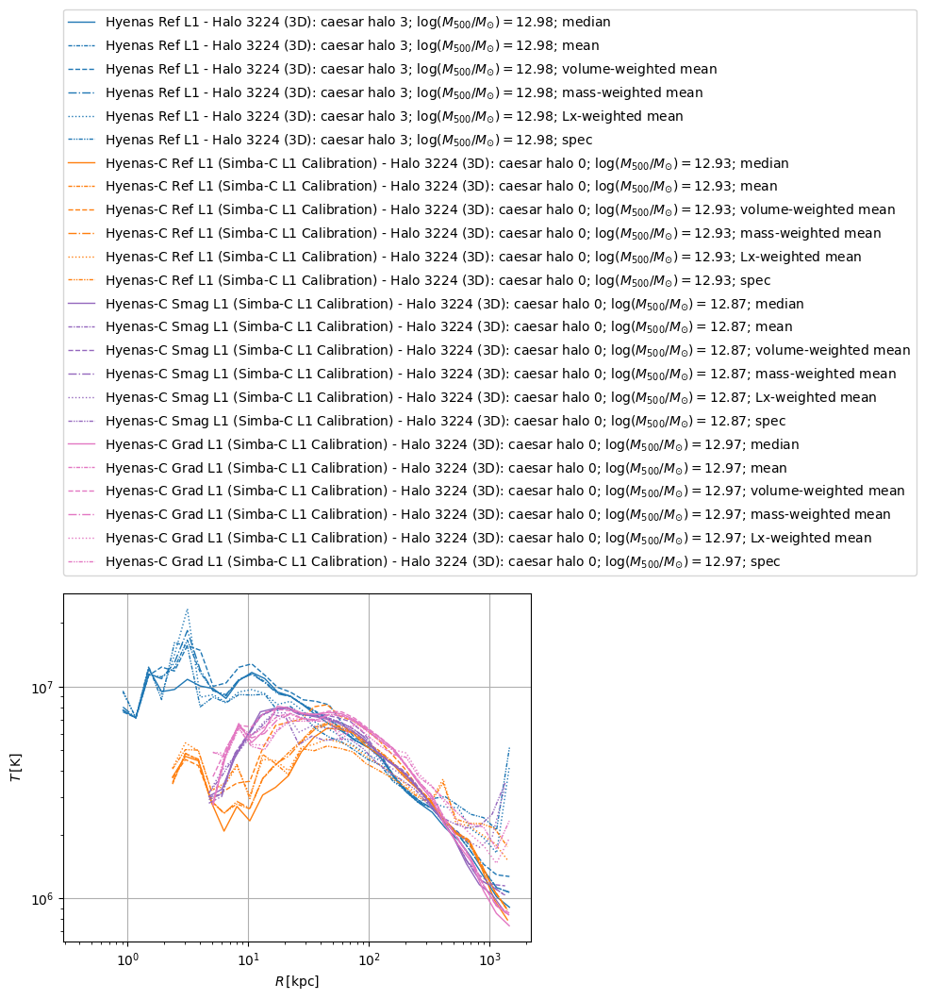

In [279]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
# lw_list = [2, 1]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-median']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-volume_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-mass_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-Lx_0.5-10.0keV_total_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-spec']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; spec')
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$T\,[\mathrm{K}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

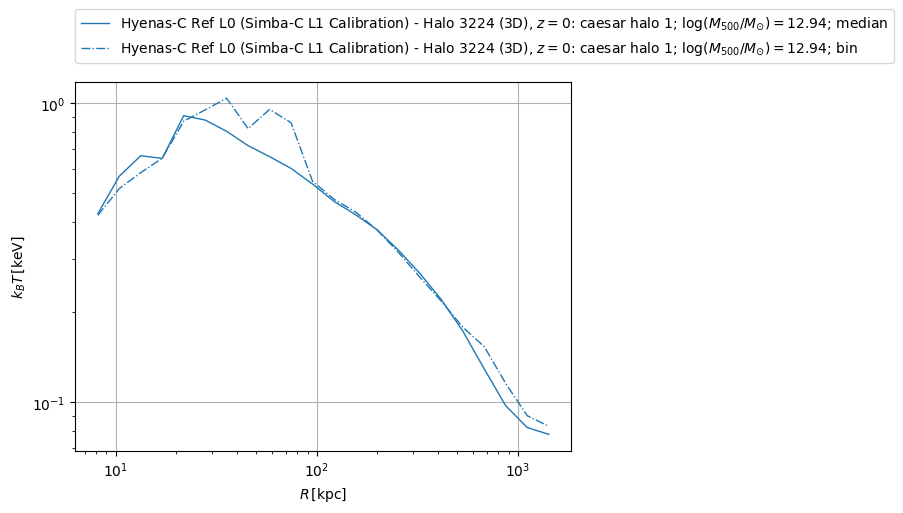

In [51]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-median']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-mean']
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-volume_weighted_mean']
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-bin']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; bin')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-mass_weighted_mean']
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=':',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-Lx_0.5-10.0keV_total_weighted_mean']
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=':',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx-weighted mean')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-spec']
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; spec')
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$k_BT\,[\mathrm{keV}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

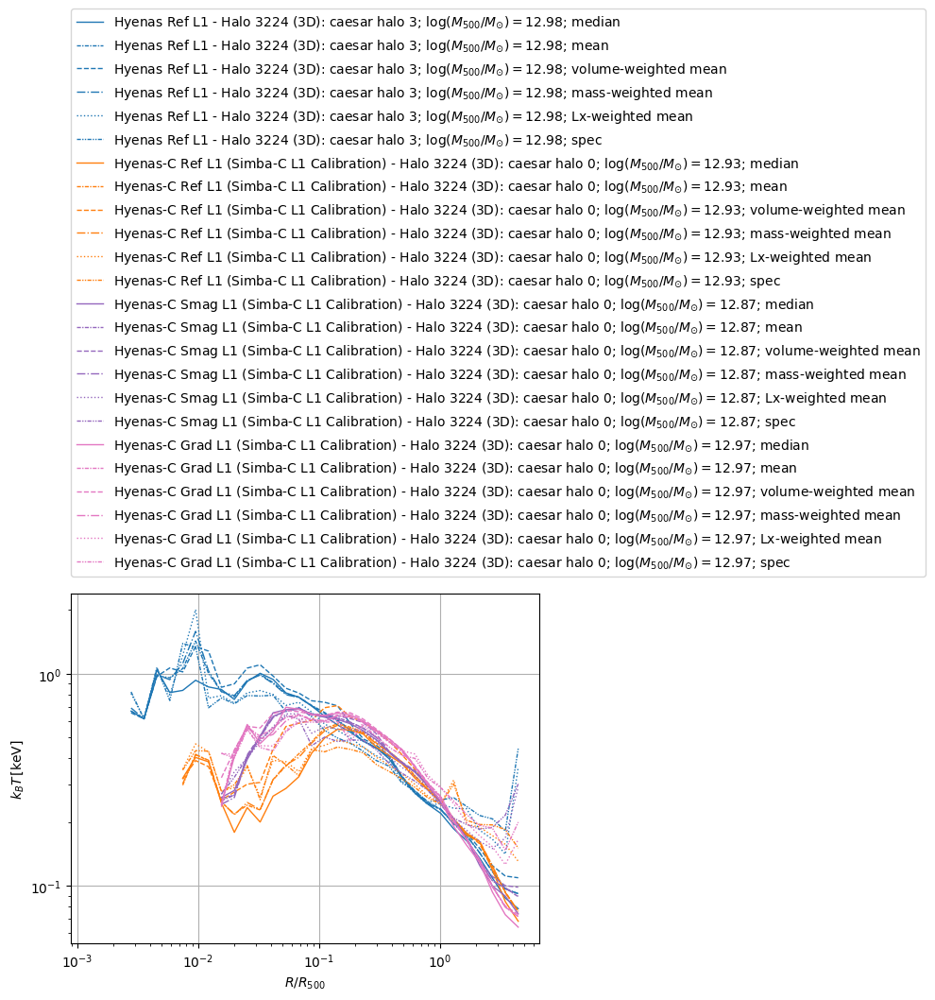

In [281]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        # x_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['x']['physical_rbin_centres']
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-median']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-volume_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-mass_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-Lx_0.5-10.0keV_total_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-spec']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; spec')
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
# plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$k_BT\,[\mathrm{keV}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

keV
keV
keV
keV


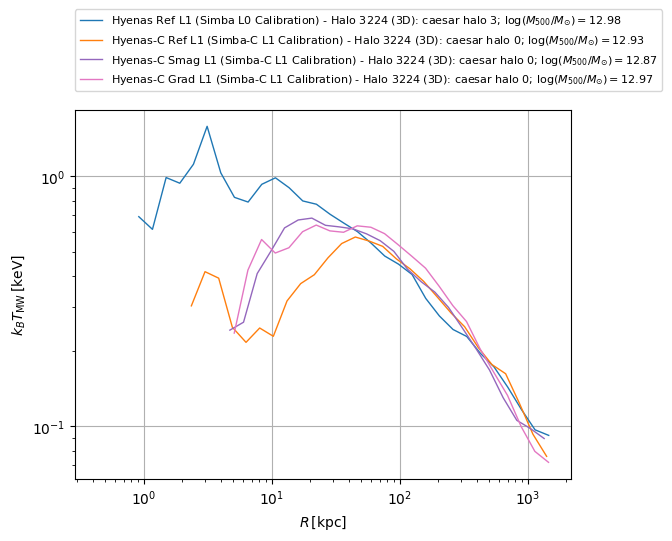

In [48]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$k_BT_{\mathrm{MW}}\,[\mathrm{keV}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',)],
#               labels=[r'$dP_{\mathrm{IGrM,VW}}/dR$', r'$-GM(<R)\rho(r)/R^2$'],
#               fontsize=8)
# ax.add_artist(leg2)
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00


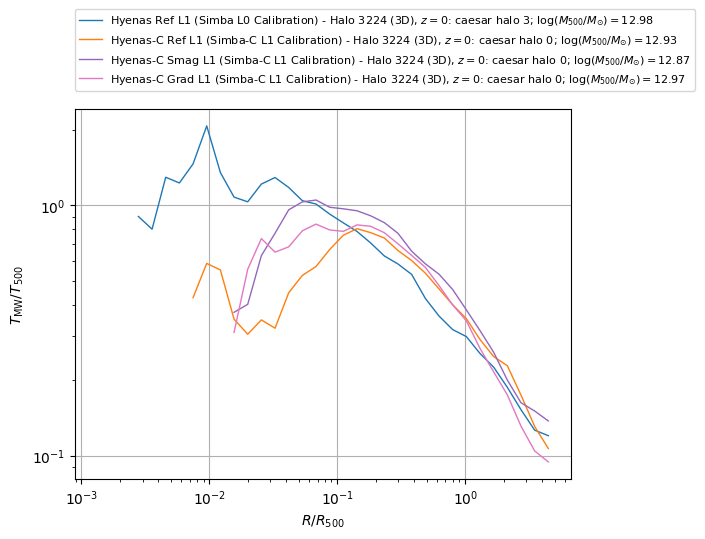

In [6]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-mass_weighted_mean-T500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$T_{\mathrm{MW}}/T_{500}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',)],
#               labels=[r'$dP_{\mathrm{IGrM,VW}}/dR$', r'$-GM(<R)\rho(r)/R^2$'],
#               fontsize=8)
# ax.add_artist(leg2)
plt.show()

keV
keV
keV
keV
keV
keV
keV
keV
keV
keV


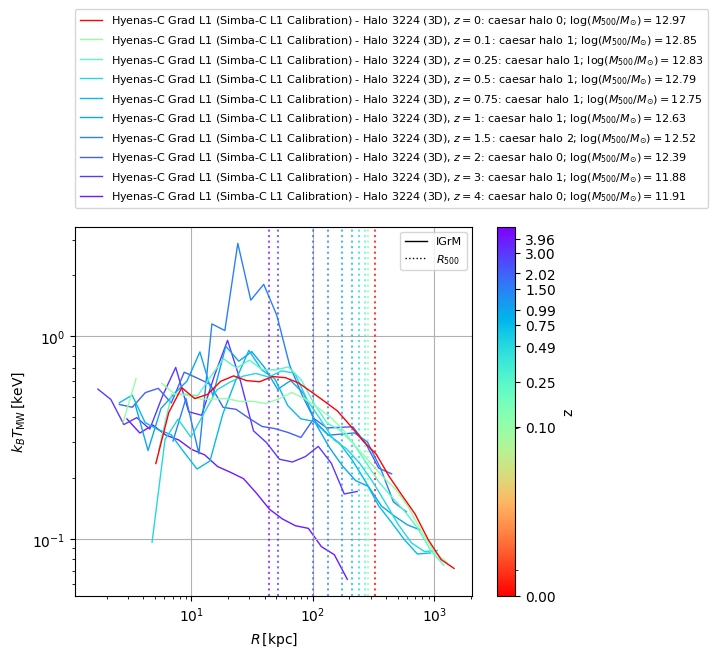

In [461]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$k_BT_{\mathrm{MW}}\,[\mathrm{keV}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'IGrM', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

keV
keV
keV
keV
keV
keV
keV
keV
keV
keV


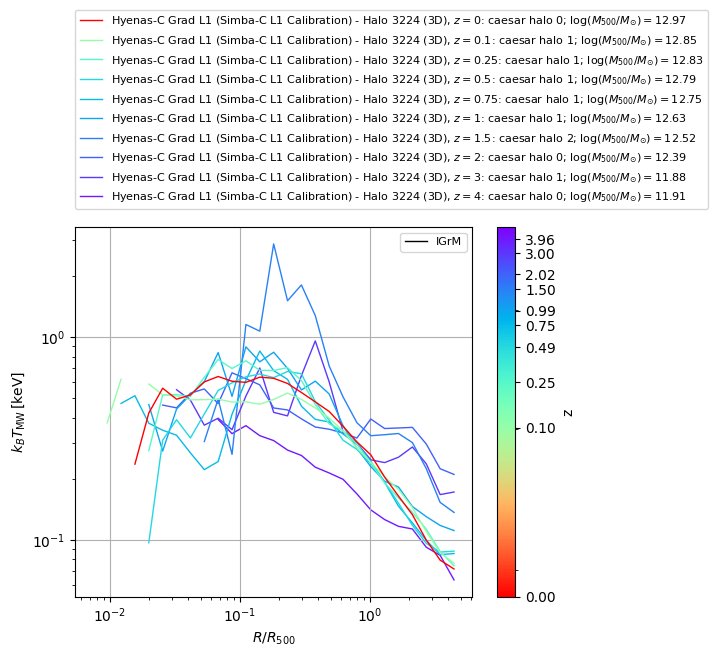

In [462]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['kT-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$k_BT_{\mathrm{MW}}\,[\mathrm{keV}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'IGrM',],# r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


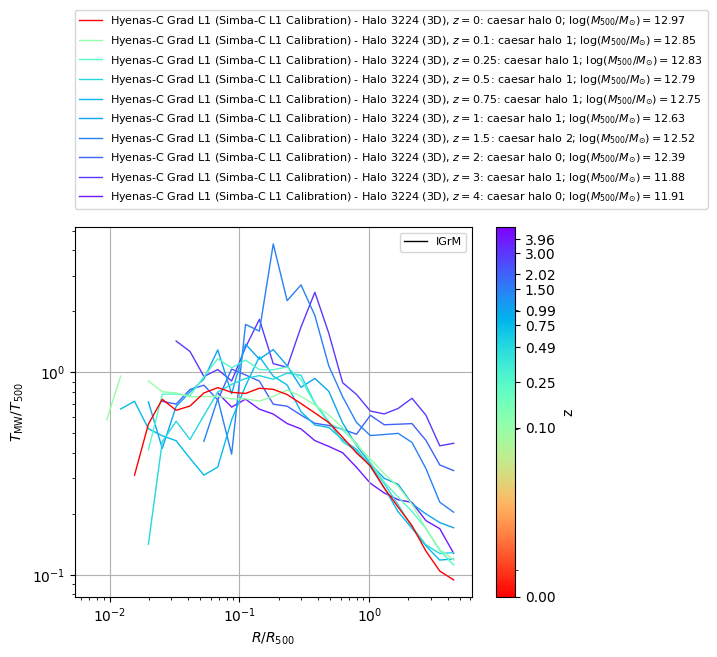

In [29]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = '1'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-mass_weighted_mean-T500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$T_{\mathrm{MW}}/T_{500}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'IGrM',],# r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

## Temperature dispersion

K
K
K
K
K
K


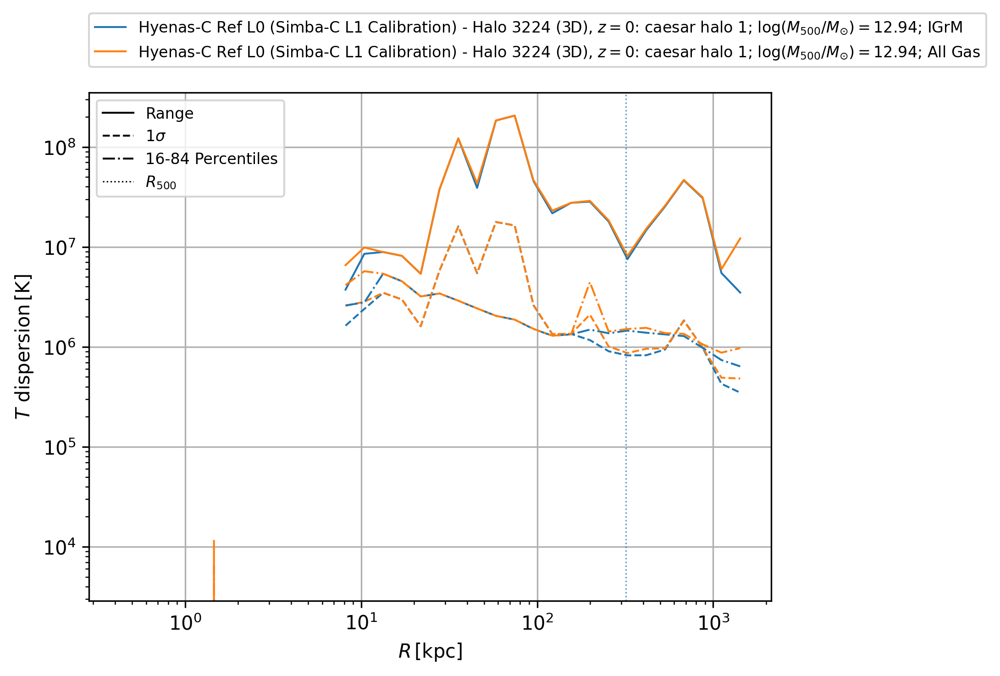

In [48]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'K'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['T-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['T-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['T-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$T\,\,\mathrm{dispersion}\,[\mathrm{K}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Range', r'$1\sigma$',
                      '16-84 Percentiles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

K
K
K
K
K
K
K
K
K


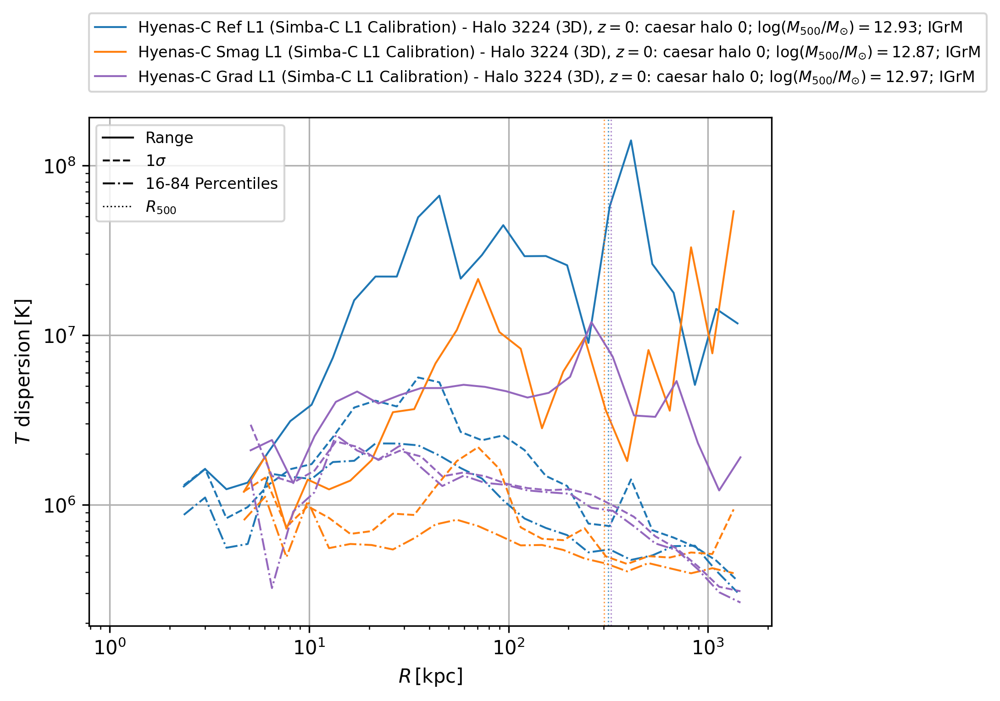

In [26]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'K'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['T-range']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['T-std']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['T-iqr']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$T\,\,\mathrm{dispersion}\,[\mathrm{K}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Range', r'$1\sigma$',
                      '16-84 Percentiles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

K
K
K
K
K
K
K
K
K


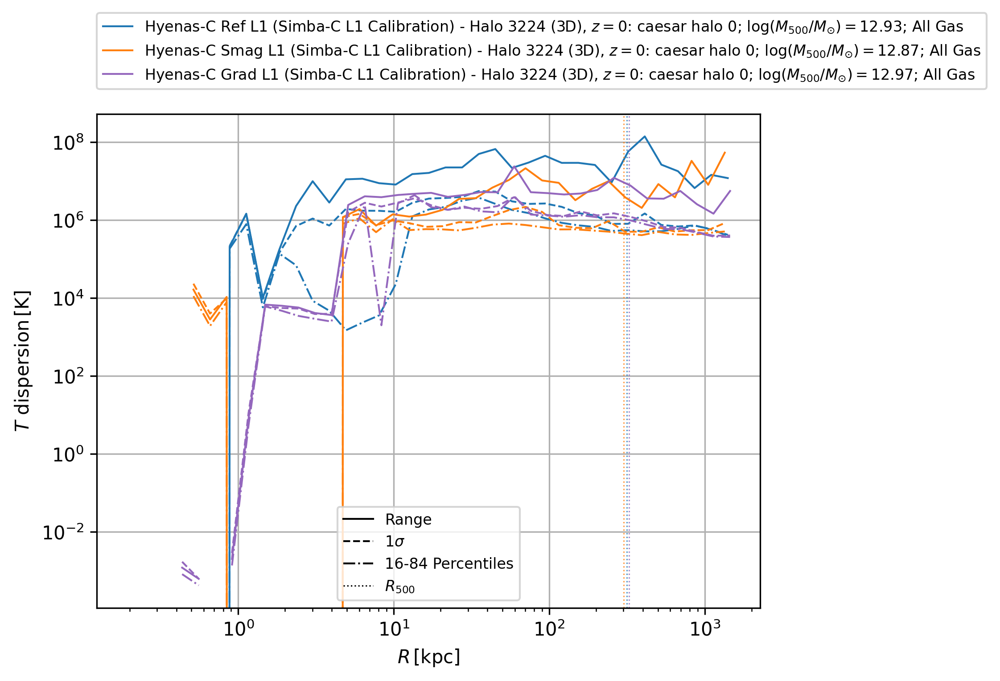

In [27]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'K'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-range']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['T-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-std']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['T-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['T-iqr']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['T-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$T\,\,\mathrm{dispersion}\,[\mathrm{K}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Range', r'$1\sigma$',
                      '16-84 Percentiles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

## Electron Number

kpc**3 cm**-3
kpc**3 cm**-3
kpc**3 cm**-3
kpc**3 cm**-3


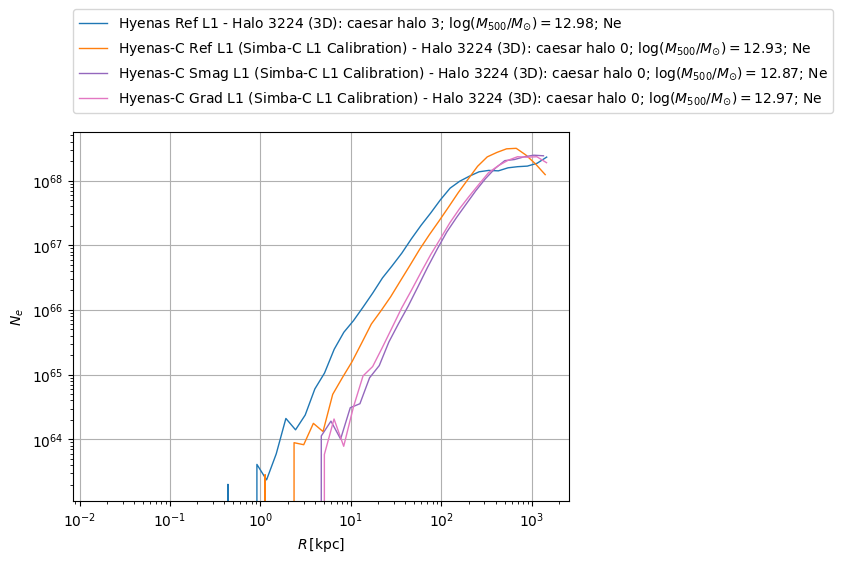

In [282]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = '1'

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Ne')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Ne_v2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Ne_v2')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$N_e$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

## Hydrogen Number

kpc**3 cm**-3
kpc**3 cm**-3
kpc**3 cm**-3
kpc**3 cm**-3


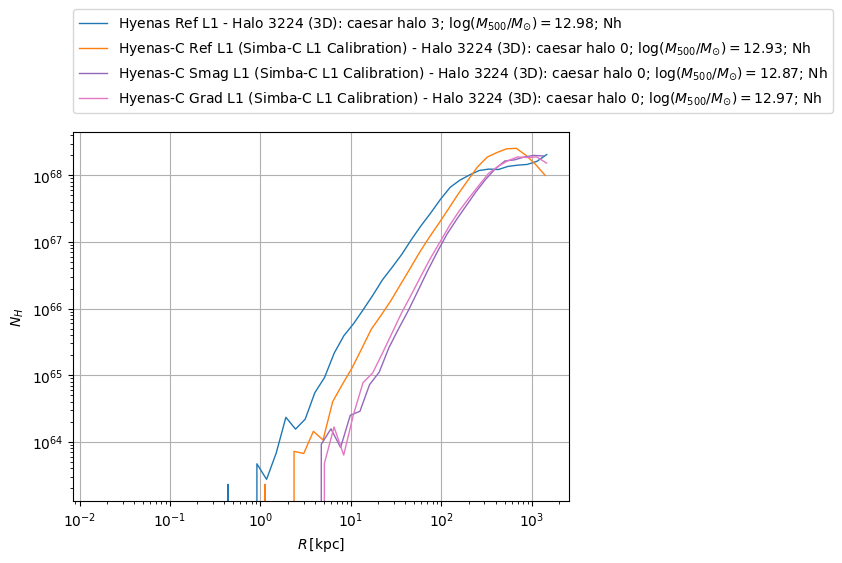

In [283]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = '1'

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Nh']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Nh')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Nh_v2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Nh_v2')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$N_H$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

## X-ray Luminosity

erg s**-1
erg s**-1
erg s**-1
erg s**-1


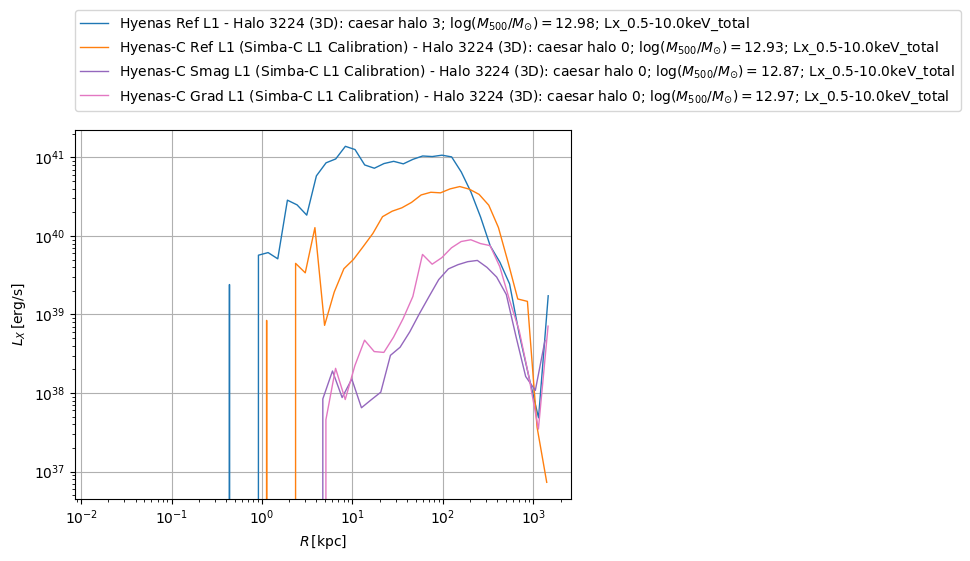

In [284]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = '1'

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Lx_0.5-10.0keV_total']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx_0.5-10.0keV_total')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Lx_0.5-10.0keV_total_v2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,#.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx_0.5-10.0keV_total_v2')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$L_X\,[\mathrm{erg/s}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

erg s**-1
erg s**-1
erg s**-1
erg s**-1


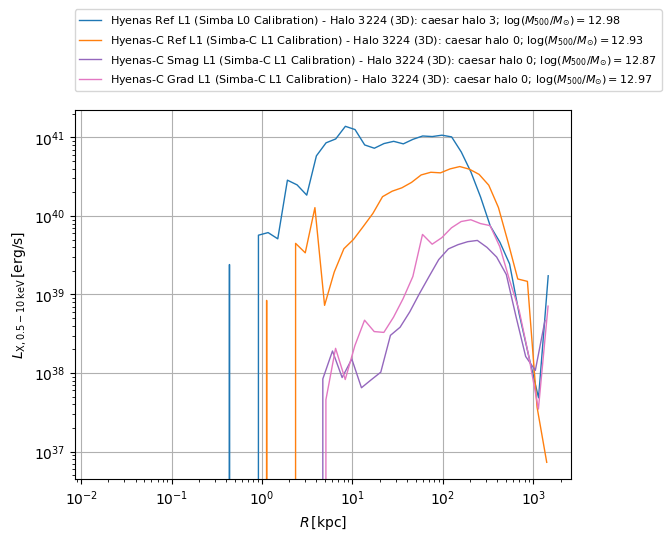

In [50]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = '1'

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Lx_0.5-10.0keV_total']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Lx_0.5-10.0keV_total_v2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,#.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx_0.5-10.0keV_total_v2')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$L_{\mathrm{X,0.5-10\,keV}}\,[\mathrm{erg/s}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',)],
#               labels=[r'$dP_{\mathrm{IGrM,VW}}/dR$', r'$-GM(<R)\rho(r)/R^2$'],
#               fontsize=8)
# ax.add_artist(leg2)
plt.show()

erg s**-1
erg s**-1
erg s**-1
erg s**-1
erg s**-1
erg s**-1
erg s**-1
erg s**-1
erg s**-1
erg s**-1


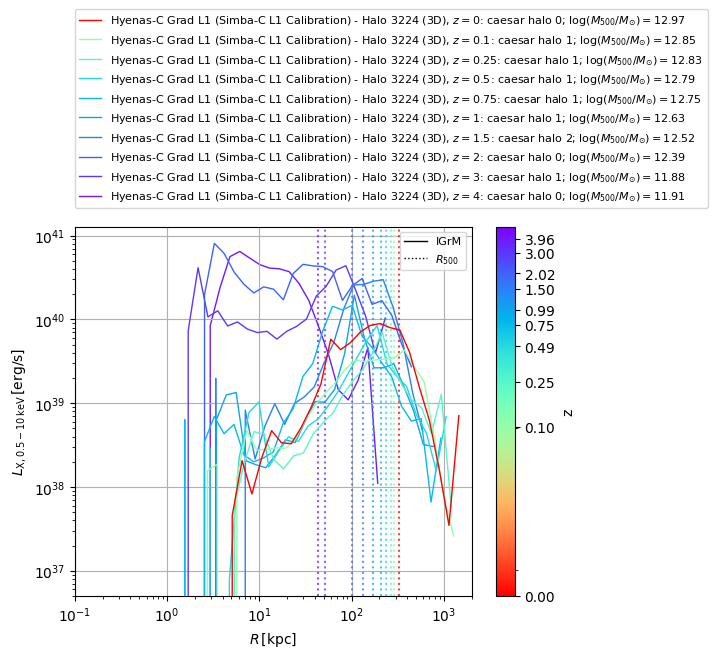

In [463]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'erg s**-1'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Lx_0.5-10.0keV_total']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$L_{\mathrm{X,0.5-10\,keV}}\,[\mathrm{erg/s}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'IGrM', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

erg s**-1
erg s**-1
erg s**-1
erg s**-1
erg s**-1
erg s**-1
erg s**-1
erg s**-1
erg s**-1
erg s**-1


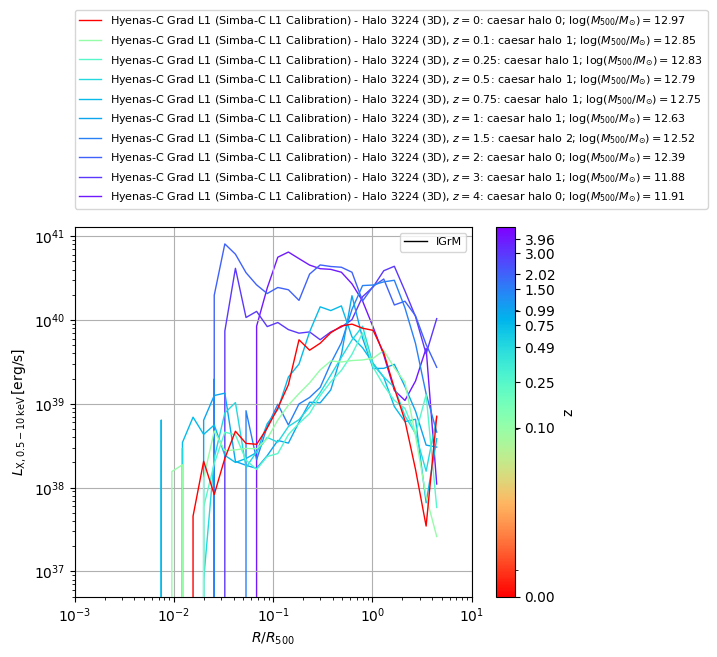

In [464]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(100, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'erg s**-1'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Lx_0.5-10.0keV_total']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$L_{\mathrm{X,0.5-10\,keV}}\,[\mathrm{erg/s}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'IGrM',],# r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

## Electron Number Density

cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3


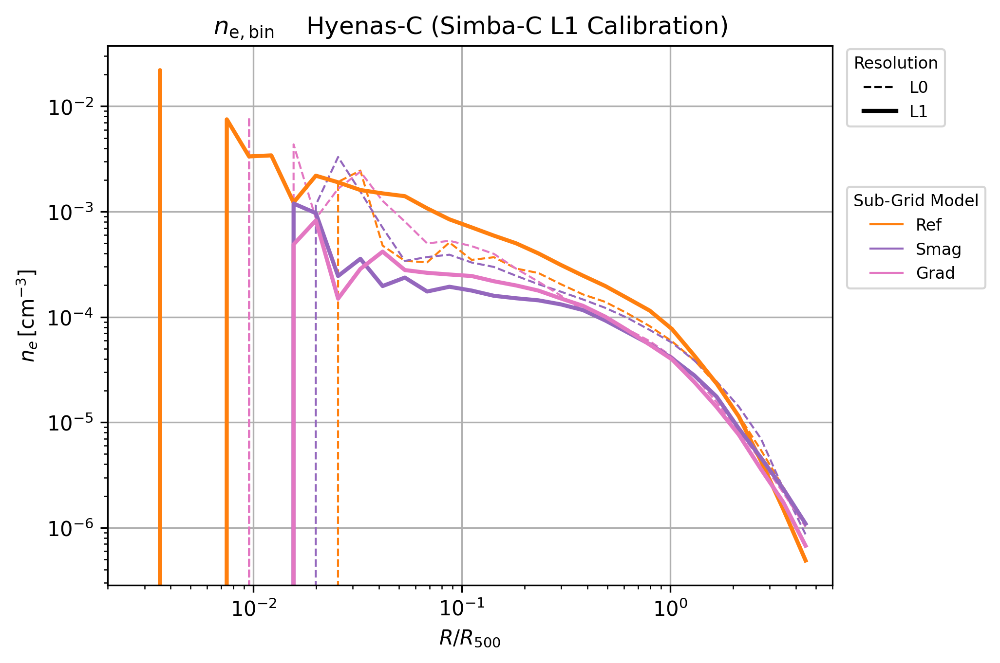

In [17]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = [#'C0',  # Hyenas Ref L0
              # 'C1',  # Hyenas-C Ref L0 (L0 Cali)
              # 'C4', 'C4', 'C4', 'C4',  # Hyenas-C Smag (all, u, v, z) L0 (L0 Cali)
              # 'C6', 'C6', 'C6',  # Hyenas-C Grad (all, v, z) L0 (L0 Cali)
              'C1', 'C4', 'C6',  # Hyenas-C Ref, Smag, Grad L0 (L1 Cali)
              # 'C0',  # Hyenas Ref L1
              'C1',  # Hyenas-C Ref L1 (L1 Cali)
              'C4',  # Hyenas-C Smag L1 (L1 Cali)
              'C6',  # Hyenas-C Grad L1 (L1 Cali)
             ]

lw_list = [#1,
           # 1,
           # 1, 1, 1, 1,
           # 1, 1, 1,
           1, 1, 1,
           # 2,
           2,
           2,
           2,
          ]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = [#'-',
           # '-',
           # '-', '--', '-.', ':',
           # '-', '-.', ':',
           # '-', '-', '-',
            '--', '--', '--',
           # '-',
           '-',
           '-',
           '-',
          ]

alpha_list = [#1,
              # 0.5,
              # 0.5, 0.5, 0.5, 0.5,
              # 0.5, 0.5, 0.5,
              1, 1, 1,
              # 1,
              1,
              1,
              1,
             ]
# alpha_list = [1,
#               1,
#               # 1,1,1,1,
#               # 1,1,1,
#               1,# 1, 1,
#               1,
#               1,
#               # 1,
#               # 1,
#              ]

i = 0

units = 'cm**-3'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ne-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=ls_list[i], alpha=alpha_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(2e-3, 6e0)
# plt.ylim(3e-2, 1e1)

plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$n_{e}\,[\mathrm{cm^{-3}}]$')

title = r'$n_{\mathrm{e,bin}}$'
# title += '\tL0 (Simba-C L0 Calibration)'
# title += '\t(Simba-C L1 Calibration)'
title += '\tHyenas-C (Simba-C L1 Calibration)'
plt.title(title)

ax = plt.gca()
fig = plt.gcf()



# plot_obs_entropy_baseline('voit2005', ax=ax, xscale='r500', yscale='k500', n_points=2,
#                           plot_kwargs={'color':'black', 'ls':'--',
#                                        'label':r'$K/K_{200}=1.32(R/R_{200})^{1.1}$ (Voit+2005)'})
# plot_obs_entropy_baseline('mccarthy2008', ax=ax, xscale='r500', yscale='k500', n_points=2,
#                           plot_kwargs={'color':'black', 'ls':'-.',
#                                        'label':r'$K/K_{200}=1.47(R/R_{200})^{1.22}$ (McCarthy+2008)'})

# print()
# sim0 = list(sim_dict.keys())[0]
# print(sim0)
# halo0 = list(sim_dict[sim0]['profile']['halo_info'].keys())[0]
# print(halo0)
# xscale_value = sim_dict[sim0]['profile']['halo_info'][halo0]['R']['500']
# print(xscale_value, xscale_value.units)
# yscale_value = sim_dict[sim0]['profile']['halo_info'][halo0]['K']['500ideal']
# print(yscale_value, yscale_value.units)
# print()
# plot_obs_entropy('panagoulia2014', ax=ax,
#                  xscale='r500', xunits='1', xscale_value=xscale_value,
#                  yscale='k500', yunits='1', yscale_value=yscale_value,
#                  n_points=2,
#                  plot_kwargs={'color':'black', 'ls':':',
#                               'label':r'$K(R)=95.4\,\mathrm{keV\,cm^2}\times(R/100\,\mathrm{kpc})^{0.7}$ (Panagoulia+2014)'})

# ax.legend(fontsize=8, loc=(0, 1.1))


leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=2,ls='-',color='black',),],
              labels=['L0', 'L1'],
              title='Resolution', title_fontsize=8,
              fontsize=8, loc=(1.02,0.85))
ax.add_artist(leg2)

# leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C0',),
#                            Line2D([],[],lw=1,ls='-',color='C1',),
#                            Line2D([],[],lw=1,ls='-',color='C4',),
#                            Line2D([],[],lw=1,ls='-',color='C6',),],
#               labels=['Hyenas Ref', 'Hyenas-C Ref', 'Hyenas-C Smag', 'Hyenas-C Grad'],
#               title='Sub-Grid Model', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.55))
# ax.add_artist(leg3)
leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C1',),
                           Line2D([],[],lw=1,ls='-',color='C4',),
                           Line2D([],[],lw=1,ls='-',color='C6',),],
              labels=['Ref', 'Smag', 'Grad'],
              title='Sub-Grid Model', title_fontsize=8,
              fontsize=8, loc=(1.02,0.55))
ax.add_artist(leg3)

# leg4 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',),
#                            Line2D([],[],lw=1,ls='-.',color='black',),
#                            Line2D([],[],lw=1,ls=':',color='black',),],
#               labels=['Full Model', 'Energy Only', 'Momentum Only', 'Metals Only'],
#               title='Turbulent Diffusion', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.25))
# ax.add_artist(leg4)

# leg5 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',alpha=0.5,color='black',),
#                            Line2D([],[],lw=1,ls='-',alpha=1,color='black',),],
#               labels=['L0 Calibration', 'L1 Calibration'],
#               title='Hyenas-C Parameters', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.05))
# ax.add_artist(leg5)


fig.set_dpi(300)
plt.show()

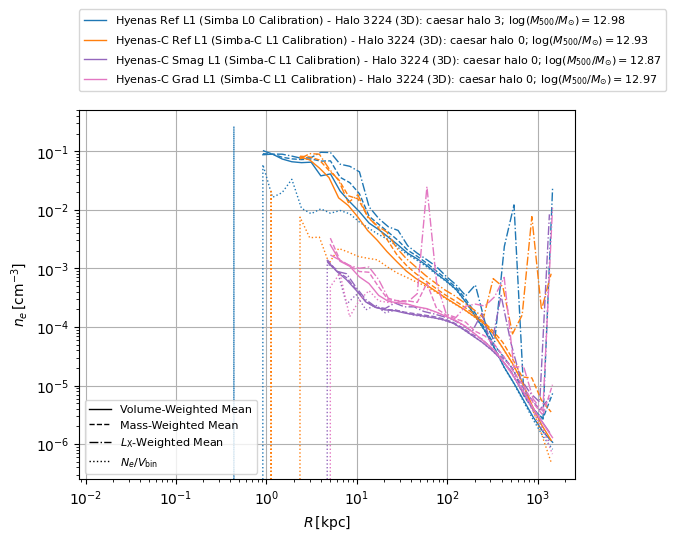

In [68]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ne-volume_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ne-mass_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ne-Lx_0.5-10.0keV_total_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-.',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ne-bin']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$n_e\,[\mathrm{cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'Volume-Weighted Mean', r'Mass-Weighted Mean', r'$L_{\mathrm{X}}$-Weighted Mean', r'$N_e/V_{\mathrm{bin}}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3


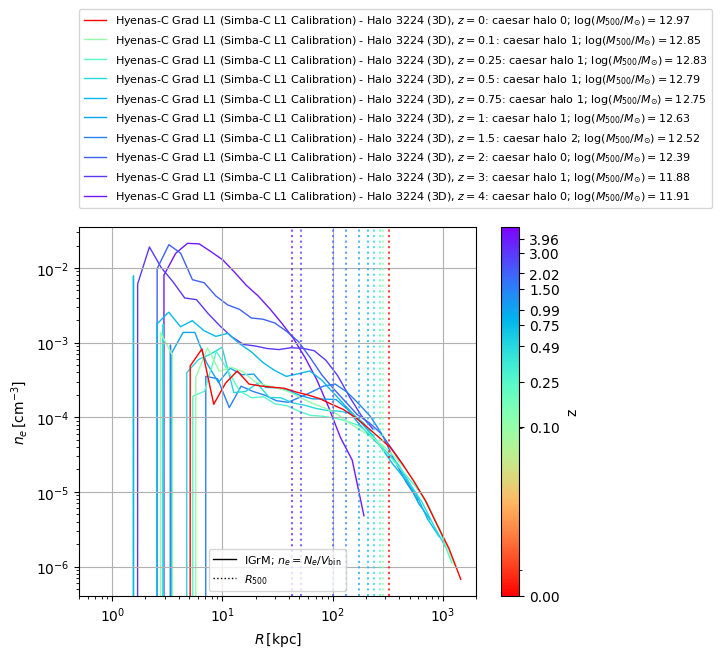

In [465]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'cm**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ne-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$n_e\,[\mathrm{cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'IGrM; $n_e=N_e/V_{\mathrm{bin}}$', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3


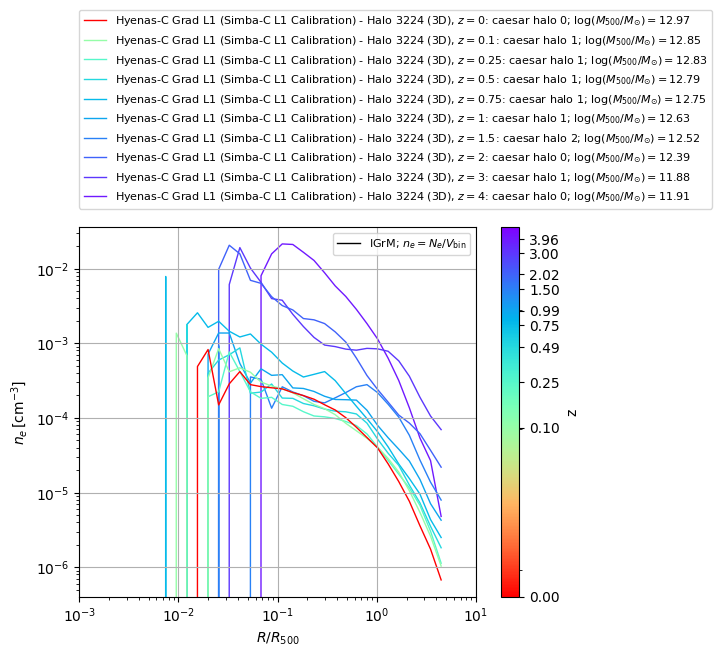

In [466]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'cm**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ne-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$n_e\,[\mathrm{cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'IGrM; $n_e=N_e/V_{\mathrm{bin}}$',],# r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3


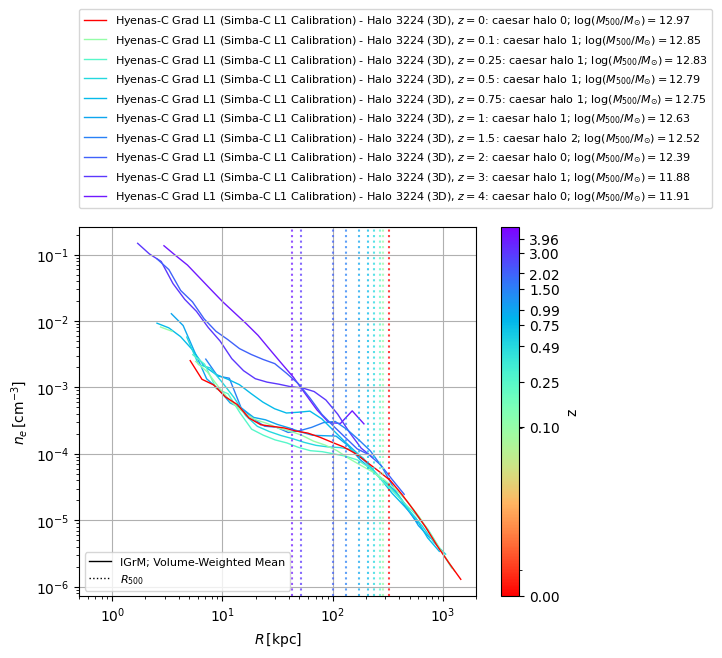

In [467]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'cm**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ne-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$n_e\,[\mathrm{cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'IGrM; Volume-Weighted Mean', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3


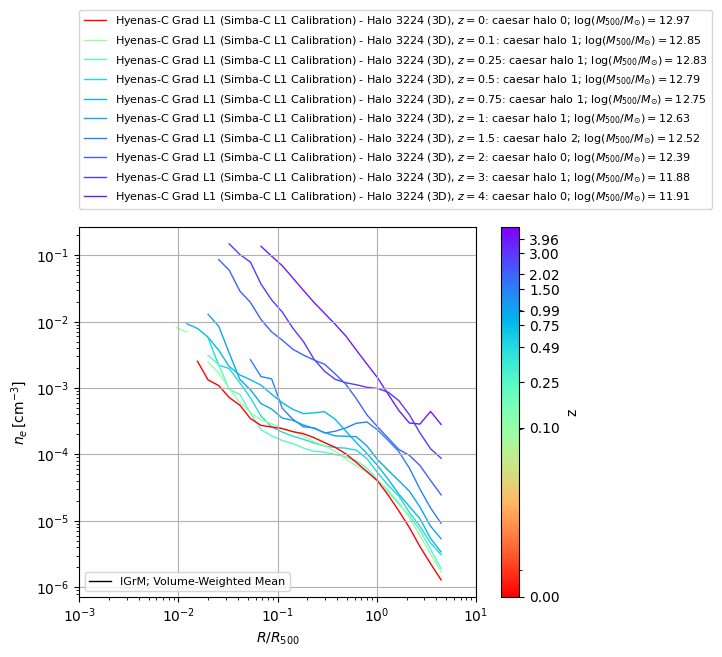

In [468]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'cm**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ne-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$n_e\,[\mathrm{cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'IGrM; Volume-Weighted Mean',],# r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3
cm**-3


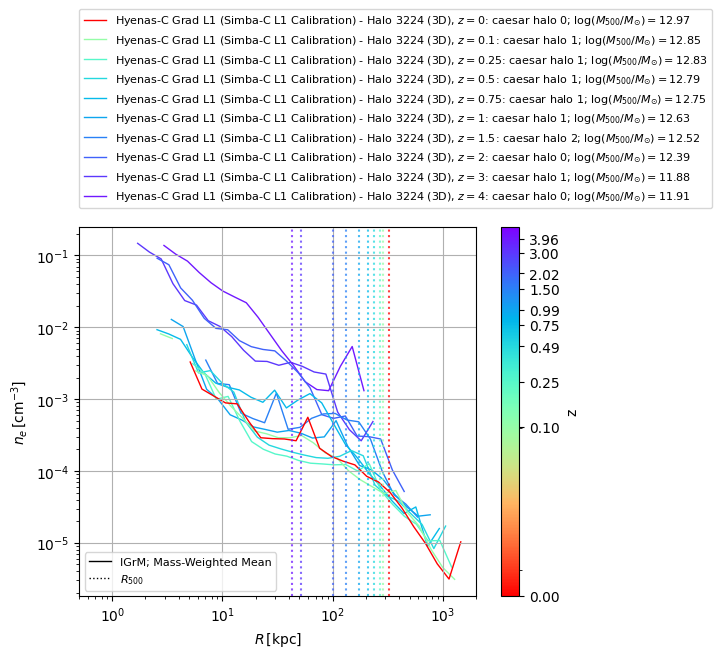

In [469]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'cm**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['ne-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$n_e\,[\mathrm{cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'IGrM; Mass-Weighted Mean', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

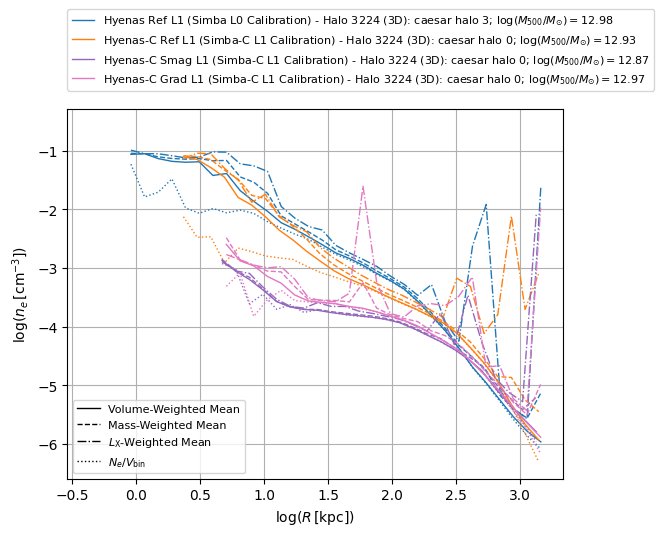

In [69]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['log_physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-volume_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-mass_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-Lx_0.5-10.0keV_total_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-.',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-bin']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')
        
        i += 1

plt.grid()
# plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$\log(R\,[\mathrm{kpc}])$')
plt.ylabel(r'$\log(n_e\,[\mathrm{cm^{-3}}])$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'Volume-Weighted Mean', r'Mass-Weighted Mean', r'$L_{\mathrm{X}}$-Weighted Mean', r'$N_e/V_{\mathrm{bin}}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


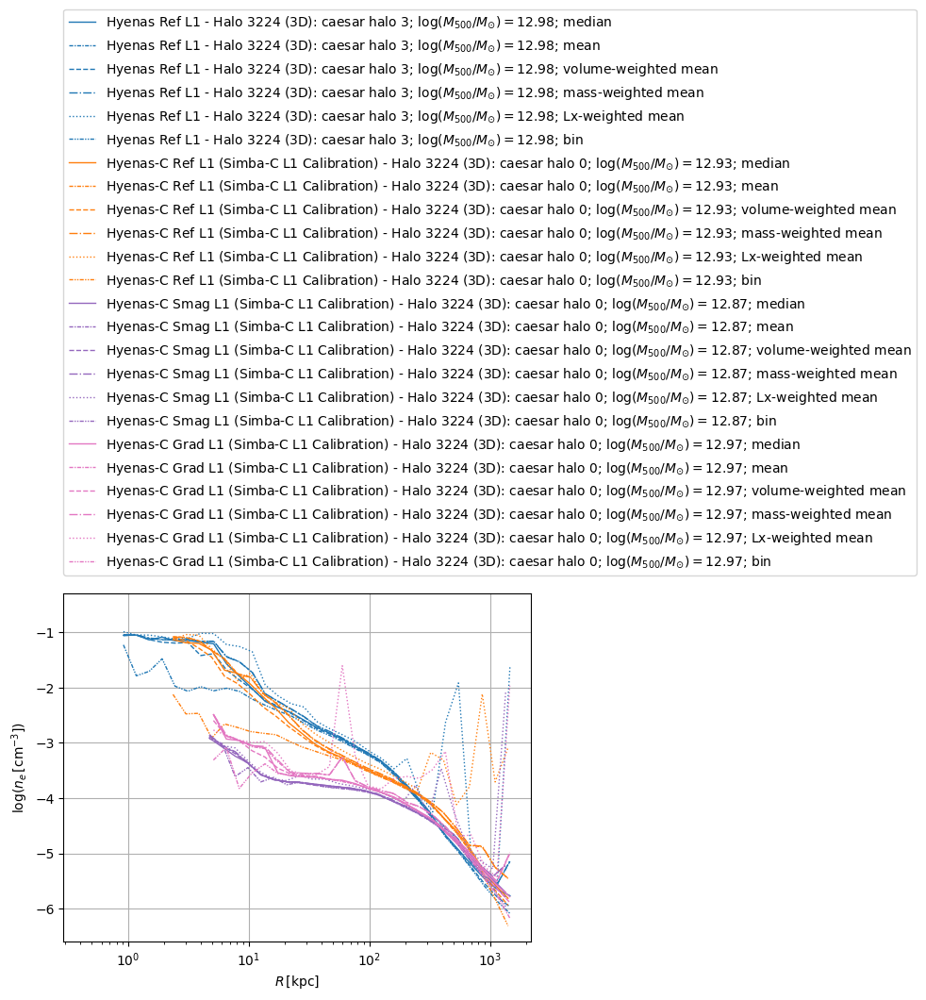

In [286]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-volume_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-mass_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-Lx_0.5-10.0keV_total_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-bin']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; bin')
        
        i += 1

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\log(n_e\,[\mathrm{cm^{-3}}])$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


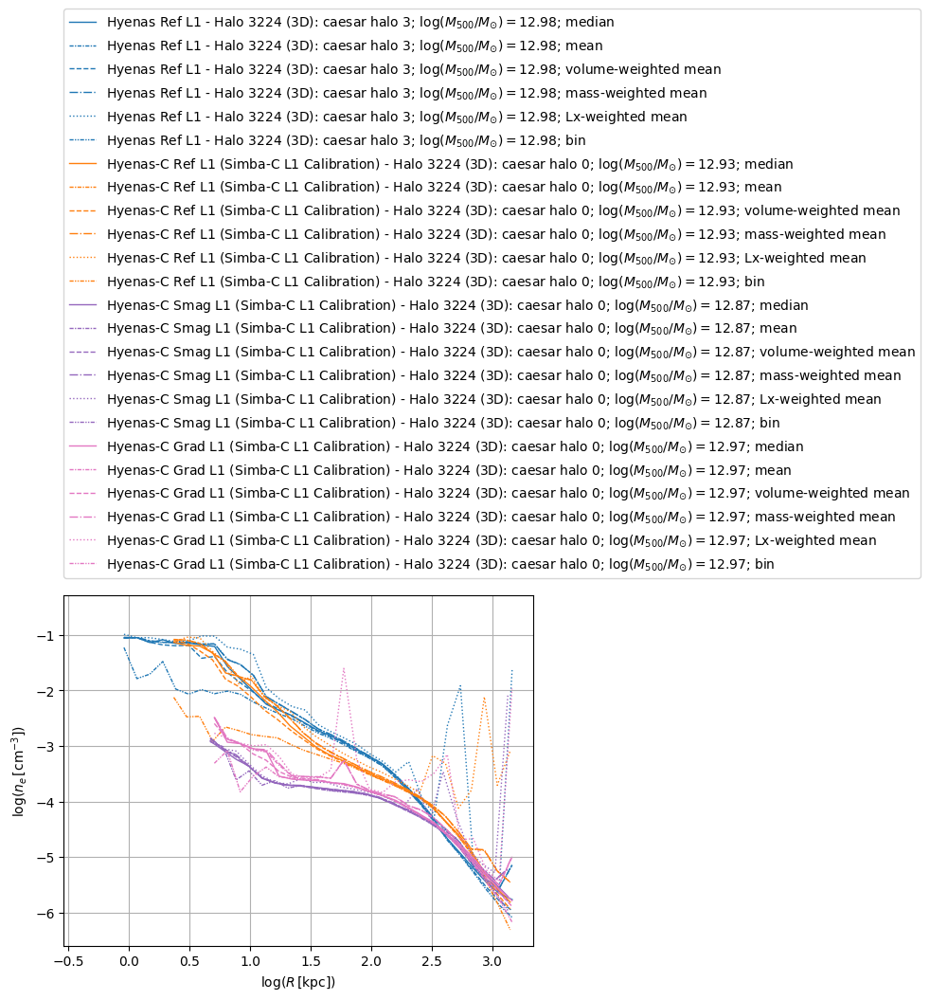

In [287]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['log_physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-volume_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-mass_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-Lx_0.5-10.0keV_total_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-bin']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; bin')
        
        i += 1

plt.grid()
# plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$\log(R\,[\mathrm{kpc}])$')
plt.ylabel(r'$\log(n_e\,[\mathrm{cm^{-3}}])$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


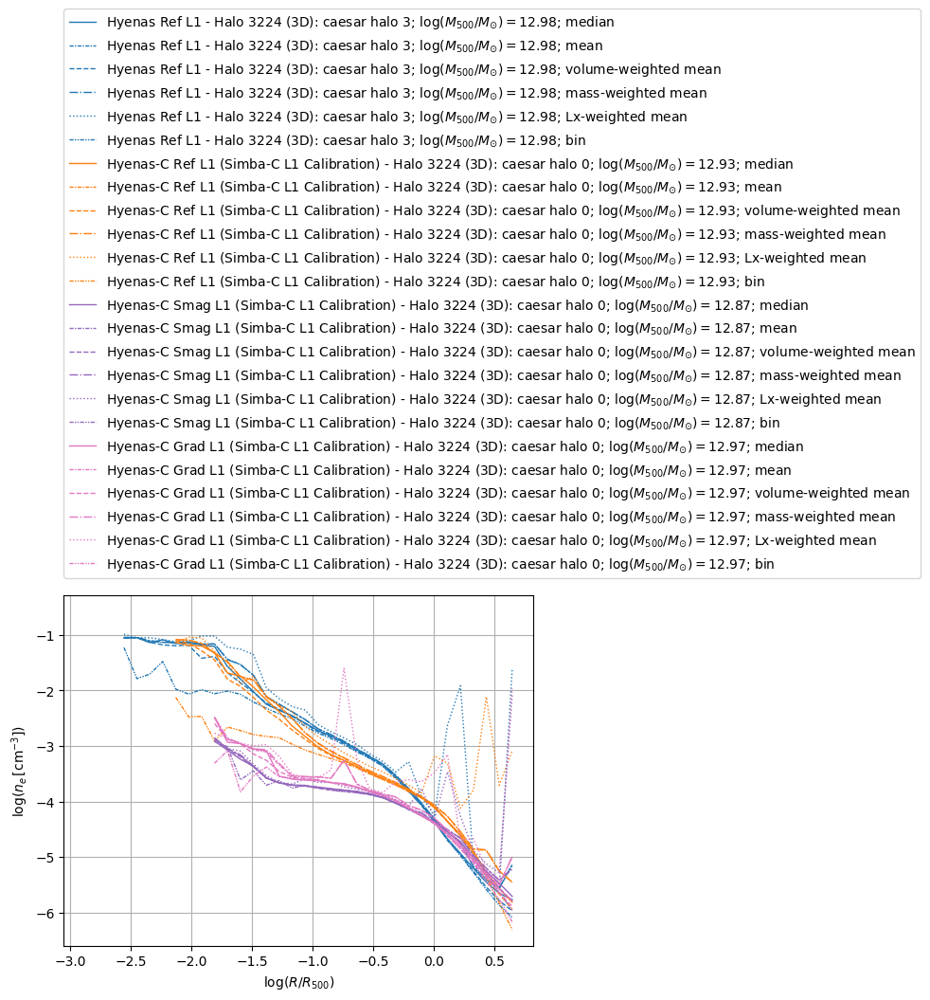

In [288]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['log_rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-volume_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-mass_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-Lx_0.5-10.0keV_total_weighted_mean']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_ne-bin']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; bin')
        
        i += 1

plt.grid()
# plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$\log(R/R_{500})$')
plt.ylabel(r'$\log(n_e\,[\mathrm{cm^{-3}}])$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

## Entropy

cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV


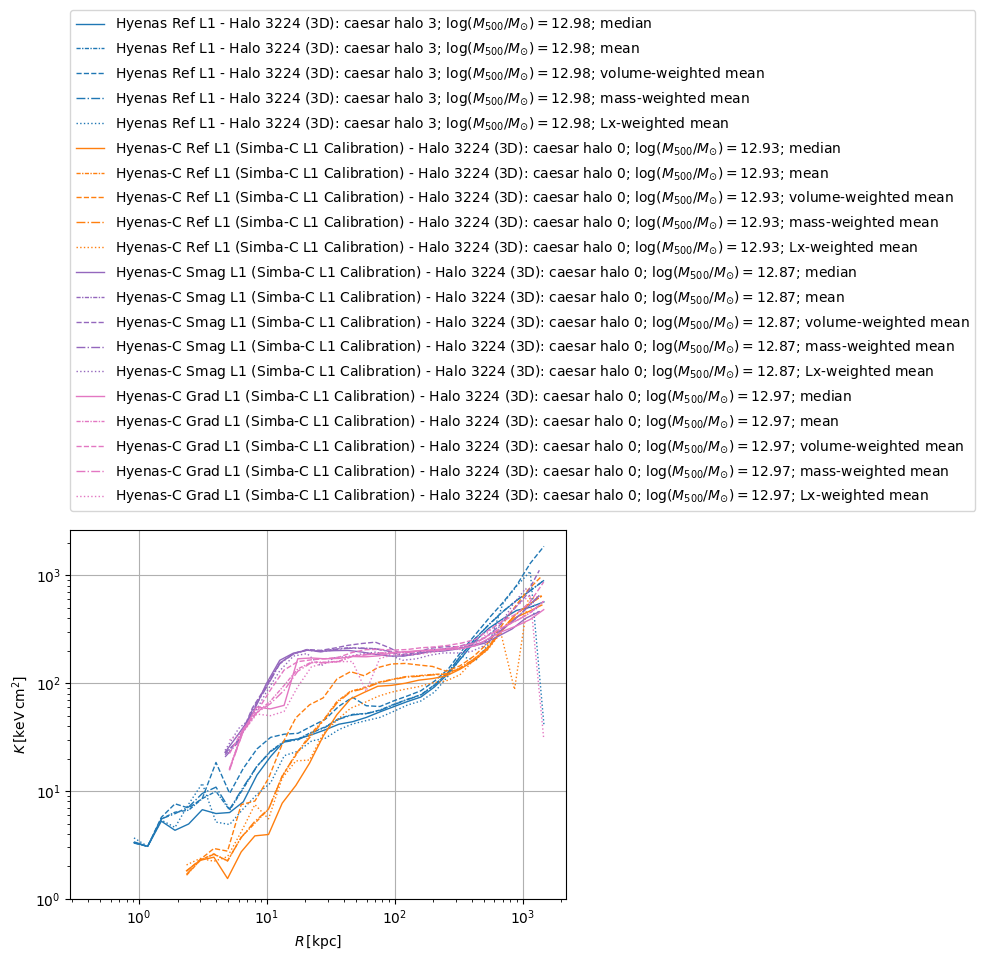

In [289]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-Lx_0.5-10.0keV_total_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx-weighted mean')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-spec']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; spec')

        # y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['K_mass_bin_T']
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; MW bin_T')

        # y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['K_mass_bin_T_ne']
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,10,1,10,1,10)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; MW bin_T_ne')
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV


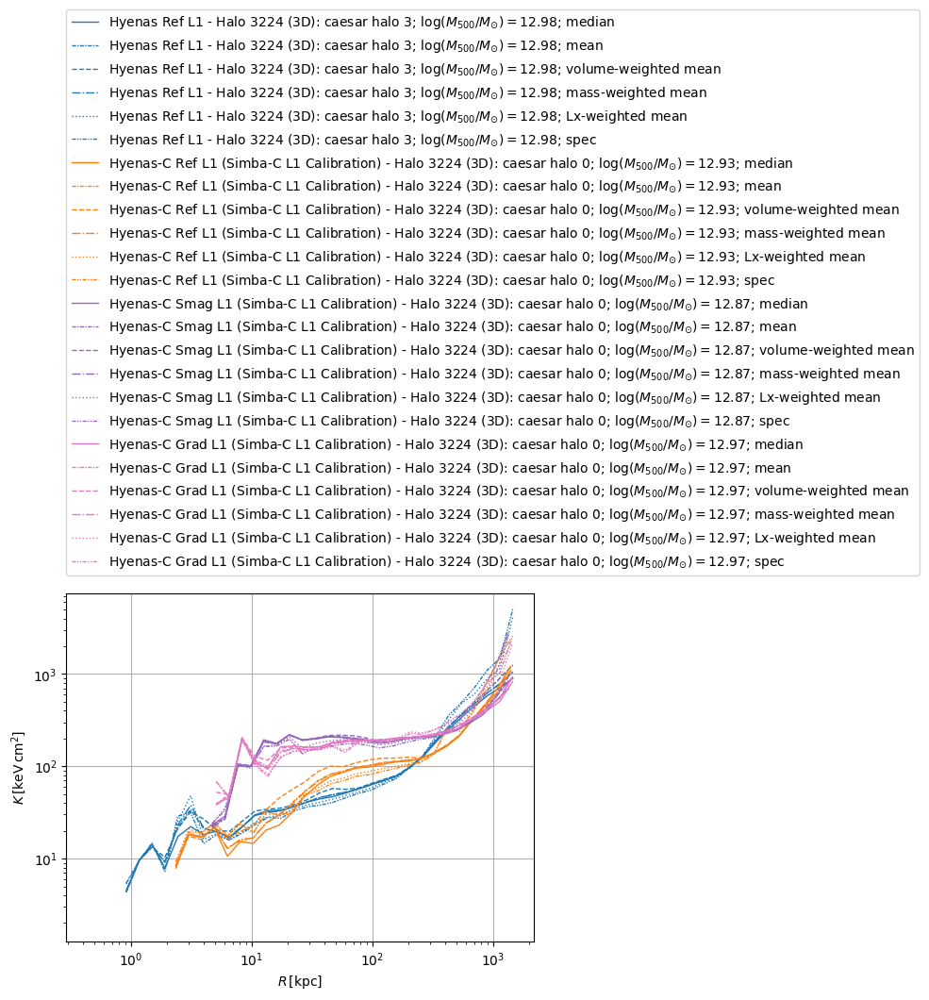

In [290]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-median_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-volume_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-Lx_0.5-10.0keV_total_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-spec_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; spec')

        # y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['K_mass_bin_T']
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; MW bin_T')

        # y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['K_mass_bin_T_ne']
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,10,1,10,1,10)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; MW bin_T_ne')
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV


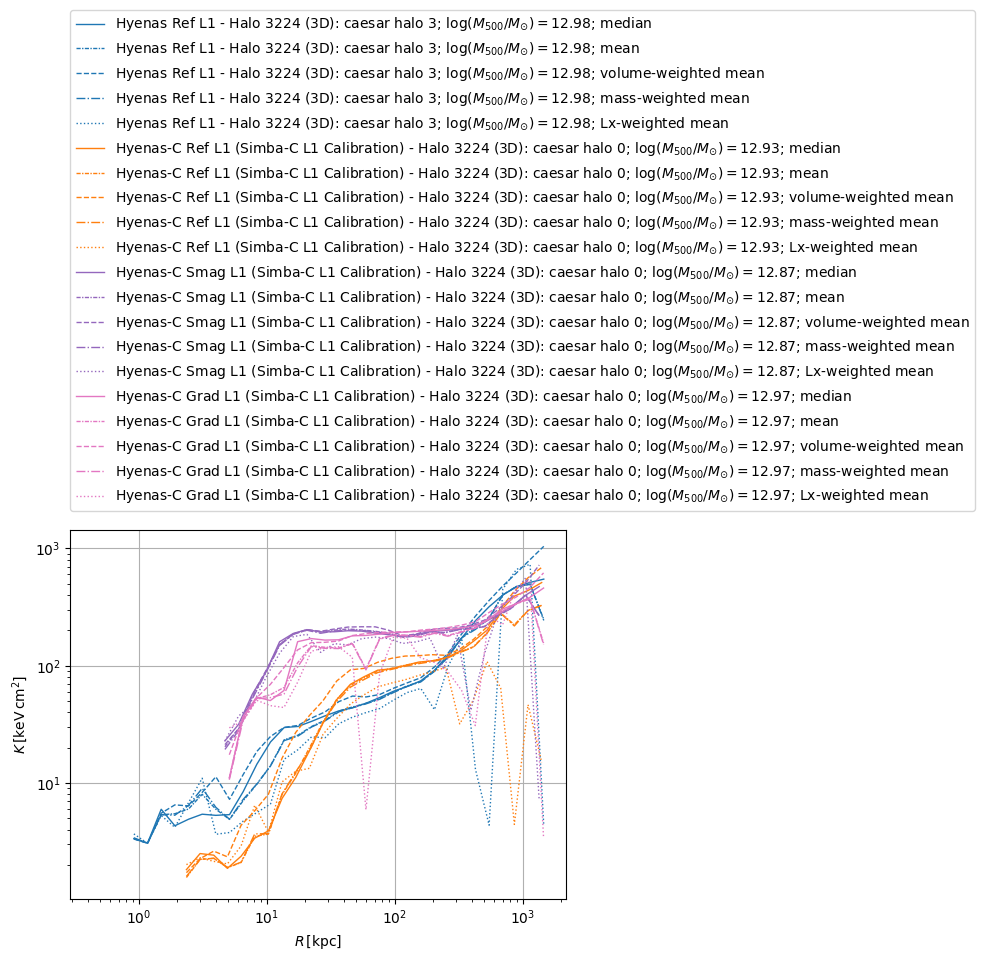

In [291]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-median_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mean_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-volume_weighted_mean_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-Lx_0.5-10.0keV_total_weighted_mean_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx-weighted mean')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-spec_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; spec')

        # y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['K_mass_bin_T']
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; MW bin_T')

        # y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['K_mass_bin_T_ne']
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,10,1,10,1,10)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; MW bin_T_ne')
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV


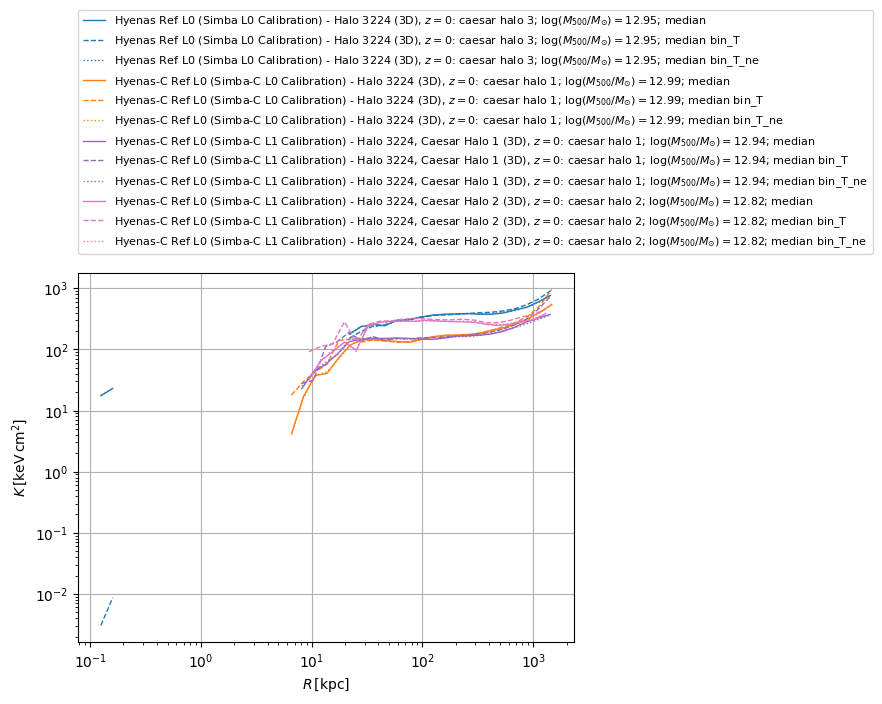

In [17]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-median_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median bin_T')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-median_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median bin_T_ne')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
plt.legend(fontsize=8, loc=(0, 1.05))
plt.show()

cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV


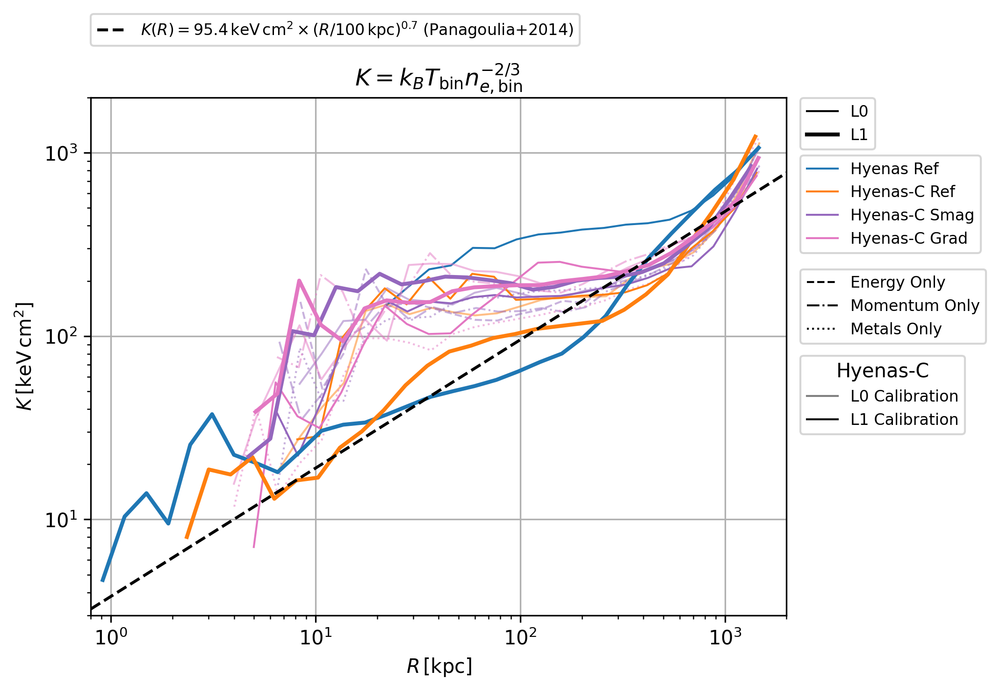

In [96]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0',  # Hyenas Ref L0
              'C1',  # Hyenas-C Ref L0 (L0 Cali)
              'C4', 'C4', 'C4', 'C4',  # Hyenas-C Smag (all, u, v, z) L0 (L0 Cali)
              'C6', 'C6', 'C6',  # Hyenas-C Grad (all, v, z) L0 (L0 Cali)
              'C1', 'C4', 'C6',  # Hyenas-C Ref, Smag, Grad L0 (L1 Cali)
              'C0',  # Hyenas Ref L1
              'C1',  # Hyenas-C Ref L1 (L1 Cali)
              'C4',  # Hyenas-C Smag L1 (L1 Cali)
              'C6',  # Hyenas-C Grad L1 (L1 Cali)
             ]

lw_list = [1,
           1,
           1, 1, 1, 1,
           1, 1, 1,
           1, 1, 1,
           2,
           2,
           2,
           2,
          ]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['-',
           '-',
           '-', '--', '-.', ':',
           '-', '-.', ':',
           '-', '-', '-',
           '-',
           '-',
           '-',
           '-',
          ]

alpha_list = [1,
              0.5,
              0.5, 0.5, 0.5, 0.5,
              0.5, 0.5, 0.5,
              1, 1, 1,
              1,
              1,
              1,
              1,
             ]

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=ls_list[i], alpha=alpha_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(8e-1, 2e3)
plt.ylim(3e0, 2e3)

plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
plt.title(r'$K=k_B T_{\mathrm{bin}} n_{e,\mathrm{bin}}^{-2/3}$')

ax = plt.gca()
fig = plt.gcf()


plot_obs_entropy('panagoulia2014', ax=ax,
                 xscale='physical', xunits='kpc',
                 yscale='physical', yunits='keV cm**2',
                 n_points=2,
                 plot_kwargs={'color':'black', 'ls':'--',
                              'label':r'$K(R)=95.4\,\mathrm{keV\,cm^2}\times(R/100\,\mathrm{kpc})^{0.7}$ (Panagoulia+2014)'})

ax.legend(fontsize=8, loc=(0, 1.1))


leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=2,ls='-',color='black',),],
              labels=['L0', 'L1'],
              fontsize=8, loc=(1.02,0.9))
ax.add_artist(leg2)

leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C0',),
                           Line2D([],[],lw=1,ls='-',color='C1',),
                           Line2D([],[],lw=1,ls='-',color='C4',),
                           Line2D([],[],lw=1,ls='-',color='C6',),],
              labels=['Hyenas Ref', 'Hyenas-C Ref', 'Hyenas-C Smag', 'Hyenas-C Grad'],
              fontsize=8, loc=(1.02,0.7))
ax.add_artist(leg3)

leg4 = Legend(ax, handles=[Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=['Energy Only', 'Momentum Only', 'Metals Only'],
              fontsize=8, loc=(1.02,0.525))
ax.add_artist(leg4)

leg5 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',alpha=0.5,color='black',),
                           Line2D([],[],lw=1,ls='-',alpha=1,color='black',),],
              labels=['L0 Calibration', 'L1 Calibration'],
              title='Hyenas-C',
              fontsize=8, loc=(1.02,0.35))
ax.add_artist(leg5)

fig.set_dpi(300)
plt.show()

In [15]:
list(sim_dict.keys())

['Obsidian N1024L100 (3D), $z=0$']

70605856768.0
11349097709568.0


Obsidian N1024L100 snapshot 051 (3D)
65
64.16968274966347 kpc
18.57862667620866 keV cm**2



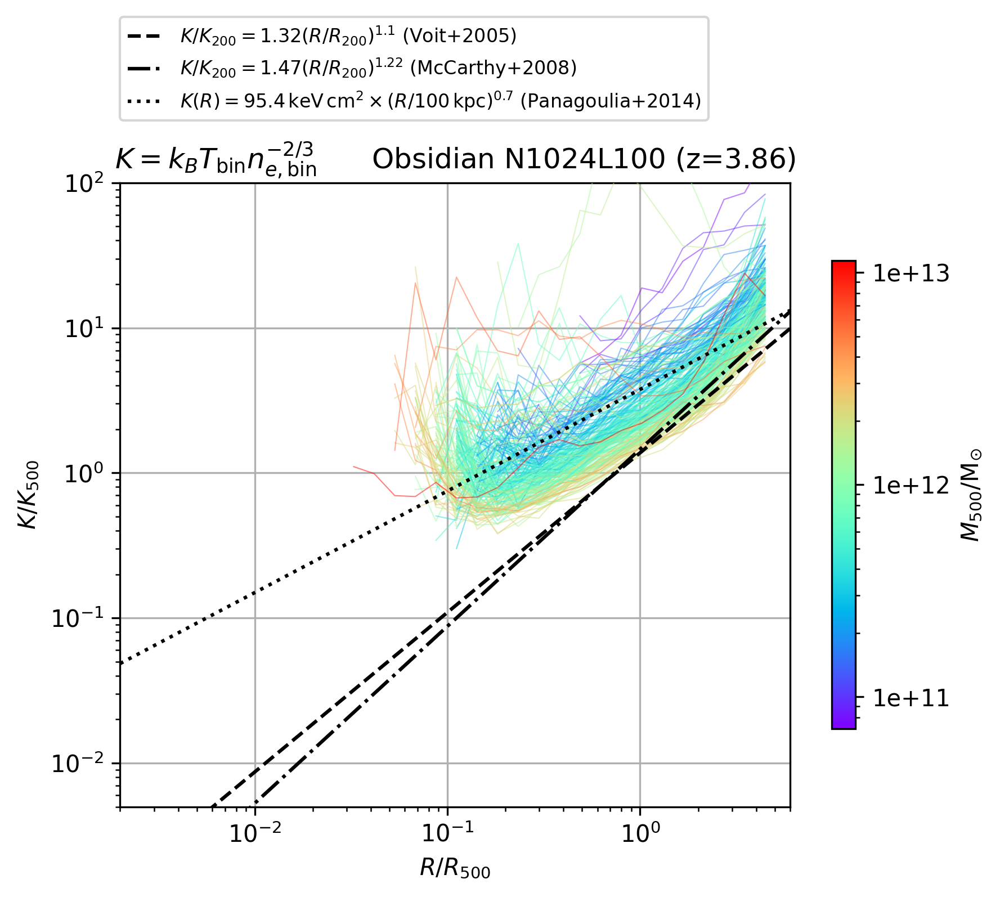

In [34]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0']*9999

lw_list = [0.5]*9999

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['-']*9999

alpha_list = [0.5]*9999

zorder_list = np.linspace(100, 0, 9999)

cmap = plt.get_cmap('rainbow')

m500_values = []
for i, (sim, sim_info) in enumerate(sim_dict.items()):
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        m500_values.append(m500)
m500_values = np.array(m500_values)
m500_min = np.min(m500_values)
m500_max = np.max(m500_values)
print(m500_min)
print(m500_max)
print()

# norm = mcolors.Normalize(vmin=0, vmax=5)
# norm = mcolors.LogNorm(vmin=1e13, vmax=1e15)
norm = mcolors.LogNorm(vmin=m500_min, vmax=m500_max)
# norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

ticks = []

for i, (sim, sim_info) in enumerate(sim_dict.items()):
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for j, halo_id in enumerate(halo_ids):
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        # print(m500)
        # if m500 < pnb.array.SimArray(1e13, units='Msol'): continue
        color = cmap(norm(m500))
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-bin-K500ideal']
        # print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color, lw=lw_list[j], ls=ls_list[j], alpha=alpha_list[j], zorder=zorder_list[j])
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(2e-3, 6e0)
plt.ylim(5e-3, 1e2)

plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$K/K_{500}$')

title = r'$K=k_B T_{\mathrm{bin}} n_{e,\mathrm{bin}}^{-2/3}$'
# title += '\tL0 (Simba-C L0 Calibration)'
# title += '\t(Simba-C L1 Calibration)'

sim0 = list(sim_dict.keys())[0]
z = sim_dict[sim0]['profile']['cosmo_props']['z']
title += f'\tObsidian N1024L100 (z={z:.2f})'
plt.title(title)

ax = plt.gca()
fig = plt.gcf()



plot_obs_entropy_baseline('voit2005', ax=ax, xscale='r500', yscale='k500', n_points=2,
                          plot_kwargs={'color':'black', 'ls':'--', 'zorder':1000,
                                       'label':r'$K/K_{200}=1.32(R/R_{200})^{1.1}$ (Voit+2005)'})
plot_obs_entropy_baseline('mccarthy2008', ax=ax, xscale='r500', yscale='k500', n_points=2,
                          plot_kwargs={'color':'black', 'ls':'-.', 'zorder':1001,
                                       'label':r'$K/K_{200}=1.47(R/R_{200})^{1.22}$ (McCarthy+2008)'})

print()
sim0 = list(sim_dict.keys())[0]
print(sim0)
halo0 = list(sim_dict[sim0]['profile']['halo_info'].keys())[200]
print(halo0)
xscale_value = sim_dict[sim0]['profile']['halo_info'][halo0]['R']['500']
print(xscale_value, xscale_value.units)
yscale_value = sim_dict[sim0]['profile']['halo_info'][halo0]['K']['500ideal']
print(yscale_value, yscale_value.units)
print()
plot_obs_entropy('panagoulia2014', ax=ax,
                 xscale='r500', xunits='1', xscale_value=xscale_value,
                 yscale='k500', yunits='1', yscale_value=yscale_value,
                 n_points=2,
                 plot_kwargs={'color':'black', 'ls':':', 'zorder':1002,
                              'label':r'$K(R)=95.4\,\mathrm{keV\,cm^2}\times(R/100\,\mathrm{kpc})^{0.7}$ (Panagoulia+2014)'})

ax.legend(fontsize=8, loc=(0, 1.1))


# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='--',color='black',),
#                            Line2D([],[],lw=2,ls='-',color='black',),],
#               labels=['L0', 'L1'],
#               title='Resolution', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.85))
# ax.add_artist(leg2)

# leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C0',),
#                            Line2D([],[],lw=1,ls='-',color='C1',),
#                            Line2D([],[],lw=1,ls='-',color='C4',),
#                            Line2D([],[],lw=1,ls='-',color='C6',),],
#               labels=['Hyenas Ref', 'Hyenas-C Ref', 'Hyenas-C Smag', 'Hyenas-C Grad'],
#               title='Sub-Grid Model', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.55))
# ax.add_artist(leg3)
# leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C1',),
#                            Line2D([],[],lw=1,ls='-',color='C4',),
#                            Line2D([],[],lw=1,ls='-',color='C6',),],
#               labels=['Ref', 'Smag', 'Grad'],
#               title='Sub-Grid Model', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.55))
# ax.add_artist(leg3)

# leg4 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',),
#                            Line2D([],[],lw=1,ls='-.',color='black',),
#                            Line2D([],[],lw=1,ls=':',color='black',),],
#               labels=['Full Model', 'Energy Only', 'Momentum Only', 'Metals Only'],
#               title='Turbulent Diffusion', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.25))
# ax.add_artist(leg4)

# leg5 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',alpha=0.5,color='black',),
#                            Line2D([],[],lw=1,ls='-',alpha=1,color='black',),],
#               labels=['L0 Calibration', 'L1 Calibration'],
#               title='Hyenas-C Parameters', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.05))
# ax.add_artist(leg5)


plt.colorbar(mappable=mappable, ax=ax, 
             label=r'$M_{500}/\mathrm{M_{\odot}}$',
             # ticks=z_ticks,
             format='{x:.0e}', pad=0.05, shrink=0.75)

fig.set_dpi(300)
plt.show()

62810984448.0
701510296010752.0


Obsidian N1024L100 snaphsot 150 (3D)
241
10747620884480.0
341.9486694335936 kpc
160.9769348697796 keV cm**2


Obsidian N1024L100 snaphsot 150 (3D)
241
10747620884480.0
341.9486694335936 kpc
160.9769348697796 keV cm**2


Obsidian N1024L100 snaphsot 150 (3D)
241
10747620884480.0
341.9486694335936 kpc
160.9769348697796 keV cm**2


Obsidian N1024L100 snaphsot 150 (3D)
241
10747620884480.0
341.9486694335936 kpc
160.9769348697796 keV cm**2


Obsidian N1024L100 snaphsot 150 (3D)
241
10747620884480.0
341.9486694335936 kpc
160.9769348697796 keV cm**2


Obsidian N1024L100 snaphsot 150 (3D)
241
10747620884480.0
341.9486694335936 kpc
160.9769348697796 keV cm**2


Obsidian N1024L100 snaphsot 150 (3D)
241
10747620884480.0
341.9486694335936 kpc
160.9769348697796 keV cm**2


Obsidian N1024L100 snaphsot 150 (3D)
241
10747620884480.0
341.9486694335936 kpc
160.9769348697796 keV cm**2


Obsidian N1024L100 snaphsot 150 (3D)
241
10747620884480.0
341.9486694335936 kpc
160.97

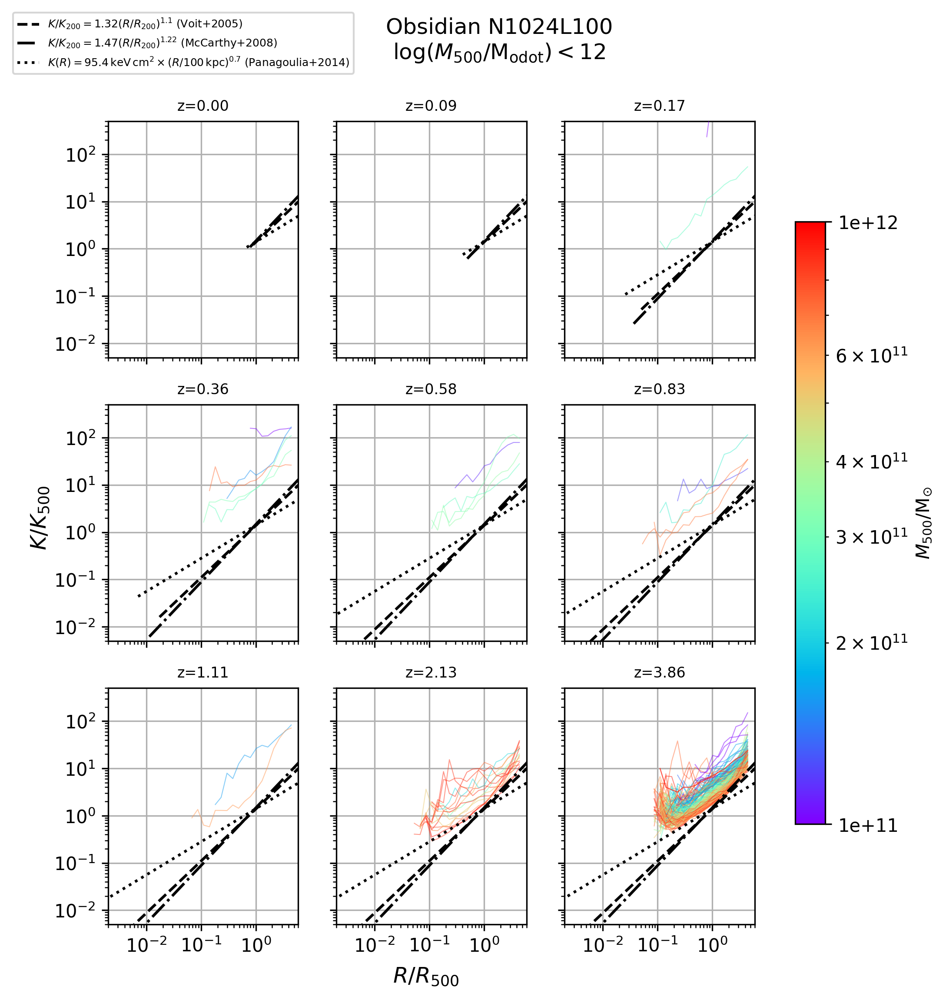

In [29]:
nrows = 3
ncols = 3
sharex = 'all'
sharey = 'all'

fig, axes = plt.subplots(nrows=nrows, ncols=ncols,
                         sharex=sharex, sharey=sharey,
                         figsize=(8,8))#, layout='constrained')
if np.ndim(axes) == 0:
    axes = np.array([[axes]])
elif np.ndim(axes) == 1:
    axes = np.array([axes])



# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0']*9999

lw_list = [0.5]*9999

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['-']*9999

alpha_list = [0.5]*9999

zorder_list = np.linspace(100, 0, 9999)

cmap = plt.get_cmap('rainbow')

m500_values = []
for i, (sim, sim_info) in enumerate(sim_dict.items()):
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        m500_values.append(m500)
m500_values = np.array(m500_values)
m500_min = np.min(m500_values)
m500_max = np.max(m500_values)
print(m500_min)
print(m500_max)
print()

# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.LogNorm(vmin=1e11, vmax=1e12)
# norm = mcolors.LogNorm(vmin=m500_min, vmax=m500_max)
# norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

ticks = []

for i, (ax, (sim, sim_info)) in enumerate(zip(axes.flatten(), sim_dict.items())):
    # print(i, sim)
    ax.grid()
    ax.set_xscale('log')
    ax.set_yscale('log')

    # title = r'$K=k_B T_{\mathrm{bin}} n_{e,\mathrm{bin}}^{-2/3}$'
    # sim0 = list(sim_dict.keys())[0]
    z = sim_info['profile']['cosmo_props']['z']
    # title += f'\tObsidian N1024L100 (z={z:.2f})'
    title = f'z={z:.2f}'
    ax.set_title(title, fontsize=8, wrap=True)

    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for j, halo_id in enumerate(halo_ids):
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        # print(m500)
        # if m500 < pnb.array.SimArray(1e14, units='Msol'): continue
        if m500 >= pnb.array.SimArray(1e12, units='Msol'): continue
        # if m500 < pnb.array.SimArray(1e12, units='Msol') or m500 >= pnb.array.SimArray(1e13, units='Msol'): continue
        
        color = cmap(norm(m500))
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-bin-K500ideal']
        # print(y_profile.units)
        ax.plot(x_profile, y_profile,
                color=color, lw=lw_list[j], ls=ls_list[j], alpha=alpha_list[j], zorder=zorder_list[j])
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # i += 1


    plot_obs_entropy_baseline('voit2005', ax=ax, xscale='r500', yscale='k500', n_points=2,
                              plot_kwargs={'color':'black', 'ls':'--', 'zorder':1000,
                                           'label':r'$K/K_{200}=1.32(R/R_{200})^{1.1}$ (Voit+2005)'})
    plot_obs_entropy_baseline('mccarthy2008', ax=ax, xscale='r500', yscale='k500', n_points=2,
                              plot_kwargs={'color':'black', 'ls':'-.', 'zorder':1001,
                                           'label':r'$K/K_{200}=1.47(R/R_{200})^{1.22}$ (McCarthy+2008)'})
    
    print()
    sim0 = list(sim_dict.keys())[0]
    print(sim0)
    halo0 = list(sim_dict[sim0]['profile']['halo_info'].keys())[200]
    print(halo0)
    print(sim_dict[sim0]['profile']['halo_info'][halo0]['M']['500'])
    xscale_value = sim_dict[sim0]['profile']['halo_info'][halo0]['R']['500']
    print(xscale_value, xscale_value.units)
    yscale_value = sim_dict[sim0]['profile']['halo_info'][halo0]['K']['500ideal']
    print(yscale_value, yscale_value.units)
    print()
    plot_obs_entropy('panagoulia2014', ax=ax,
                     xscale='r500', xunits='1', xscale_value=xscale_value,
                     yscale='k500', yunits='1', yscale_value=yscale_value,
                     n_points=2,
                     plot_kwargs={'color':'black', 'ls':':', 'zorder':1002,
                                  'label':r'$K(R)=95.4\,\mathrm{keV\,cm^2}\times(R/100\,\mathrm{kpc})^{0.7}$ (Panagoulia+2014)'})

# plt.grid()
# plt.xscale('log')
# plt.yscale('log')

fig.supxlabel(r'$R/R_{500}$', x=0.43, y=0.05)
fig.supylabel(r'$K/K_{500}$', x=0.05)
plt.xlim(2e-3, 6e0)
plt.ylim(5e-3, 5e2)

# title = r'$K=k_B T_{\mathrm{bin}} n_{e,\mathrm{bin}}^{-2/3}$'
# # title += '\tL0 (Simba-C L0 Calibration)'
# # title += '\t(Simba-C L1 Calibration)'

# sim0 = list(sim_dict.keys())[0]
# z = sim_dict[sim0]['profile']['cosmo_props']['z']
title = f'Obsidian N1024L100\n'
# title += r' ($\log(M_{500}/\mathrm{M_{odot}}) \geq 14$)'
title += r'$\log(M_{500}/\mathrm{M_{odot}}) < 12$'
# title += r'$11 \leq \log(M_{500}/\mathrm{M_{odot}}) < 12$'
# plt.title(title)
fig.suptitle(title)

# ax = plt.gca()
# fig = plt.gcf()





# ax.legend(fontsize=8, loc=(0, 1.1))
axes[0,0].legend(fontsize=6, loc=(-0.5, 1.2))


# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='--',color='black',),
#                            Line2D([],[],lw=2,ls='-',color='black',),],
#               labels=['L0', 'L1'],
#               title='Resolution', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.85))
# ax.add_artist(leg2)

# leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C0',),
#                            Line2D([],[],lw=1,ls='-',color='C1',),
#                            Line2D([],[],lw=1,ls='-',color='C4',),
#                            Line2D([],[],lw=1,ls='-',color='C6',),],
#               labels=['Hyenas Ref', 'Hyenas-C Ref', 'Hyenas-C Smag', 'Hyenas-C Grad'],
#               title='Sub-Grid Model', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.55))
# ax.add_artist(leg3)
# leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C1',),
#                            Line2D([],[],lw=1,ls='-',color='C4',),
#                            Line2D([],[],lw=1,ls='-',color='C6',),],
#               labels=['Ref', 'Smag', 'Grad'],
#               title='Sub-Grid Model', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.55))
# ax.add_artist(leg3)

# leg4 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',),
#                            Line2D([],[],lw=1,ls='-.',color='black',),
#                            Line2D([],[],lw=1,ls=':',color='black',),],
#               labels=['Full Model', 'Energy Only', 'Momentum Only', 'Metals Only'],
#               title='Turbulent Diffusion', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.25))
# ax.add_artist(leg4)

# leg5 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',alpha=0.5,color='black',),
#                            Line2D([],[],lw=1,ls='-',alpha=1,color='black',),],
#               labels=['L0 Calibration', 'L1 Calibration'],
#               title='Hyenas-C Parameters', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.05))
# ax.add_artist(leg5)


plt.colorbar(mappable=mappable, ax=axes[:], 
             label=r'$M_{500}/\mathrm{M_{\odot}}$',
             # ticks=z_ticks,
             format='{x:.0e}', pad=0.05, shrink=0.75)

fig.set_dpi(300)
plt.show()

1.00e+00
1.00e+00

Hyenas-C Ref L1 (Simba-C L1 Calibration; $M_{\mathrm{BH,seed}}=10^4\,\mathrm{M_{\odot}/h}$) - Halo 3224 (3D), $z=0$
0
315.8504638671874 kpc
137.33826129411705 keV cm**2



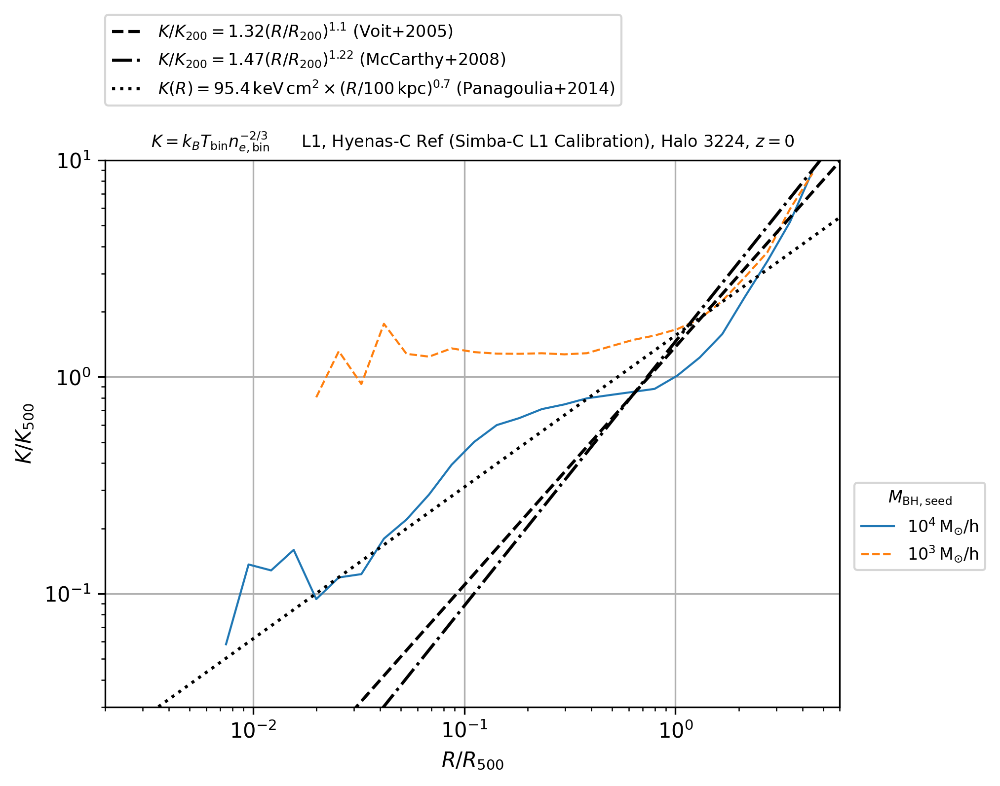

In [14]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C1', 'C4', 'C6']

# lw_list = [2, 1, 2, 1, 1]
lw_list = [1, 1]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['-', '--', '-', '--', '--']

alpha_list = [1, 1, 1, 1, 1]
# alpha_list = [1,
#               1,
#               # 1,1,1,1,
#               # 1,1,1,
#               1,# 1, 1,
#               1,
#               1,
#               # 1,
#               # 1,
#              ]

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-bin-K500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=ls_list[i], alpha=alpha_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(2e-3, 6e0)
plt.ylim(3e-2, 1e1)

plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$K/K_{500}$')

title = r'$K=k_B T_{\mathrm{bin}} n_{e,\mathrm{bin}}^{-2/3}$'
# title += '\tL0 (Simba-C L0 Calibration)'
# title += '\t(Simba-C L1 Calibration)'
title += '\tL1, Hyenas-C Ref (Simba-C L1 Calibration), Halo 3224, $z=0$'
plt.title(title, fontsize=8)

ax = plt.gca()
fig = plt.gcf()



plot_obs_entropy_baseline('voit2005', ax=ax, xscale='r500', yscale='k500', n_points=2,
                          plot_kwargs={'color':'black', 'ls':'--',
                                       'label':r'$K/K_{200}=1.32(R/R_{200})^{1.1}$ (Voit+2005)'})
plot_obs_entropy_baseline('mccarthy2008', ax=ax, xscale='r500', yscale='k500', n_points=2,
                          plot_kwargs={'color':'black', 'ls':'-.',
                                       'label':r'$K/K_{200}=1.47(R/R_{200})^{1.22}$ (McCarthy+2008)'})

print()
sim0 = list(sim_dict.keys())[0]
print(sim0)
halo0 = list(sim_dict[sim0]['profile']['halo_info'].keys())[0]
print(halo0)
xscale_value = sim_dict[sim0]['profile']['halo_info'][halo0]['R']['500']
print(xscale_value, xscale_value.units)
yscale_value = sim_dict[sim0]['profile']['halo_info'][halo0]['K']['500ideal']
print(yscale_value, yscale_value.units)
print()
plot_obs_entropy('panagoulia2014', ax=ax,
                 xscale='r500', xunits='1', xscale_value=xscale_value,
                 yscale='k500', yunits='1', yscale_value=yscale_value,
                 n_points=2,
                 plot_kwargs={'color':'black', 'ls':':',
                              'label':r'$K(R)=95.4\,\mathrm{keV\,cm^2}\times(R/100\,\mathrm{kpc})^{0.7}$ (Panagoulia+2014)'})

ax.legend(fontsize=8, loc=(0, 1.1))


# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=2,ls='-',color='black',),],
#               labels=['L0', 'L1'],
#               title='Resolution', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.85))
# ax.add_artist(leg2)

# leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C0',),
#                            Line2D([],[],lw=1,ls='-',color='C1',),
#                            Line2D([],[],lw=1,ls='-',color='C4',),
#                            Line2D([],[],lw=1,ls='-',color='C6',),
#                           ],
#               labels=['Hyenas Ref\n(Simba L0 Calibration)',
#                       'Hyenas-C Ref\n(Simba-C L1 Calibration)',
#                       'Hyenas-C Smag\n(Simba-C L1 Calibration)',
#                       'Hyenas-C Grad\n(Simba-C L1 Calibration)',
#                      ],
#                   # r'$M_{\mathrm{BH,seed}}=10^4\,\mathrm{M_{\odot}/h}$',
#                   #     r'$M_{\mathrm{BH,seed}}=10^3\,\mathrm{M_{\odot}/h}$',],# 'Hyenas-C Smag', 'Hyenas-C Grad'],
#               title='Sub-Grid Model', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.55))
# ax.add_artist(leg3)

leg4 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C0',),
                           Line2D([],[],lw=1,ls='--',color='C1',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                          ],
              labels=[
                  r'$10^4\,\mathrm{M_{\odot}/h}$',
                  r'$10^3\,\mathrm{M_{\odot}/h}$',
              ],
              title=r'$M_{\mathrm{BH,seed}}$', title_fontsize=8,
              fontsize=8, loc=(1.02,0.25))
ax.add_artist(leg4)

# leg5 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',alpha=0.5,color='black',),
#                            Line2D([],[],lw=1,ls='-',alpha=1,color='black',),],
#               labels=['L0 Calibration', 'L1 Calibration'],
#               title='Hyenas-C Parameters', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.05))
# ax.add_artist(leg5)


fig.set_dpi(300)
plt.show()

cm**2 keV
cm**2 keV

Hyenas-C Ref L1 (Simba-C L1 Calibration; $M_{\mathrm{BH,seed}}=10^4\,\mathrm{M_{\odot}/h}$) - Halo 3224 (3D), $z=0$
0
315.8504638671874 kpc
1 1.00e+00



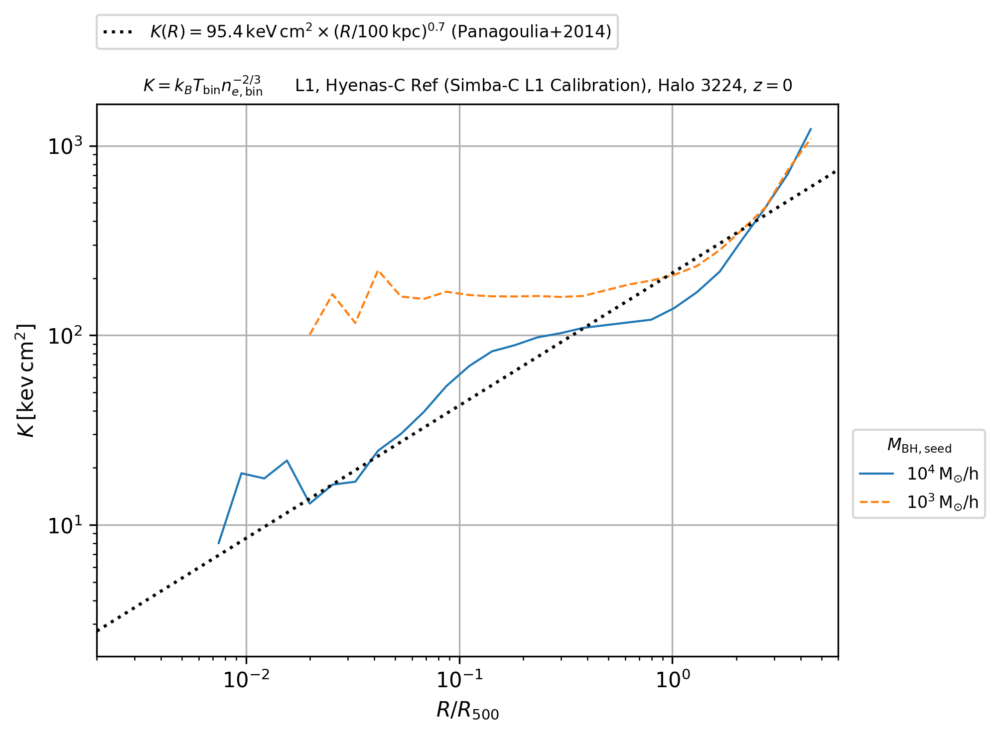

In [15]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C1', 'C4', 'C6']

# lw_list = [2, 1, 2, 1, 1]
lw_list = [1, 1]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['-', '--', '-', '--', '--']

alpha_list = [1, 1, 1, 1, 1]
# alpha_list = [1,
#               1,
#               # 1,1,1,1,
#               # 1,1,1,
#               1,# 1, 1,
#               1,
#               1,
#               # 1,
#               # 1,
#              ]

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=ls_list[i], alpha=alpha_list[i],)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(2e-3, 6e0)
# plt.ylim(3e-2, 1e1)

plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$K\,[\mathrm{kev\,cm^2}]$')

title = r'$K=k_B T_{\mathrm{bin}} n_{e,\mathrm{bin}}^{-2/3}$'
# title += '\tL0 (Simba-C L0 Calibration)'
# title += '\t(Simba-C L1 Calibration)'
title += '\tL1, Hyenas-C Ref (Simba-C L1 Calibration), Halo 3224, $z=0$'
plt.title(title, fontsize=8)

ax = plt.gca()
fig = plt.gcf()



# plot_obs_entropy_baseline('voit2005', ax=ax, xscale='r500', yscale='k500', n_points=2,
#                           plot_kwargs={'color':'black', 'ls':'--',
#                                        'label':r'$K/K_{200}=1.32(R/R_{200})^{1.1}$ (Voit+2005)'})
# plot_obs_entropy_baseline('mccarthy2008', ax=ax, xscale='r500', yscale='k500', n_points=2,
#                           plot_kwargs={'color':'black', 'ls':'-.',
#                                        'label':r'$K/K_{200}=1.47(R/R_{200})^{1.22}$ (McCarthy+2008)'})

print()
sim0 = list(sim_dict.keys())[0]
print(sim0)
halo0 = list(sim_dict[sim0]['profile']['halo_info'].keys())[0]
print(halo0)
xscale_value = sim_dict[sim0]['profile']['halo_info'][halo0]['R']['500']
print(xscale_value, xscale_value.units)
yscale_value = pnb.array.SimArray(1, units='1')
print(yscale_value, yscale_value.units)
print()
plot_obs_entropy('panagoulia2014', ax=ax,
                 xscale='r500', xunits='1', xscale_value=xscale_value,
                 yscale='physical', yunits='keV cm**2', yscale_value=yscale_value,
                 n_points=2,
                 plot_kwargs={'color':'black', 'ls':':',
                              'label':r'$K(R)=95.4\,\mathrm{keV\,cm^2}\times(R/100\,\mathrm{kpc})^{0.7}$ (Panagoulia+2014)'})

ax.legend(fontsize=8, loc=(0, 1.1))


# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=2,ls='-',color='black',),],
#               labels=['L0', 'L1'],
#               title='Resolution', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.85))
# ax.add_artist(leg2)

# leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C0',),
#                            Line2D([],[],lw=1,ls='-',color='C1',),
#                            Line2D([],[],lw=1,ls='-',color='C4',),
#                            Line2D([],[],lw=1,ls='-',color='C6',),
#                           ],
#               labels=['Hyenas Ref\n(Simba L0 Calibration)',
#                       'Hyenas-C Ref\n(Simba-C L1 Calibration)',
#                       'Hyenas-C Smag\n(Simba-C L1 Calibration)',
#                       'Hyenas-C Grad\n(Simba-C L1 Calibration)',
#                      ],
#                   # r'$M_{\mathrm{BH,seed}}=10^4\,\mathrm{M_{\odot}/h}$',
#                   #     r'$M_{\mathrm{BH,seed}}=10^3\,\mathrm{M_{\odot}/h}$',],# 'Hyenas-C Smag', 'Hyenas-C Grad'],
#               title='Sub-Grid Model', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.55))
# ax.add_artist(leg3)

leg4 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C0',),
                           Line2D([],[],lw=1,ls='--',color='C1',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                          ],
              labels=[
                  r'$10^4\,\mathrm{M_{\odot}/h}$',
                  r'$10^3\,\mathrm{M_{\odot}/h}$',
              ],
              title=r'$M_{\mathrm{BH,seed}}$', title_fontsize=8,
              fontsize=8, loc=(1.02,0.25))
ax.add_artist(leg4)

# leg5 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',alpha=0.5,color='black',),
#                            Line2D([],[],lw=1,ls='-',alpha=1,color='black',),],
#               labels=['L0 Calibration', 'L1 Calibration'],
#               title='Hyenas-C Parameters', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.05))
# ax.add_artist(leg5)


fig.set_dpi(300)
plt.show()

cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV


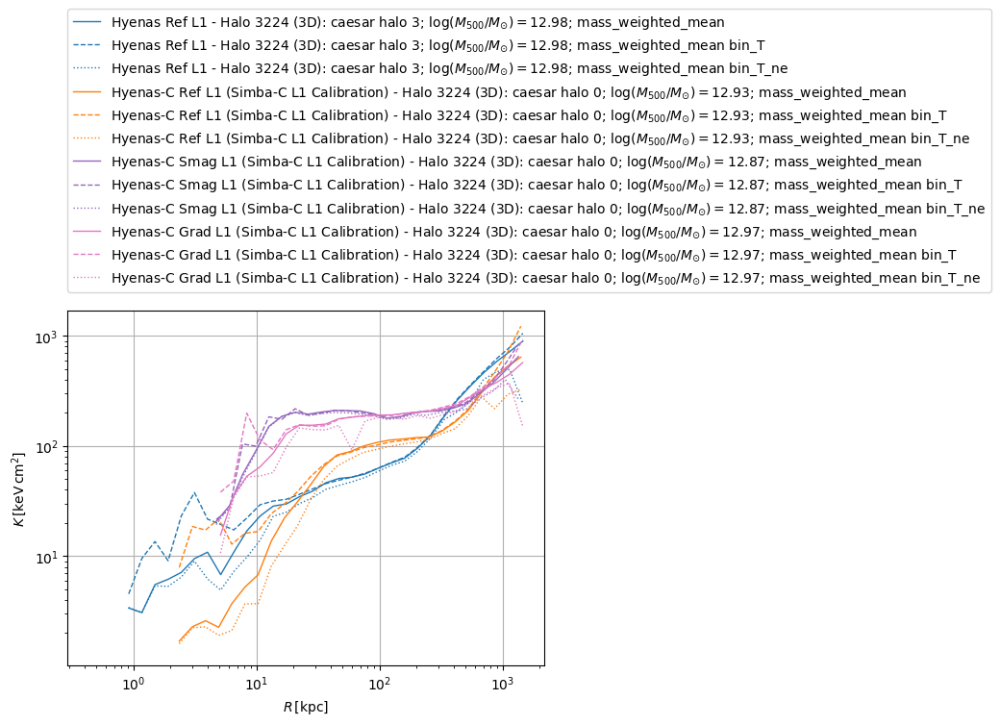

In [293]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T_ne')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV


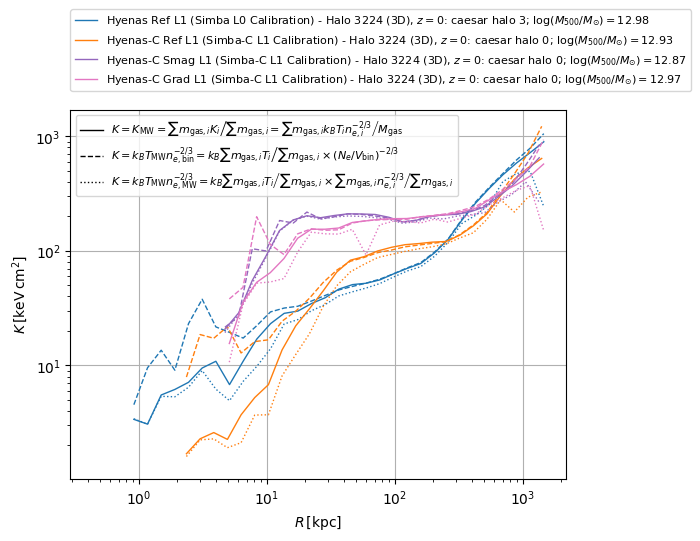

In [7]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T_ne')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'$K=K_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} K_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i}^{-2/3} \middle/ M_{\mathrm{gas}} \right.$',
                      r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{bin}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}})^{-2/3} \right.$',
                      r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i}^{-2/3} \middle/ \sum m_{\mathrm{gas},i} \right.$',],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

cm**2 keV


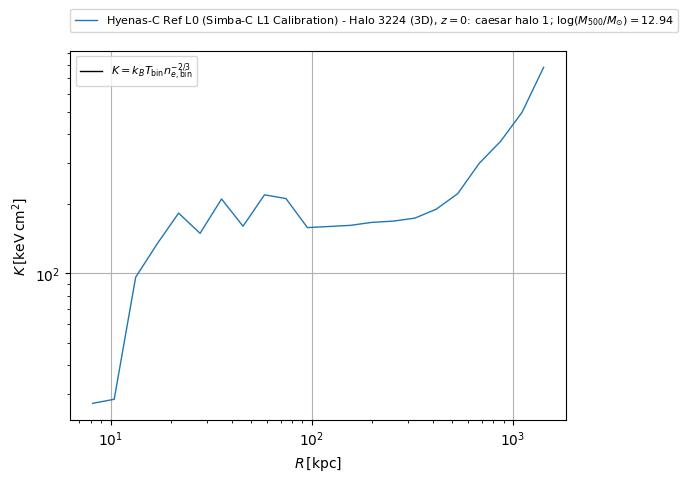

In [53]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls='--',)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=':',)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T_ne')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',)
                          ],
              labels=[
                  # r'$K=K_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} K_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i}^{-2/3} \middle/ M_{\mathrm{gas}} \right.$',
                      r'$K=k_B T_{\mathrm{bin}} n_{e,\mathrm{bin}}^{-2/3}$',
                      # r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i}^{-2/3} \middle/ \sum m_{\mathrm{gas},i} \right.$',
                     ],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


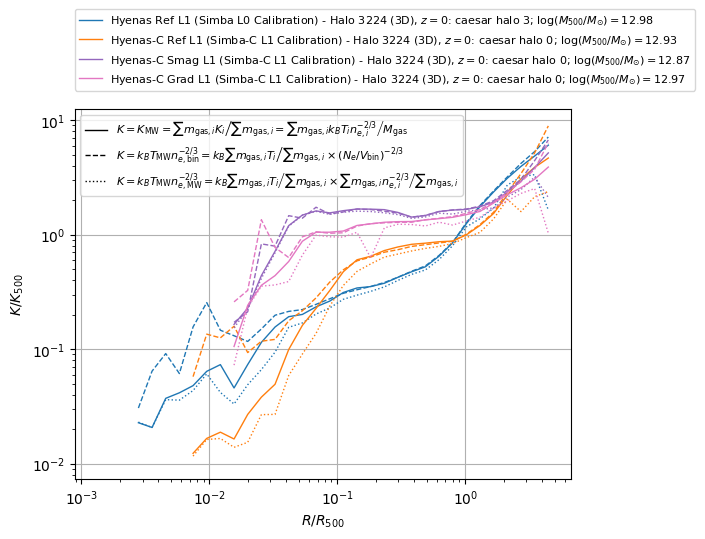

In [8]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean-K500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T-K500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T_ne-K500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T_ne')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$K/K_{500}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'$K=K_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} K_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i}^{-2/3} \middle/ M_{\mathrm{gas}} \right.$',
                      r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{bin}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}})^{-2/3} \right.$',
                      r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i}^{-2/3} \middle/ \sum m_{\mathrm{gas},i} \right.$',],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

1.00e+00


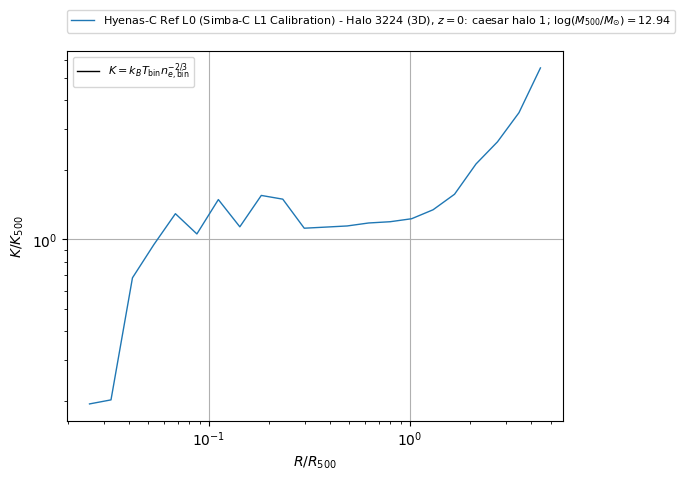

In [54]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-bin-K500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T-K500ideal']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls='--',)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T_ne-K500ideal']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=':',)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T_ne')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$K/K_{500}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',)
                          ],
              labels=[
                  # r'$K=K_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} K_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i}^{-2/3} \middle/ M_{\mathrm{gas}} \right.$',
                      r'$K=k_B T_{\mathrm{bin}} n_{e,\mathrm{bin}}^{-2/3}$',
                      # r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i}^{-2/3} \middle/ \sum m_{\mathrm{gas},i} \right.$',
              ],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV


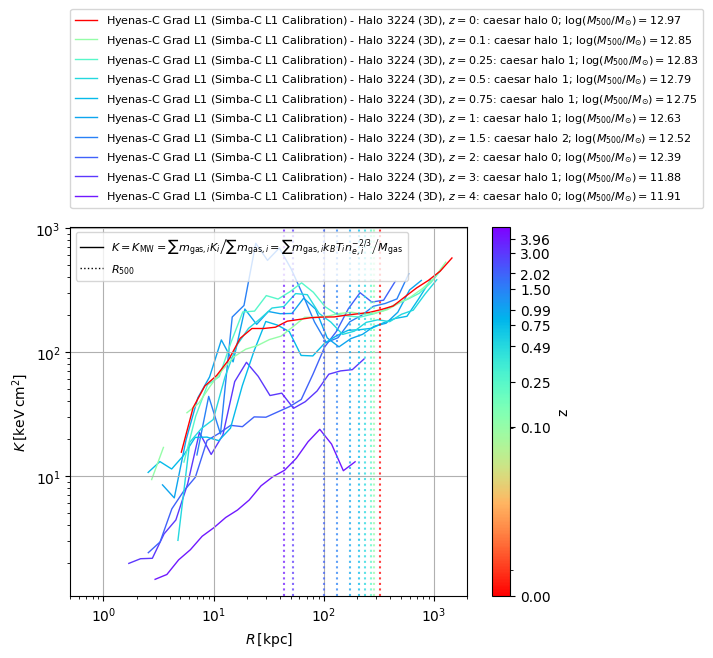

In [470]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV cm**2'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-.', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[r'$K=K_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} K_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i}^{-2/3} \middle/ M_{\mathrm{gas}} \right.$',
                      # r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{bin}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}})^{-2/3} \right.$',
                      # r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i}^{-2/3} \middle/ \sum m_{\mathrm{gas},i} \right.$',
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV


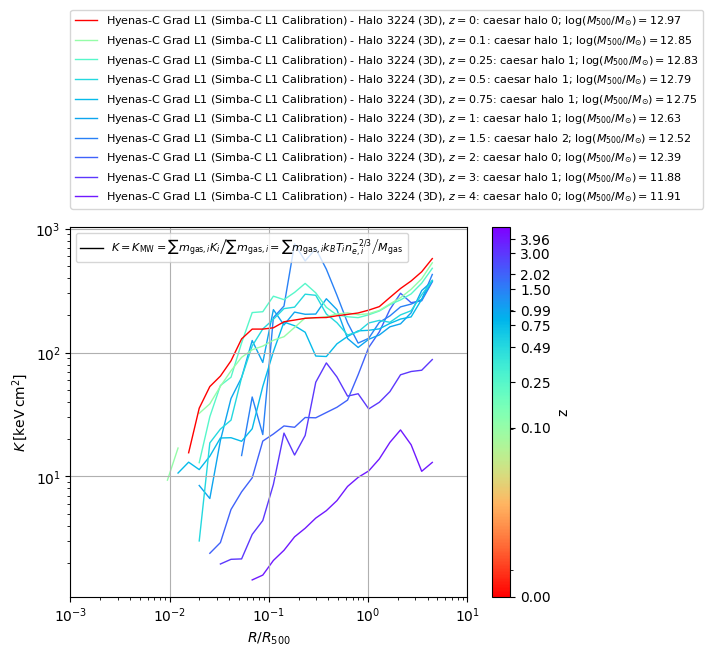

In [471]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV cm**2'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-.', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[r'$K=K_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} K_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i}^{-2/3} \middle/ M_{\mathrm{gas}} \right.$',],
                      # r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{bin}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}})^{-2/3} \right.$',
                      # r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i}^{-2/3} \middle/ \sum m_{\mathrm{gas},i} \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


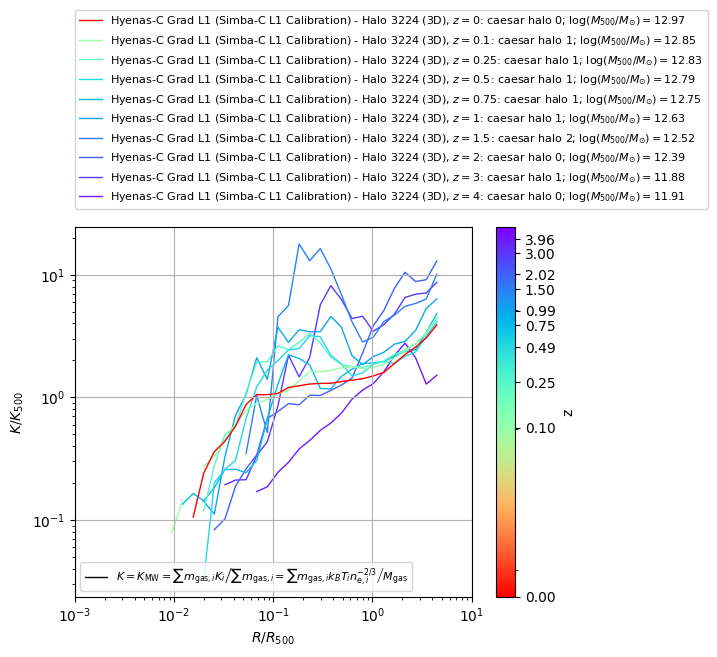

In [30]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = '1'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean-K500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-.', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$K/K_{500}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[r'$K=K_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} K_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i}^{-2/3} \middle/ M_{\mathrm{gas}} \right.$',],
                      # r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{bin}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}})^{-2/3} \right.$',
                      # r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i}^{-2/3} \middle/ \sum m_{\mathrm{gas},i} \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV


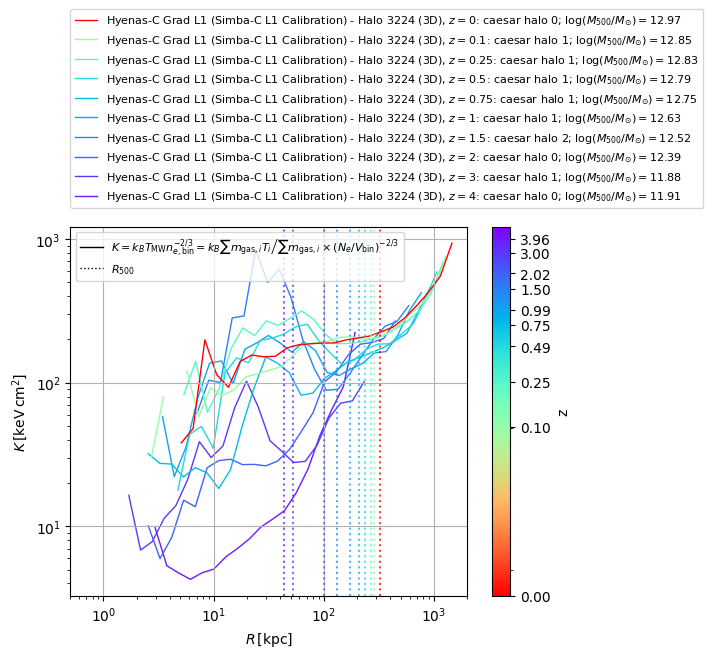

In [472]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV cm**2'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[
                  # r'$K=K_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} K_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i}^{-2/3} \middle/ M_{\mathrm{gas}} \right.$',
                      r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{bin}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}})^{-2/3} \right.$',
                      # r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i}^{-2/3} \middle/ \sum m_{\mathrm{gas},i} \right.$',
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV


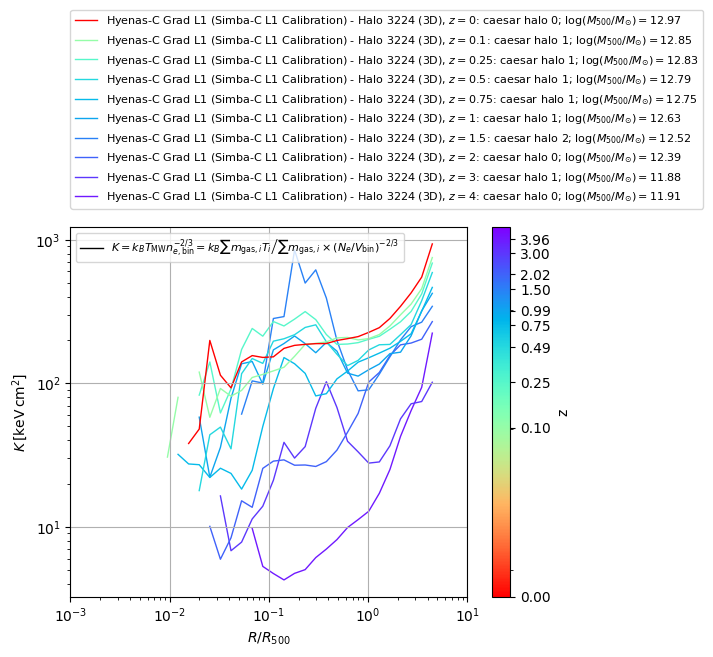

In [473]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV cm**2'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[
                  # r'$K=K_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} K_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i}^{-2/3} \middle/ M_{\mathrm{gas}} \right.$',
                      r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{bin}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}})^{-2/3} \right.$',],
                      # r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i}^{-2/3} \middle/ \sum m_{\mathrm{gas},i} \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


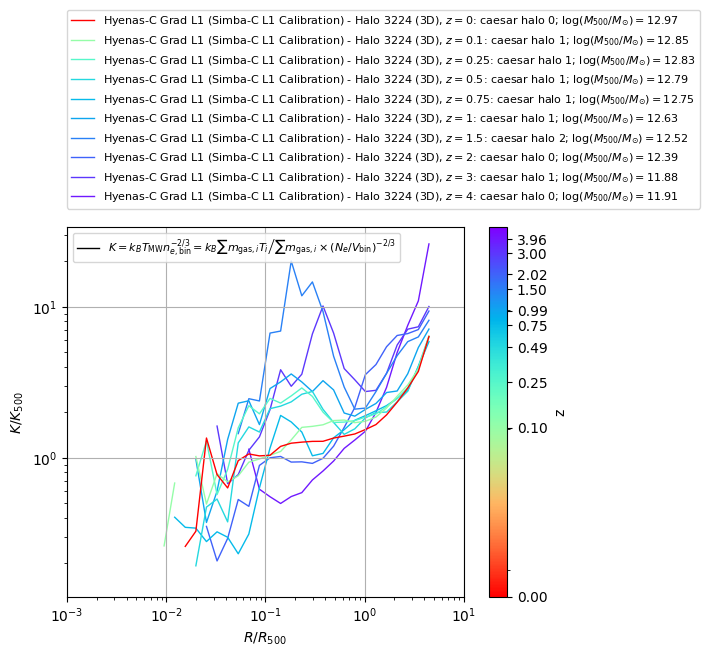

In [31]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = '1'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T-K500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$K/K_{500}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[
                  # r'$K=K_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} K_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i}^{-2/3} \middle/ M_{\mathrm{gas}} \right.$',
                      r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{bin}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}})^{-2/3} \right.$',],
                      # r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i}^{-2/3} \middle/ \sum m_{\mathrm{gas},i} \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV


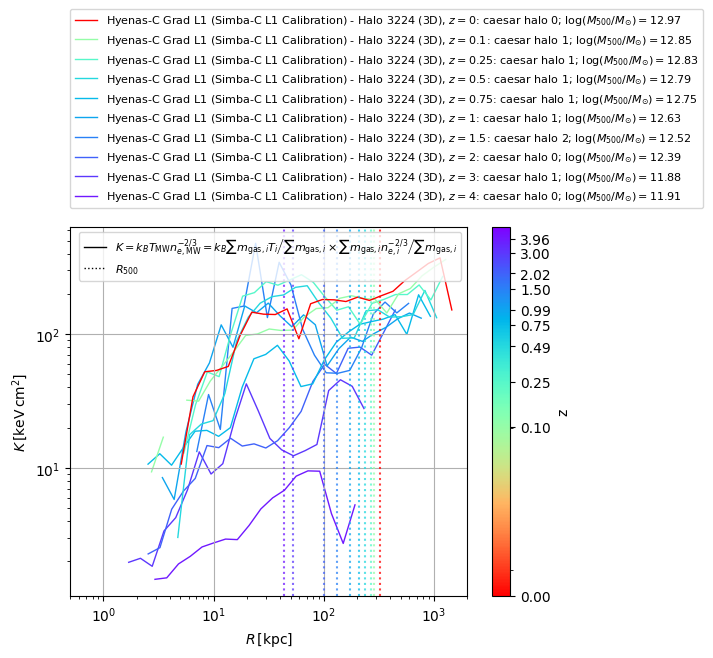

In [474]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV cm**2'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-mass_weighted_mean_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[
                  # r'$K=K_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} K_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i}^{-2/3} \middle/ M_{\mathrm{gas}} \right.$',
                      # r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{bin}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}})^{-2/3} \right.$',
                      r'$K=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}^{-2/3}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i}^{-2/3} \middle/ \sum m_{\mathrm{gas},i} \right.$',
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV
cm**2 keV


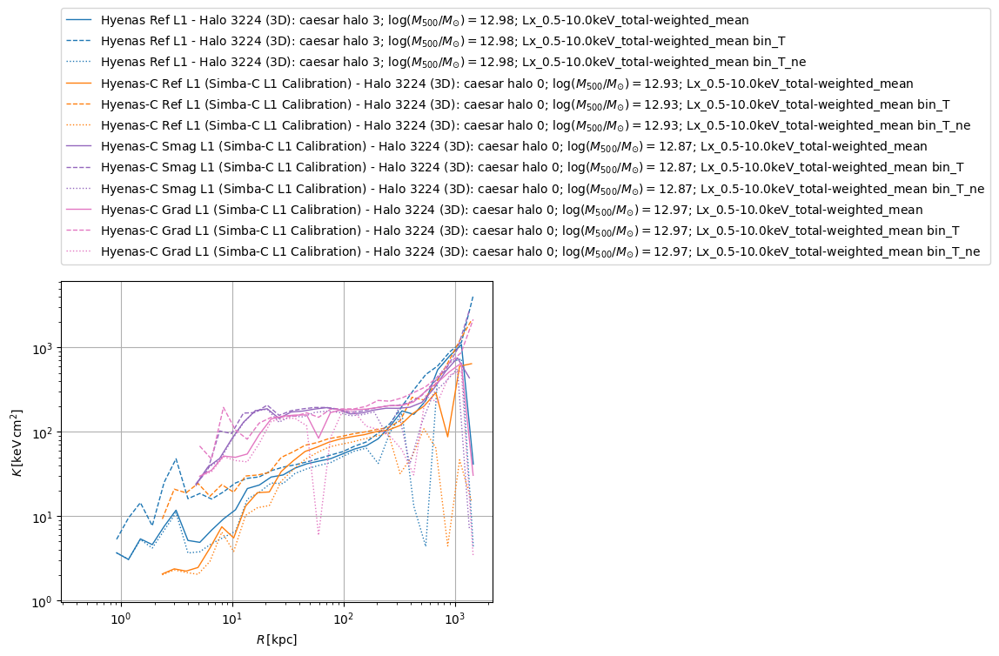

In [294]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-Lx_0.5-10.0keV_total_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx_0.5-10.0keV_total-weighted_mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-Lx_0.5-10.0keV_total_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx_0.5-10.0keV_total-weighted_mean bin_T')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['K-Lx_0.5-10.0keV_total_weighted_mean_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx_0.5-10.0keV_total-weighted_mean bin_T_ne')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

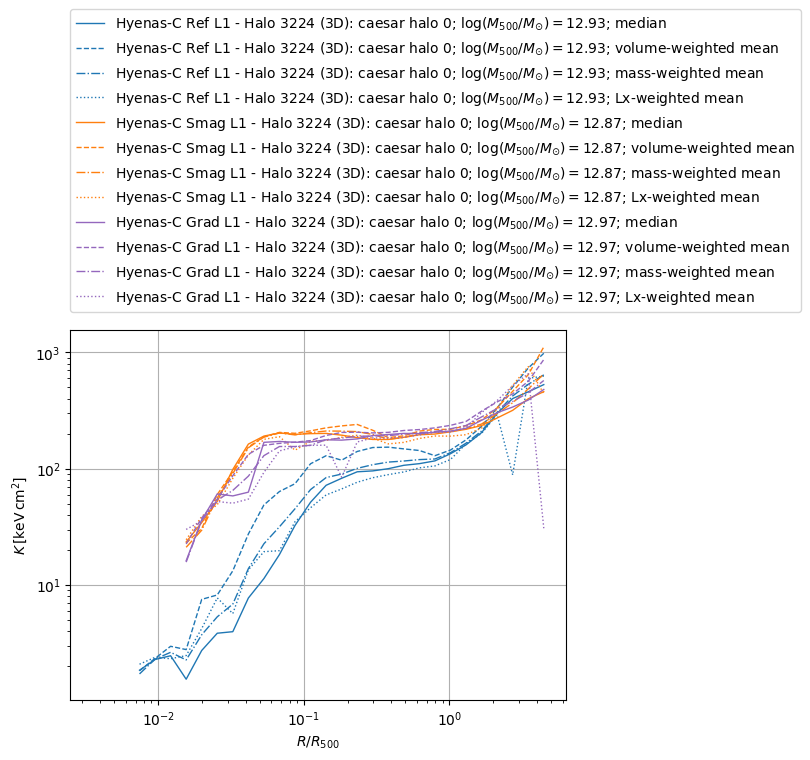

In [19]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4',]

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['K_median']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['K_volume']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean')

        y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['K_mass']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['K_Lx_0.5-10.0keV_total']
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; Lx-weighted mean')

        # y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['K_mass_bin_T']
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; MW bin_T')

        # y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['K_mass_bin_T_ne']
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=(0,(3,10,1,10,1,10)),
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; MW bin_T_ne')
        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$K\,[\mathrm{keV\,cm^2}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

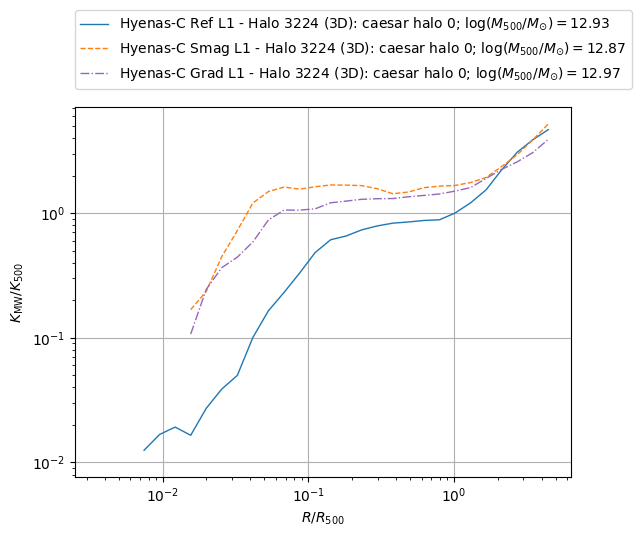

In [50]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C4', 'C4']
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4',]

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-', '--', '-.']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['full']
    for halo_id in halo_ids:
        x_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['K_mass_K500ideal']
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        # print(x_profile)#, x_profile.units)
        # print(y_profile, y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=ls_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}' )
        # print()
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$K_{\mathrm{MW}}/K_{500}$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

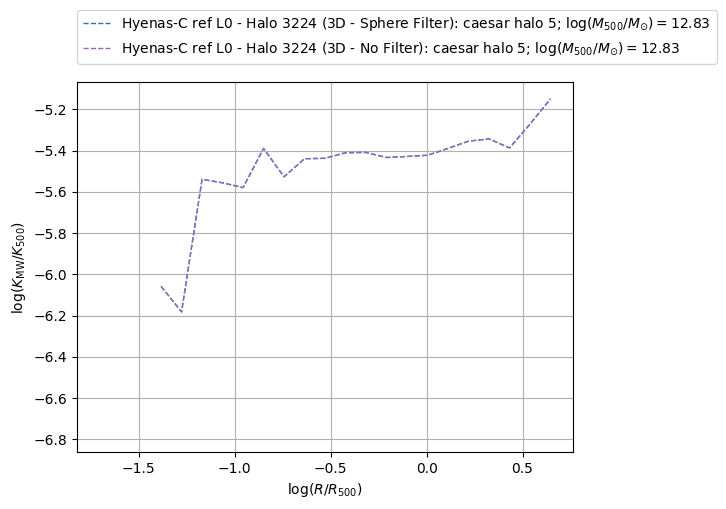

In [14]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C4', 'C4']
color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['full']
    for halo_id in halo_ids:
        x_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['x']['log_rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['log_K_mass_bin_T_K500ideal']
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        # print(x_profile)#, x_profile.units)
        # print(y_profile, y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=ls_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}' )
        # print()
        i += 1

plt.grid()
# plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$\log(R/R_{500})$')
plt.ylabel(r'$\log(K_{\mathrm{MW}}/K_{500})$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

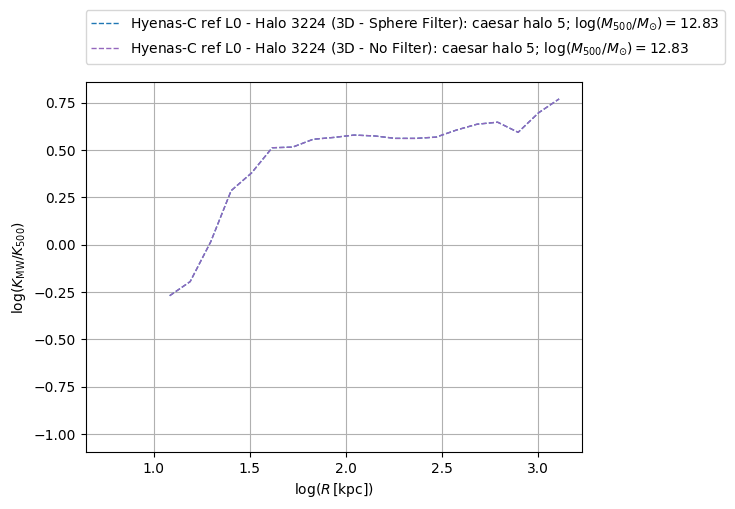

In [15]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['full']
    for halo_id in halo_ids:
        x_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['x']['log_physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['log_K_mass_K500ideal']
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        # print(x_profile)#, x_profile.units)
        # print(y_profile, y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=ls_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}' )
        # print()
        i += 1

plt.grid()
# plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$\log(R\,[\mathrm{kpc}])$')
plt.ylabel(r'$\log(K_{\mathrm{MW}}/K_{500})$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

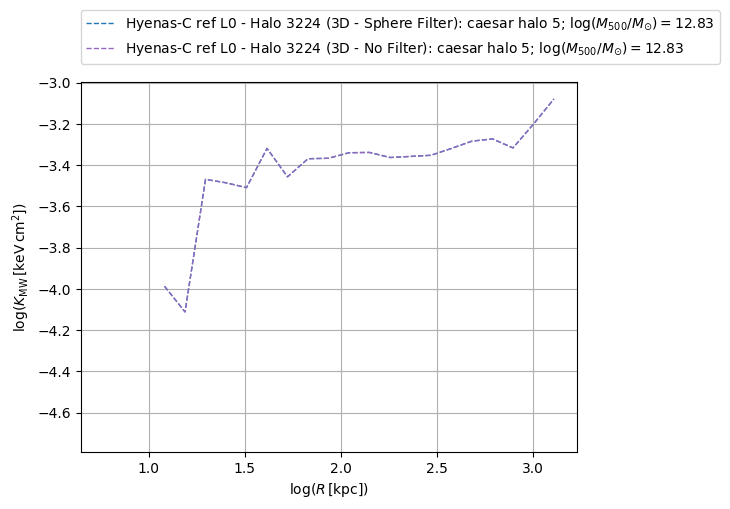

In [16]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4',]

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
# ls_list = ['-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['full']
    for halo_id in halo_ids:
        x_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['x']['log_physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        y_profile = sim_info['profile']['halo_profiles'][halo_id]['full']['y']['log_K_mass_bin_T']
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        # print(x_profile)#, x_profile.units)
        # print(y_profile, y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=ls_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}' )
        # print()
        i += 1

plt.grid()
# plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$\log(R\,[\mathrm{kpc}])$')
plt.ylabel(r'$\log(K_{\mathrm{MW}}\,[\mathrm{keV \, cm^2}])$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

## Pressure

keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3


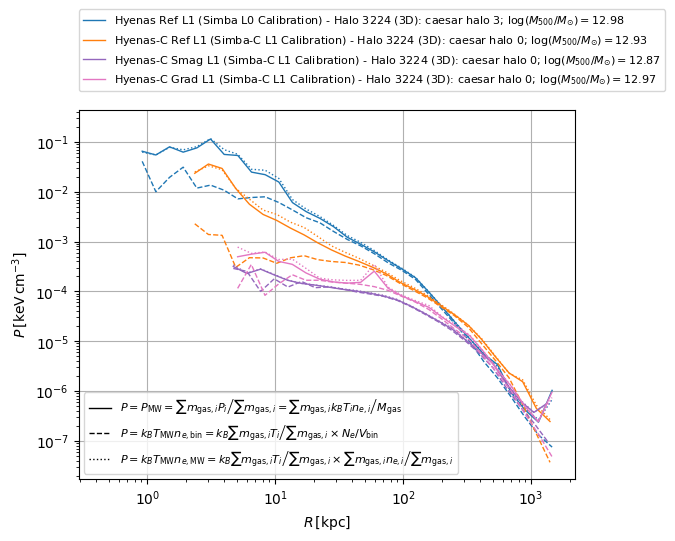

In [98]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-mass_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-mass_weighted_mean_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T_ne')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$P\,[\mathrm{keV\,cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'$P=P_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} P_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ M_{\mathrm{gas}} \right.$',
                      r'$P=k_B T_{\mathrm{MW}} n_{e,\mathrm{bin}}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times N_e/V_{\mathrm{bin}} \right.$',
                      r'$P=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i} \middle/ \sum m_{\mathrm{gas},i} \right.$',],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

keV cm**-3


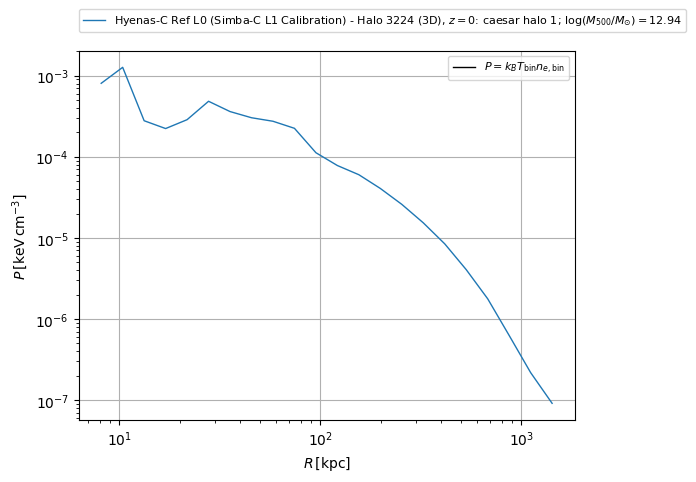

In [55]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-mass_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls='--',)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-mass_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=':',)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T_ne')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$P\,[\mathrm{keV\,cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',)
                          ],
              labels=[
                  # r'$P=P_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} P_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ M_{\mathrm{gas}} \right.$',
                      r'$P=k_B T_{\mathrm{bin}} n_{e,\mathrm{bin}}$',
                      # r'$P=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i} \middle/ \sum m_{\mathrm{gas},i} \right.$',
              ],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


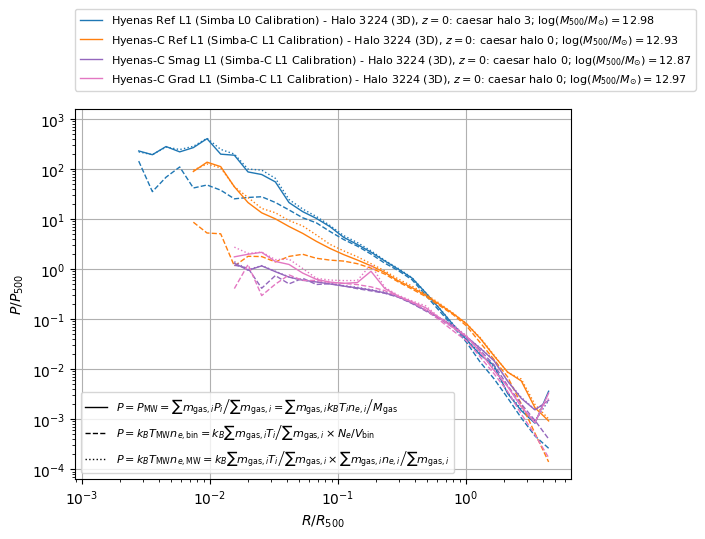

In [9]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-mass_weighted_mean-P500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-mass_weighted_mean_bin_T-P500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-mass_weighted_mean_bin_T_ne-P500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T_ne')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$P/P_{500}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'$P=P_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} P_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ M_{\mathrm{gas}} \right.$',
                      r'$P=k_B T_{\mathrm{MW}} n_{e,\mathrm{bin}}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times N_e/V_{\mathrm{bin}} \right.$',
                      r'$P=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i} \middle/ \sum m_{\mathrm{gas},i} \right.$',],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

1.00e+00


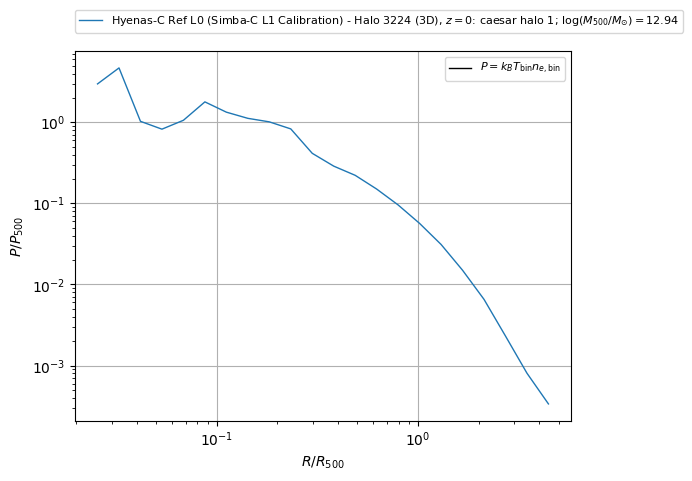

In [56]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-bin-P500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-mass_weighted_mean_bin_T-P500ideal']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls='--',)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-mass_weighted_mean_bin_T_ne-P500ideal']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile,
        #          color=color_list[i], lw=lw_list[i], ls=':',)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T_ne')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$P/P_{500}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',)
                          ],
              labels=[
                  # r'$P=P_{\mathrm{MW}}=\left. \sum m_{\mathrm{gas},i} P_i \middle/ \sum m_{\mathrm{gas},i} \right. = \left. \sum m_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ M_{\mathrm{gas}} \right.$',
                      r'$P=k_B T_{\mathrm{bin}} n_{e,\mathrm{bin}}$',
                      # r'$P=k_B T_{\mathrm{MW}} n_{e,\mathrm{MW}}=\left. k_B \sum m_{\mathrm{gas},i} T_i \middle/ \sum m_{\mathrm{gas},i} \times \sum m_{\mathrm{gas},i} n_{e,i} \middle/ \sum m_{\mathrm{gas},i} \right.$',
              ],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3


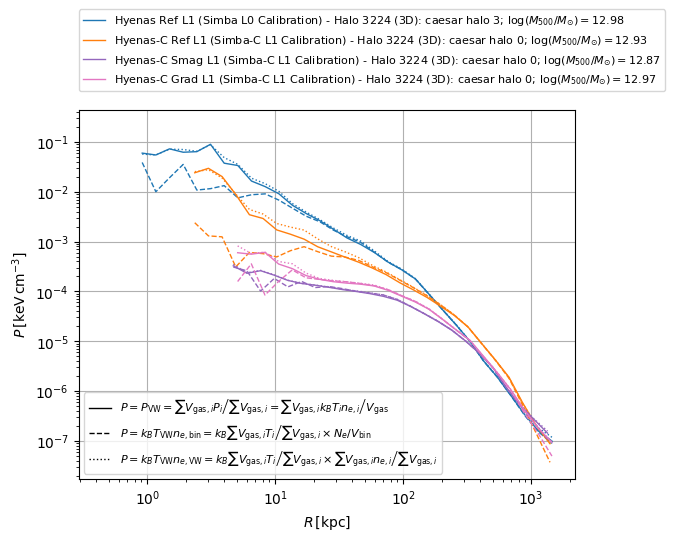

In [99]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T_ne')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$P\,[\mathrm{keV\,cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'$P=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{gas}} \right.$',
                      r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times N_e/V_{\mathrm{bin}} \right.$',
                      r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


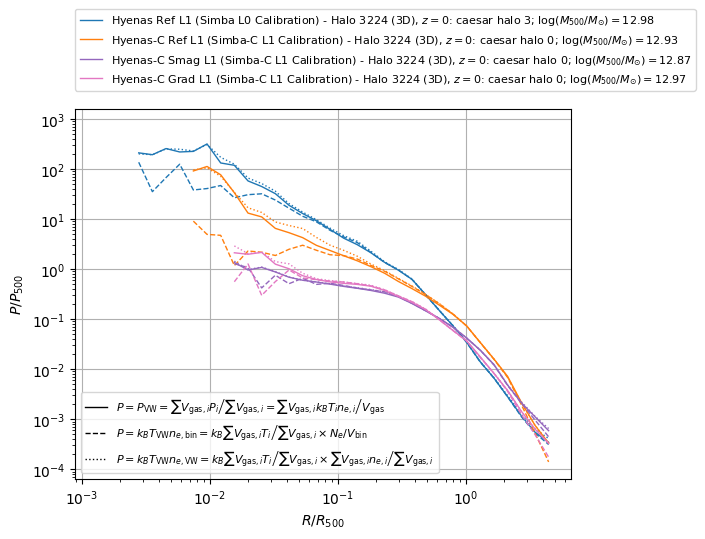

In [10]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean-P500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T-P500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T_ne-P500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls=':',)
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass_weighted_mean bin_T_ne')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$P/P_{500}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',)],
              labels=[r'$P=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{gas}} \right.$',
                      r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times N_e/V_{\mathrm{bin}} \right.$',
                      r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3


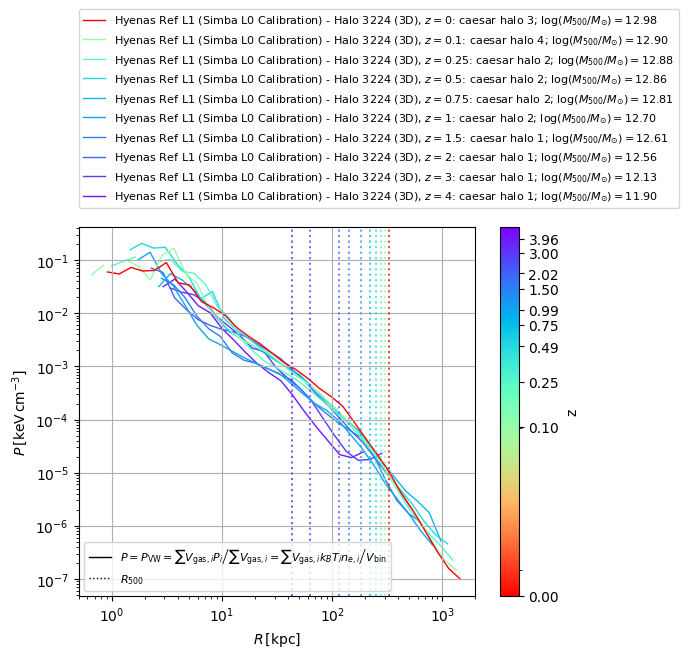

In [9]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV cm**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-.', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$P\,[\mathrm{keV\,cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[r'$P=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3


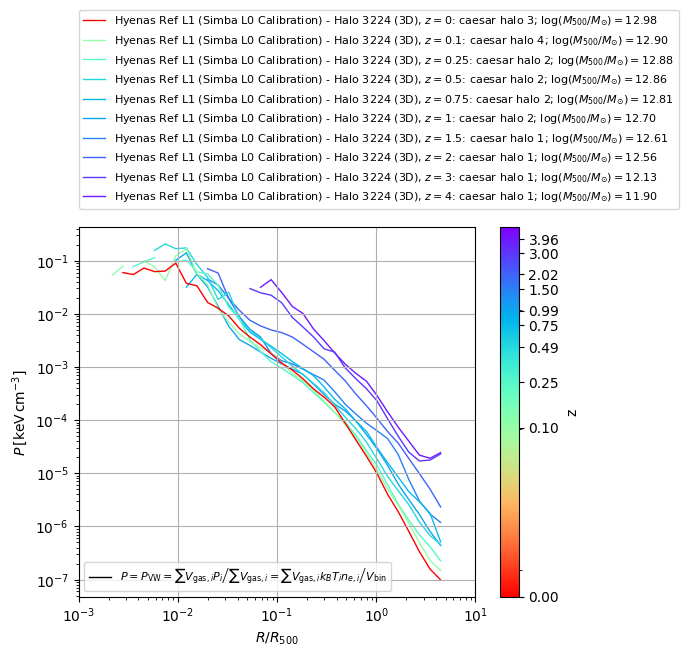

In [10]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV cm**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-.', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$P\,[\mathrm{keV\,cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[r'$P=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',],
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


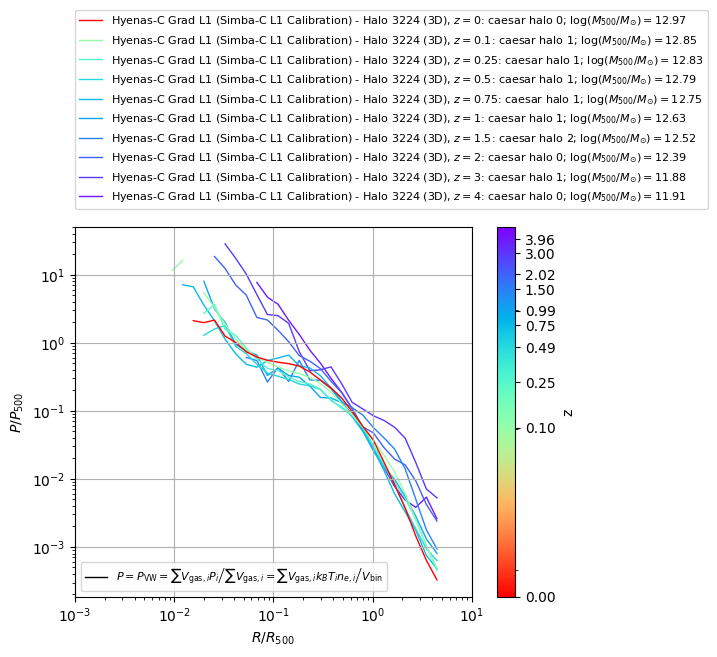

In [32]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = '1'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean-P500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-.', alpha=alpha_list[i], zorder=zorder_list[i],)
        #          # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$P/P_{500}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[r'$P=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',],
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3


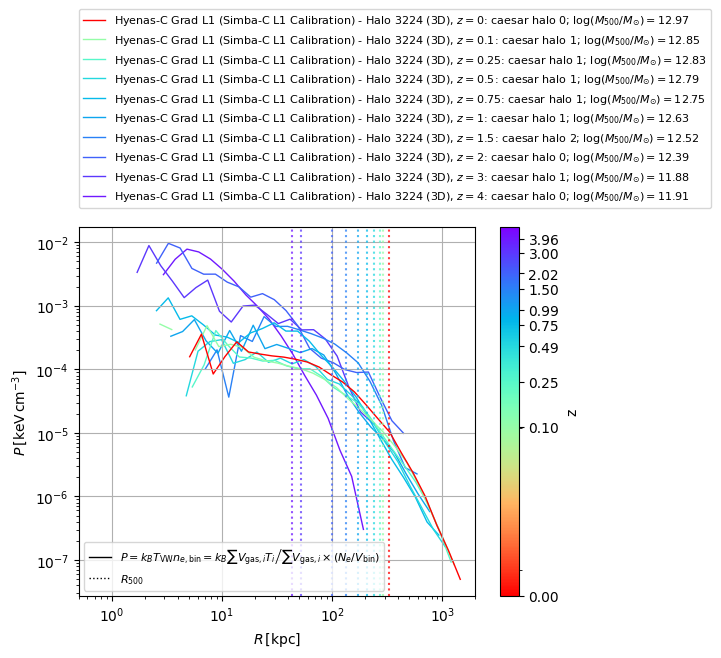

In [477]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV cm**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$P\,[\mathrm{keV\,cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[
                  # r'$K=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',
                      r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3


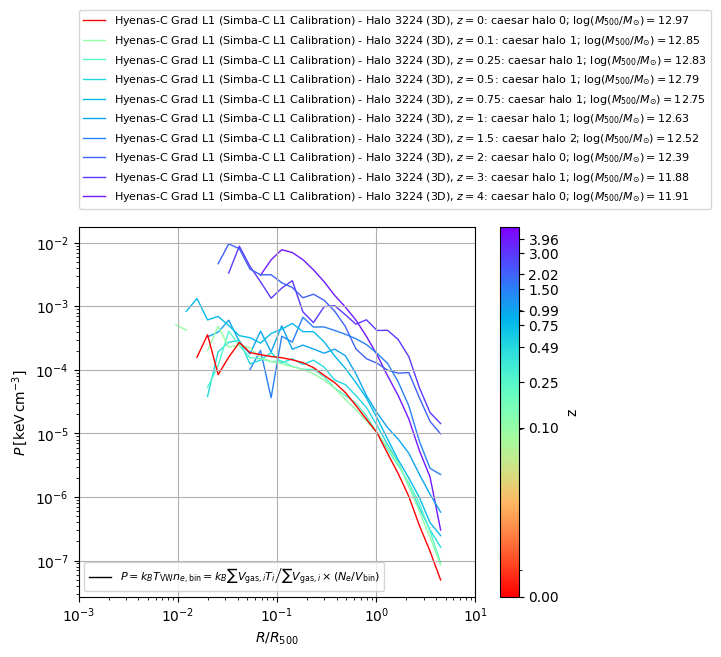

In [478]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV cm**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$P\,[\mathrm{keV\,cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[
                  # r'$K=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',
                      r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',],
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


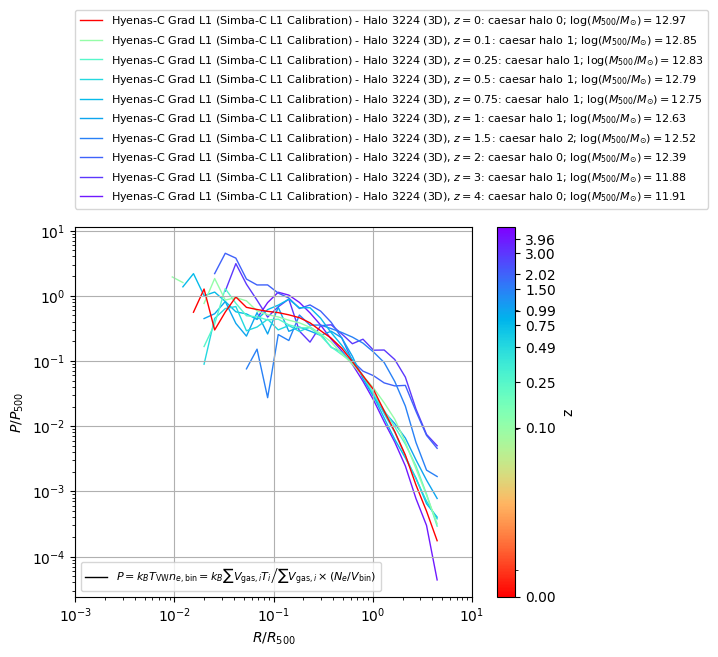

In [33]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = '1'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T-P500ideal']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T_ne']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$P/P_{500}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[
                  # r'$K=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',
                      r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',],
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3


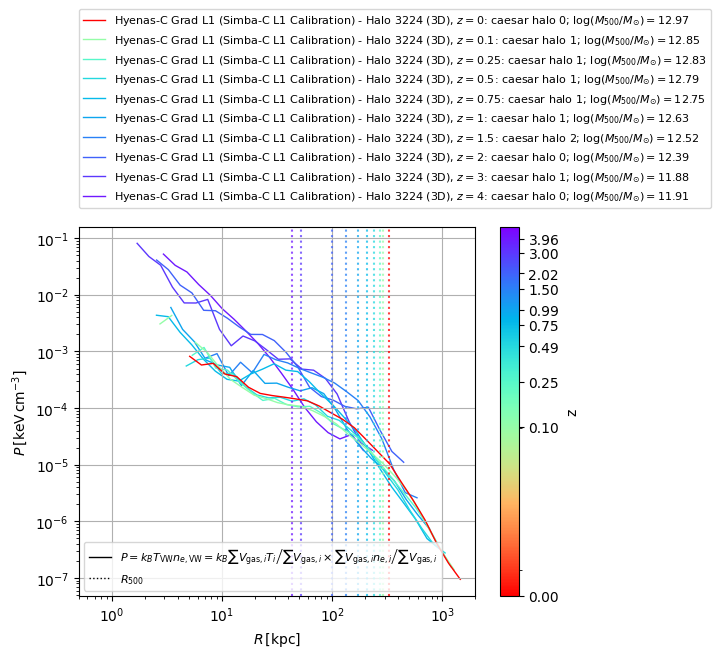

In [479]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV cm**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$P\,[\mathrm{keV\,cm^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[
                  # r'$K=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',
                      r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3
keV cm**-3


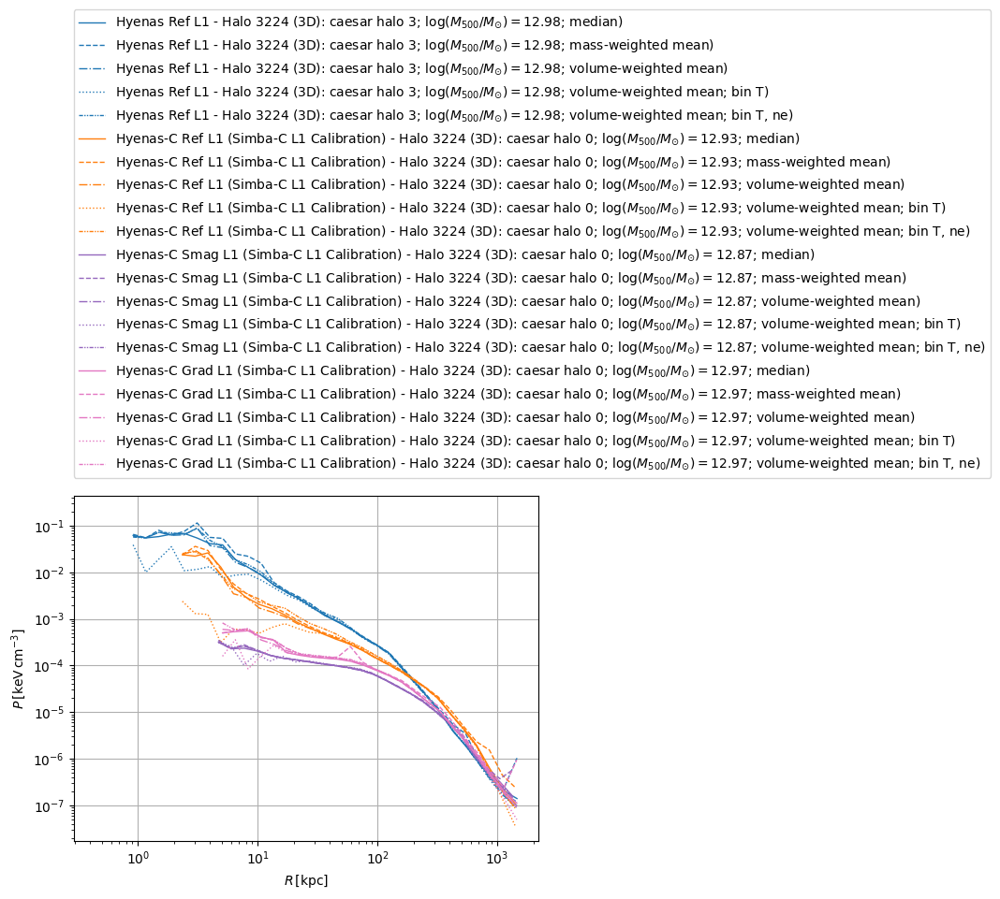

In [295]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'keV cm**-3'

i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median)')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean)')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean)')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean; bin T)')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['P-volume_weighted_mean_bin_T_ne']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=(0,(3,1,1,1,1,1)),
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean; bin T, ne)')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
# plt.ylim(-1e70, -1e55)
# plt.ylim(-1e3, 1)
# plt.ylim(-0.1, 0.1)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$P\,[\mathrm{keV\,cm^{-3}}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

## Thermal/Internal Energy

km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2


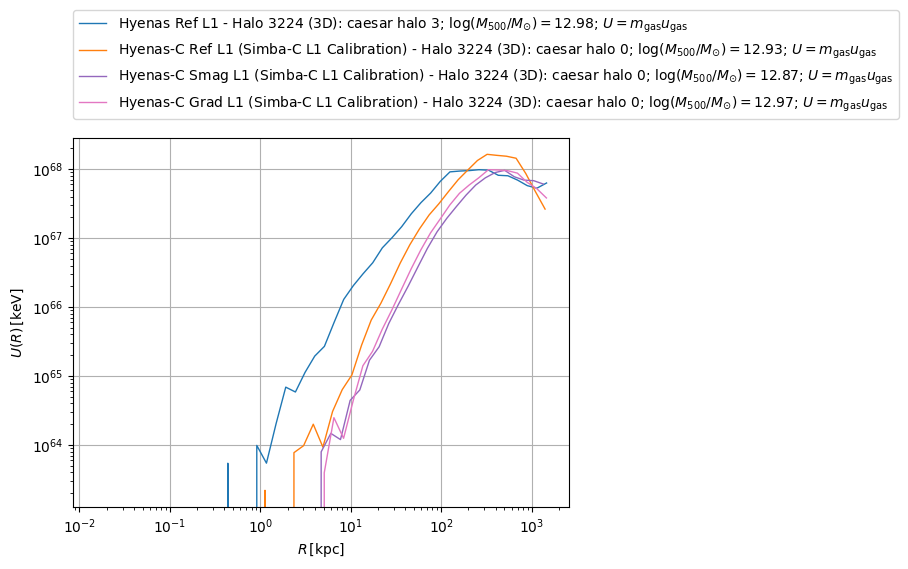

In [296]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'keV'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$U=m_{\mathrm{gas}}u_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v1']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$U_{v1}=1.5k_BT_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$U_{v2}=1.5N_Hk_BT_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v3']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$U_{v3}=1.5N_ek_BT_{\mathrm{gas}}$')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$U(R)\,[\mathrm{keV}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2


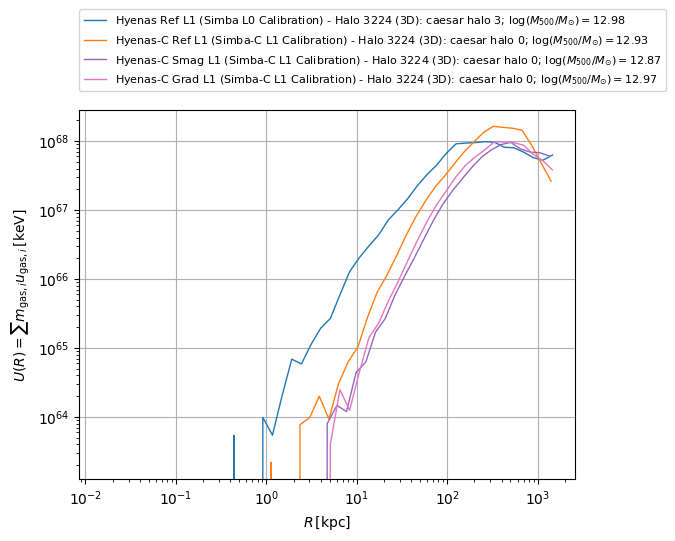

In [106]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'keV'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v1']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$U_{v1}=1.5k_BT_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$U_{v2}=1.5N_Hk_BT_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v3']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$U_{v3}=1.5N_ek_BT_{\mathrm{gas}}$')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$U(R)=\sum m_{\mathrm{gas},i} u_{\mathrm{gas},i}\,[\mathrm{keV}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',)],
#               labels=[r'$dP_{\mathrm{IGrM,VW}}/dR$', r'$-GM(<R)\rho(r)/R^2$'],
#               fontsize=8)
# ax.add_artist(leg2)
plt.show()

km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2


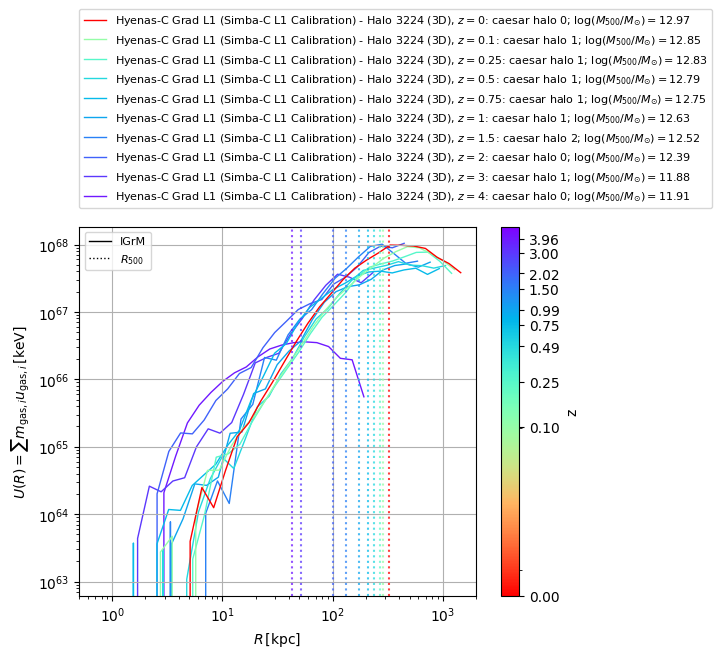

In [480]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$U(R)=\sum m_{\mathrm{gas},i} u_{\mathrm{gas},i}\,[\mathrm{keV}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=['IGrM',
                  # r'$K=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2


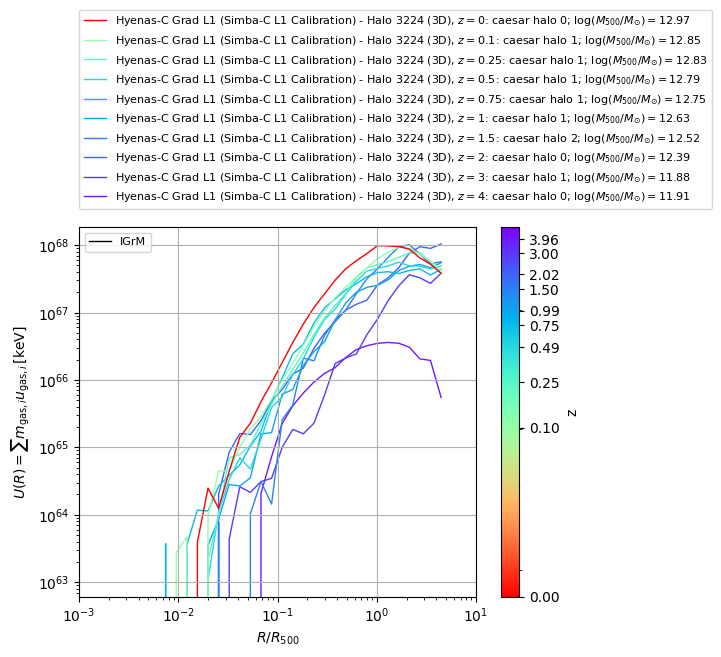

In [481]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$U(R)=\sum m_{\mathrm{gas},i} u_{\mathrm{gas},i}\,[\mathrm{keV}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=['IGrM',],
                  # r'$K=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2


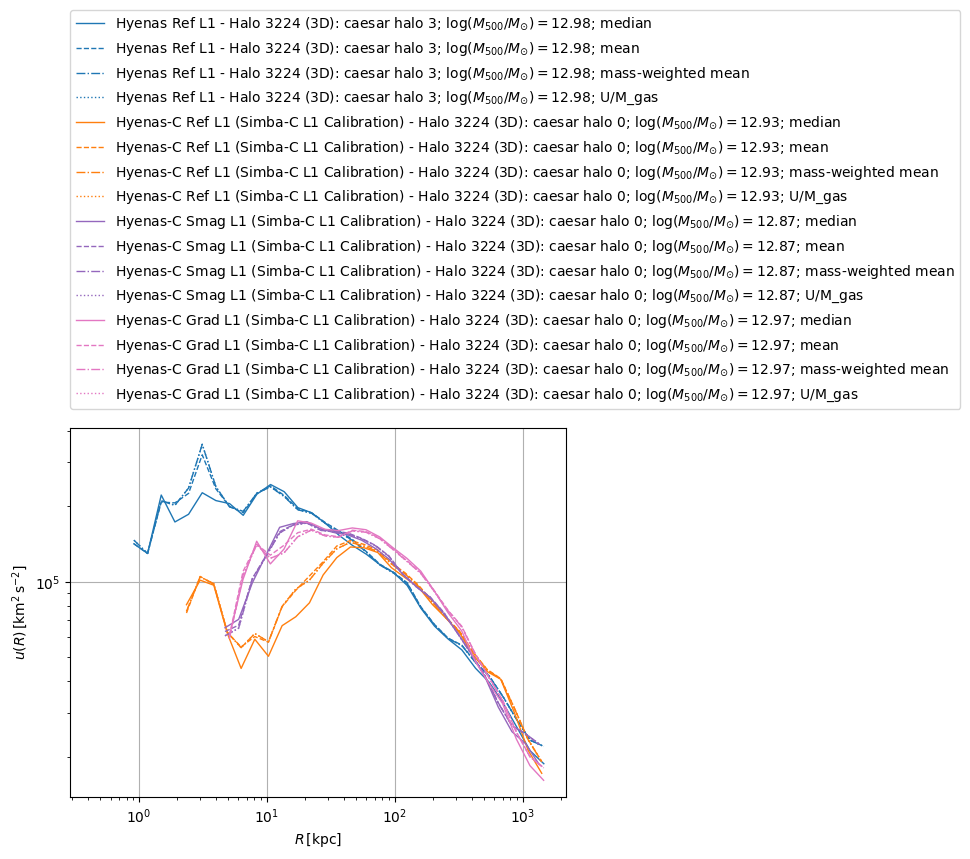

In [297]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'km**2 s**-2'#'keV Msol**-1'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; U/M_gas')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v1']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$U_{v1}=1.5k_BT_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u_v2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$u_{v2}=U_{v2}/m_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v3']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$u_{v3}=U_{v3}/m_{\mathrm{gas}}$')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$u(R)\,[\mathrm{km^2\,s^{-2}}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2


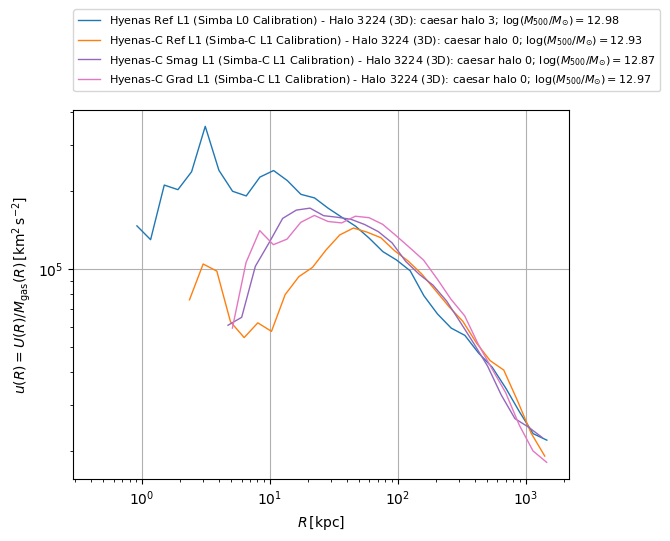

In [110]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'km**2 s**-2'#'erg g**-1'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v1']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$U_{v1}=1.5k_BT_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u_v2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$u_{v2}=U_{v2}/m_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v3']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$u_{v3}=U_{v3}/m_{\mathrm{gas}}$')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$u(R)=U(R)/M_{\mathrm{gas}}(R)\,[\mathrm{km^2\,s^{-2}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',)],
#               labels=[r'$dP_{\mathrm{IGrM,VW}}/dR$', r'$-GM(<R)\rho(r)/R^2$'],
#               fontsize=8)
# ax.add_artist(leg2)
plt.show()

km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2


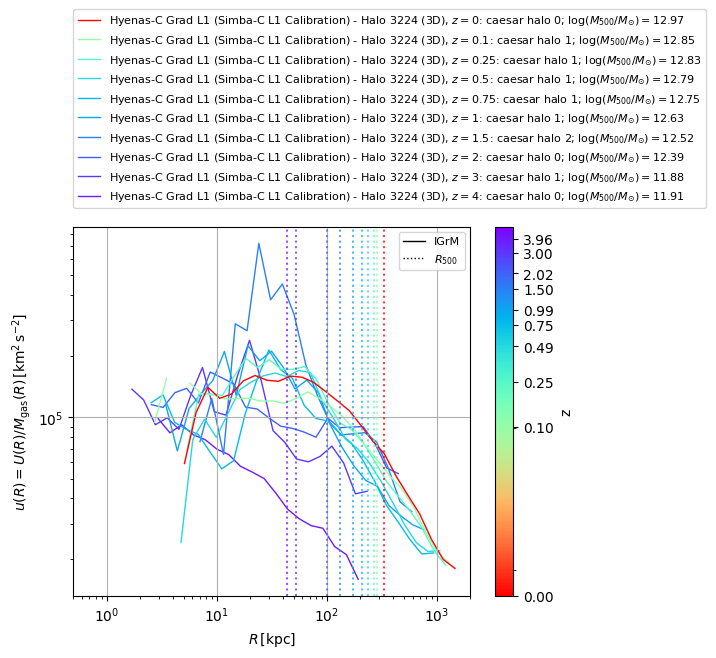

In [482]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'km**2 s**-2'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$u(R)=U(R)/M_{\mathrm{gas}}(R)\,[\mathrm{km^2\,s^{-2}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=['IGrM',
                  # r'$K=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2


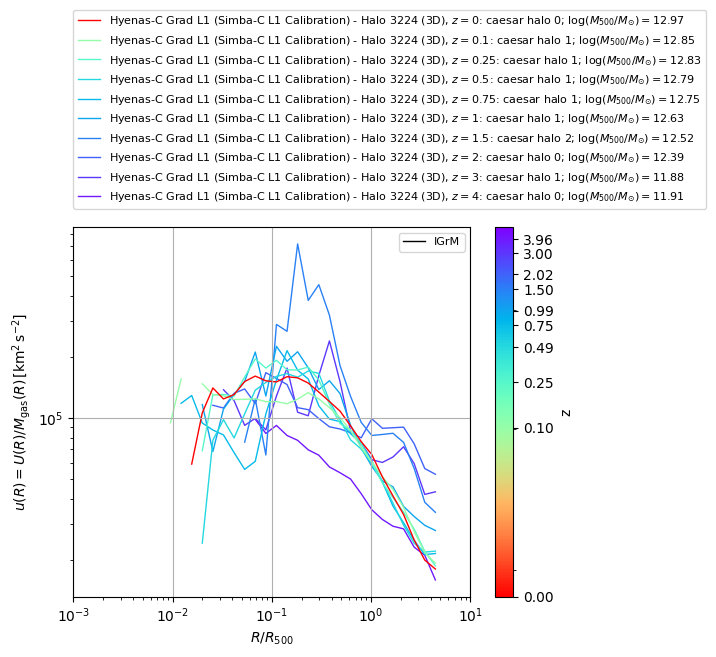

In [483]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'km**2 s**-2'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$u(R)=U(R)/M_{\mathrm{gas}}(R)\,[\mathrm{km^2\,s^{-2}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=['IGrM',],
                  # r'$K=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2


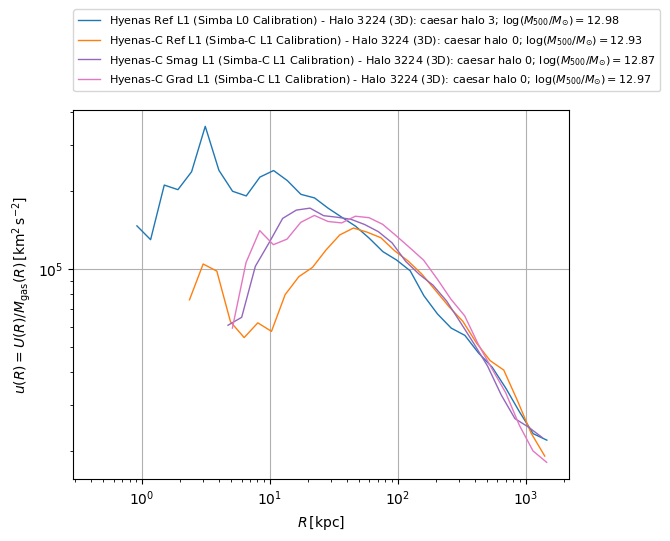

In [112]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'km**2 s**-2'#'erg g**-1'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-bin']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v1']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$U_{v1}=1.5k_BT_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u_v2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$u_{v2}=U_{v2}/m_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v3']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$u_{v3}=U_{v3}/m_{\mathrm{gas}}$')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$u(R)=U(R)/M_{\mathrm{gas}}(R)\,[\mathrm{km^2\,s^{-2}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',)],
#               labels=[r'$dP_{\mathrm{IGrM,VW}}/dR$', r'$-GM(<R)\rho(r)/R^2$'],
#               fontsize=8)
# ax.add_artist(leg2)
plt.show()

In [298]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'km**2 s**-2'#'keV Msol**-1'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u_v2-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u_v2-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u_v2-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u_v2-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; U/M_gas')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v1']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$U_{v1}=1.5k_BT_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u_v2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$u_{v2}=U_{v2}/m_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v3']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$u_{v3}=U_{v3}/m_{\mathrm{gas}}$')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$u_{v2}(R)\,[\mathrm{km^2\,s^{-2}}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

KeyError: 'u_v2-median'

km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3


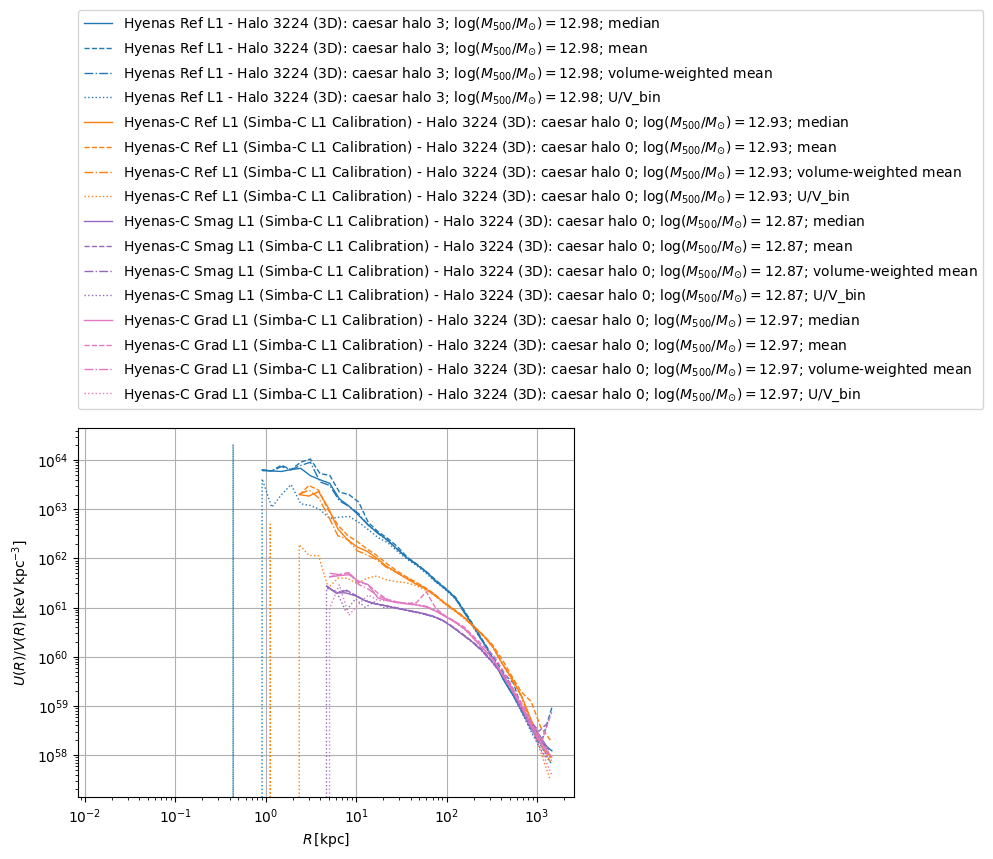

In [299]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'keV kpc**-3'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_density-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_density-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_density-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_density-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; U/V_bin')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v1']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$U_{v1}=1.5k_BT_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u_v2']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$u_{v2}=U_{v2}/m_{\mathrm{gas}}$')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_v3']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls=':',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; '+r'$u_{v3}=U_{v3}/m_{\mathrm{gas}}$')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$U(R)/V(R)\,[\mathrm{keV\,kpc^{-3}}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

## Kinetic Energy

km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2


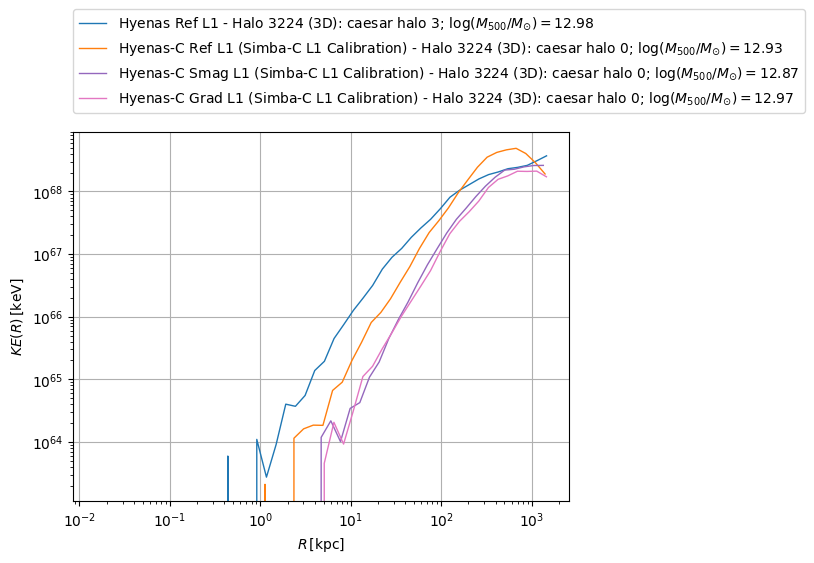

In [300]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'keV'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$KE(R)\,[\mathrm{keV}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2


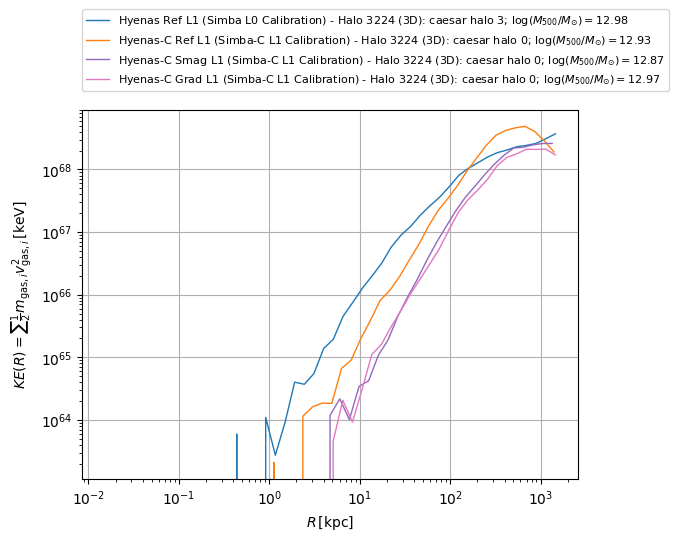

In [125]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'keV'#'km**2 Msol s**-2'#'erg'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$KE(R)=\sum \frac{1}{2}m_{\mathrm{gas},i}v_{\mathrm{gas},i}^2\,[\mathrm{keV}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',)],
#               labels=[r'$dP_{\mathrm{IGrM,VW}}/dR$', r'$-GM(<R)\rho(r)/R^2$'],
#               fontsize=8)
# ax.add_artist(leg2)
plt.show()

km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2


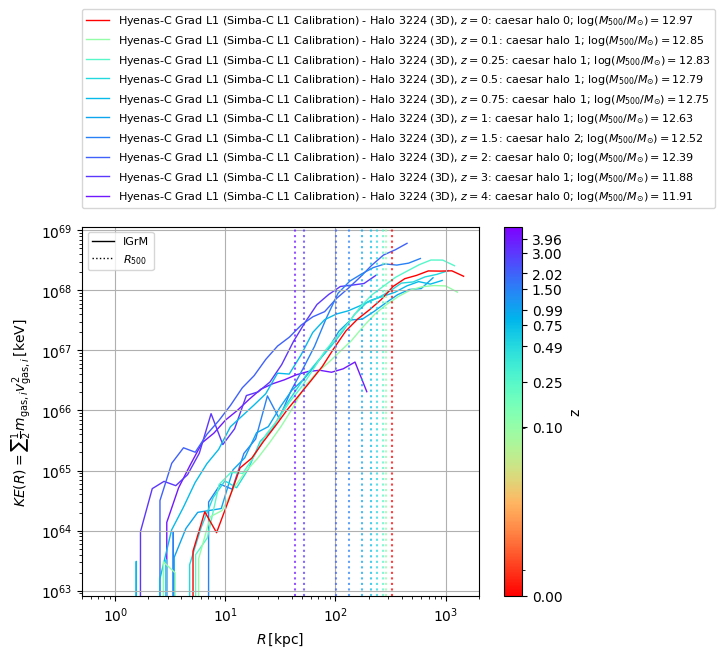

In [484]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$KE(R)=\sum \frac{1}{2}m_{\mathrm{gas},i}v_{\mathrm{gas},i}^2\,[\mathrm{keV}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=['IGrM',
                  # r'$K=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2


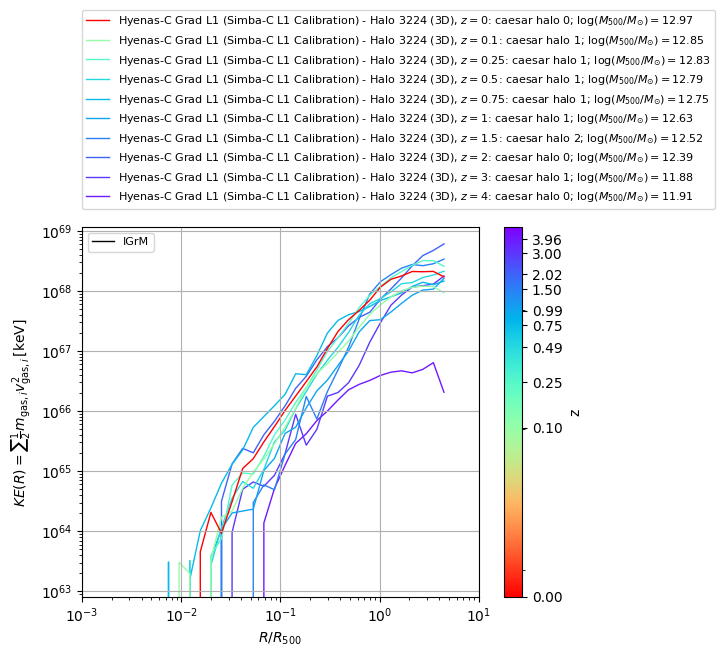

In [485]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$KE(R)=\sum \frac{1}{2}m_{\mathrm{gas},i}v_{\mathrm{gas},i}^2\,[\mathrm{keV}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=['IGrM',],
                  # r'$K=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2


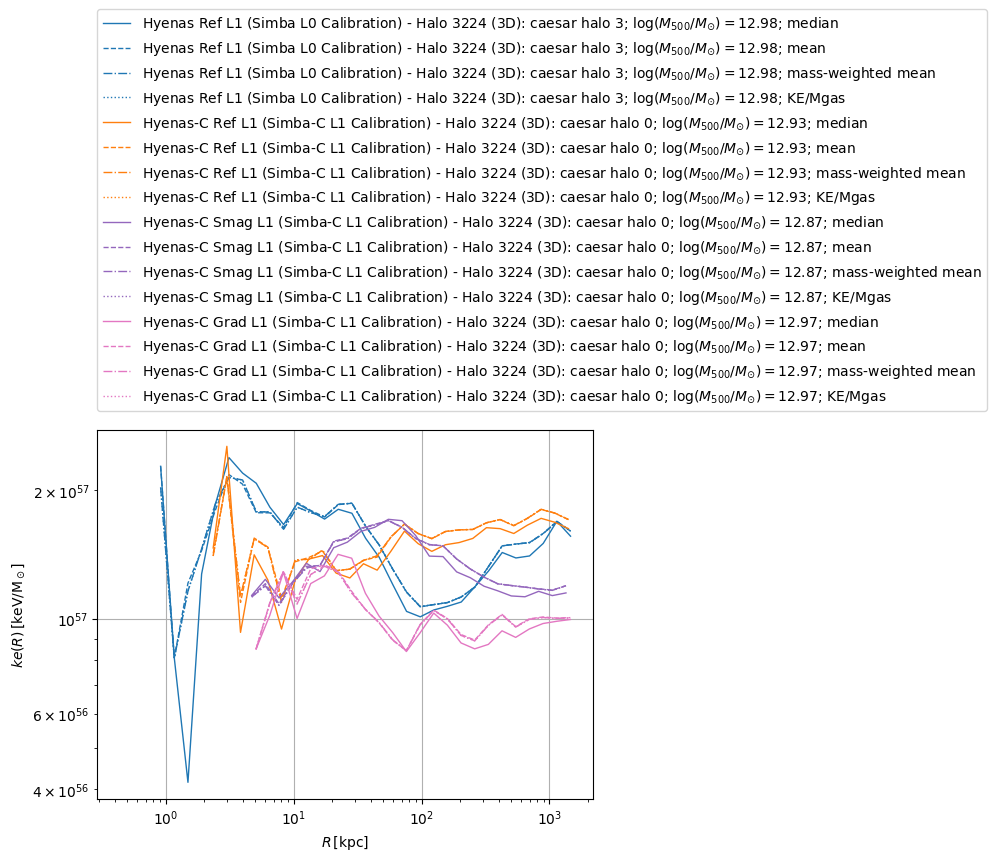

In [116]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'keV Msol**-1'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_per_mass-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_per_mass-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_per_mass-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_per_mass-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; KE/Mgas')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$ke(R)\,[\mathrm{keV/M_\odot}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2


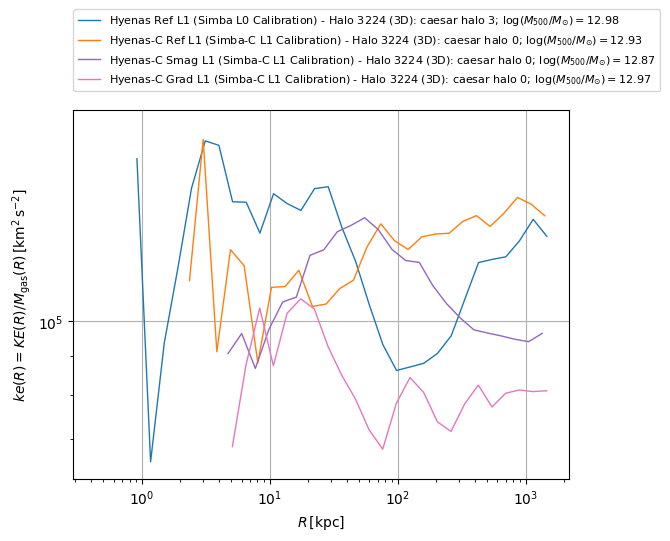

In [121]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'km**2 s**-2'#'keV Msol**-1'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_per_mass-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_per_mass-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_per_mass-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mass-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_per_mass-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$ke(R)=KE(R)/M_{\mathrm{gas}}(R)\,[\mathrm{km^2\,s^{-2}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',)],
#               labels=[r'$dP_{\mathrm{IGrM,VW}}/dR$', r'$-GM(<R)\rho(r)/R^2$'],
#               fontsize=8)
# ax.add_artist(leg2)
plt.show()

km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2


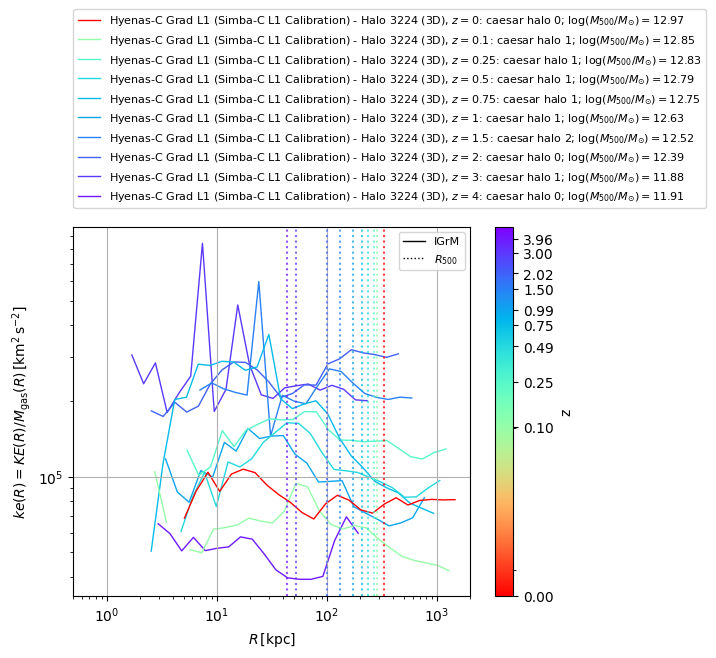

In [486]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'km**2 s**-2'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_per_mass-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$ke(R)=KE(R)/M_{\mathrm{gas}}(R)\,[\mathrm{km^2\,s^{-2}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=['IGrM',
                  # r'$K=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2
km**2 s**-2


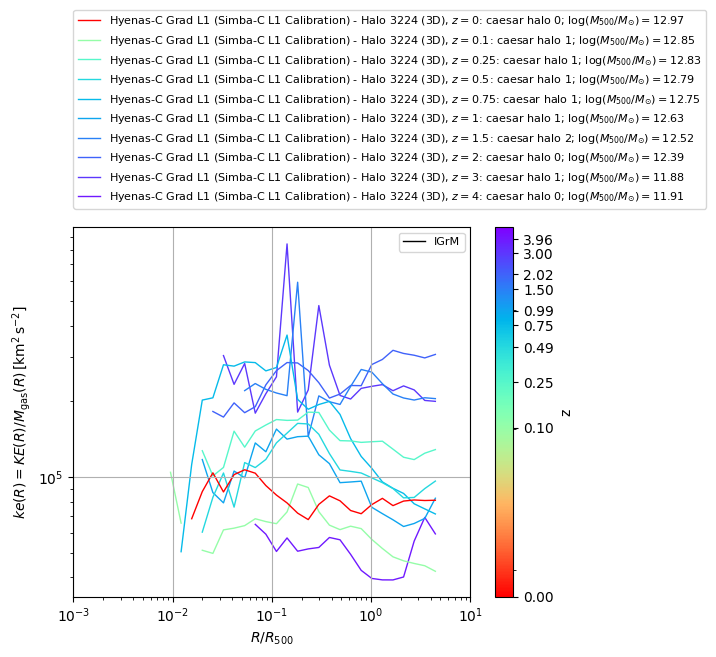

In [487]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'km**2 s**-2'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_per_mass-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$ke(R)=KE(R)/M_{\mathrm{gas}}(R)\,[\mathrm{km^2\,s^{-2}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=['IGrM',],
                  # r'$K=P_{\mathrm{VW}}=\left. \sum V_{\mathrm{gas},i} P_i \middle/ \sum V_{\mathrm{gas},i} \right. = \left. \sum V_{\mathrm{gas},i} k_B T_i n_{e,i} \middle/ V_{\mathrm{bin}} \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{bin}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times (N_e/V_{\mathrm{bin}}) \right.$',
                      # r'$P=k_B T_{\mathrm{VW}} n_{e,\mathrm{VW}}=\left. k_B \sum V_{\mathrm{gas},i} T_i \middle/ \sum V_{\mathrm{gas},i} \times \sum V_{\mathrm{gas},i} n_{e,i} \middle/ \sum V_{\mathrm{gas},i} \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3


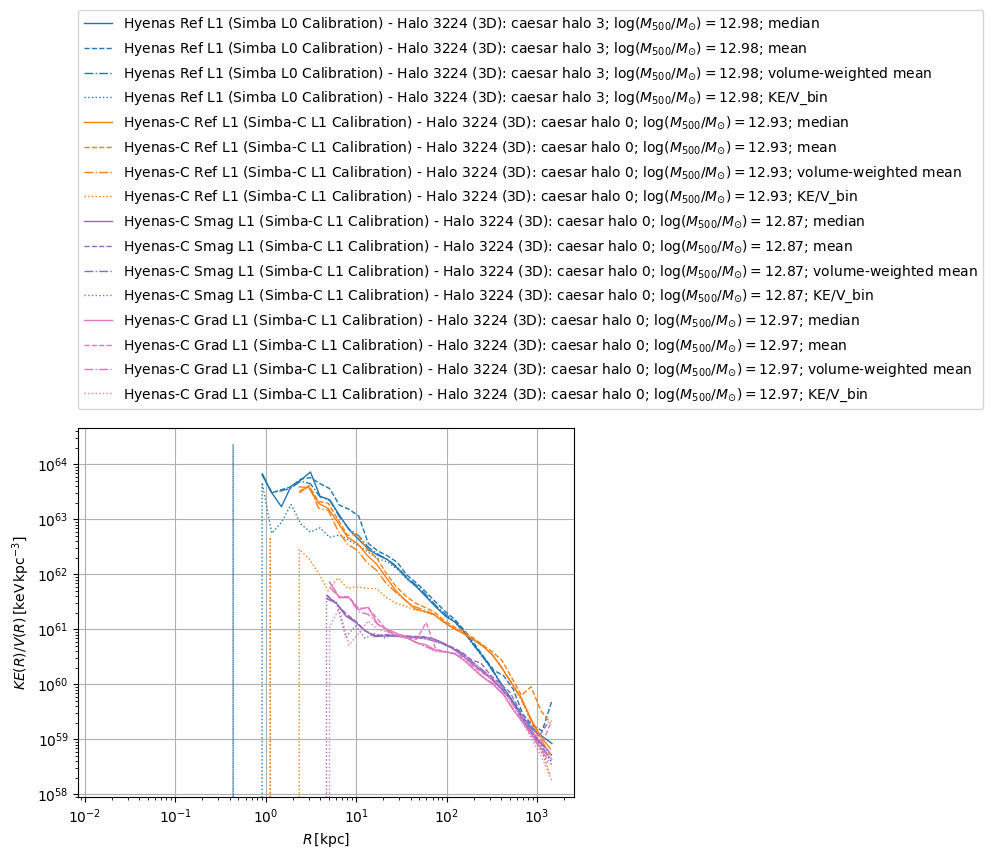

In [122]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'keV kpc**-3'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; volume-weighted mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; KE/V_bin')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$KE(R)/V(R)\,[\mathrm{keV\,kpc^{-3}}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3


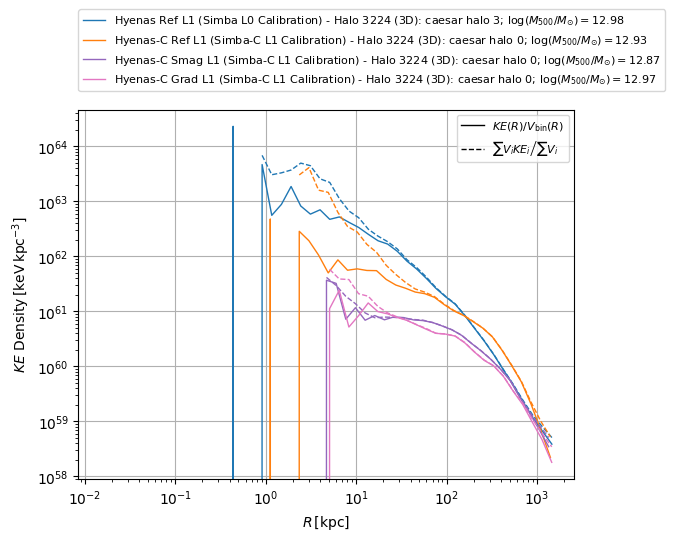

In [124]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'keV kpc**-3'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; median')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; mean')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$KE\,\,\mathrm{Density}\,[\mathrm{keV\,kpc^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',)],
              labels=[r'$KE(R)/V_{\mathrm{bin}}(R)$', r'$\left. \sum V_i KE_i \middle/ \sum V_i \right.$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3


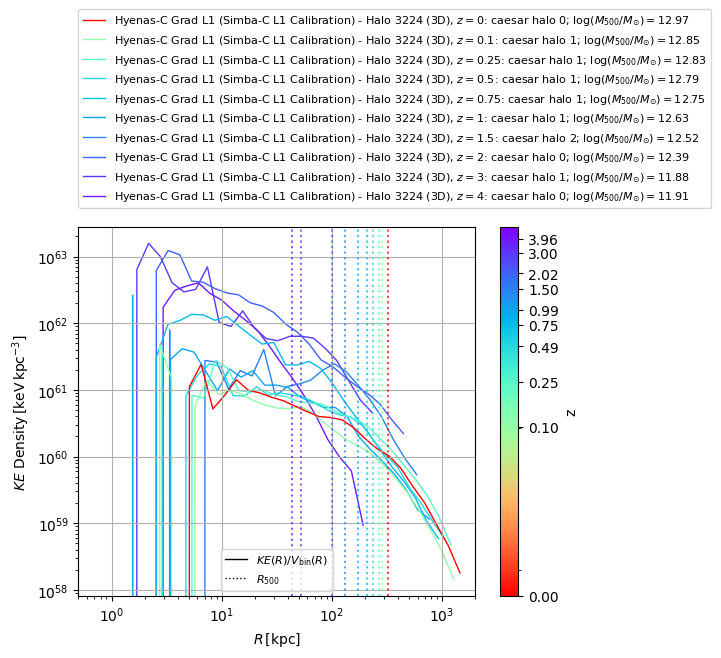

In [488]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV kpc**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-volume_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$KE\,\,\mathrm{Density}\,[\mathrm{keV\,kpc^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[r'$KE(R)/V_{\mathrm{bin}}(R)$',
                      # r'$\left. \sum V_i KE_i \middle/ \sum V_i \right.$',
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3


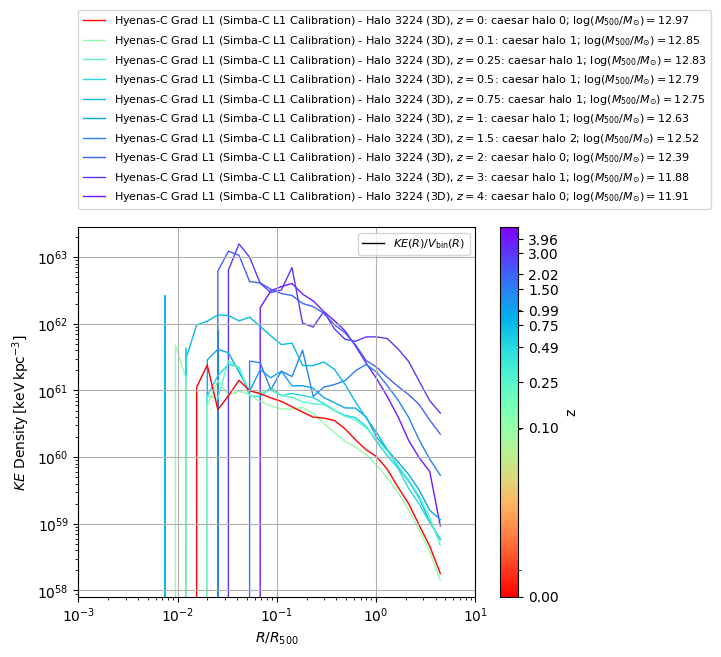

In [489]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV kpc**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-volume_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='--', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$KE\,\,\mathrm{Density}\,[\mathrm{keV\,kpc^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[r'$KE(R)/V_{\mathrm{bin}}(R)$',],
                      # r'$\left. \sum V_i KE_i \middle/ \sum V_i \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3


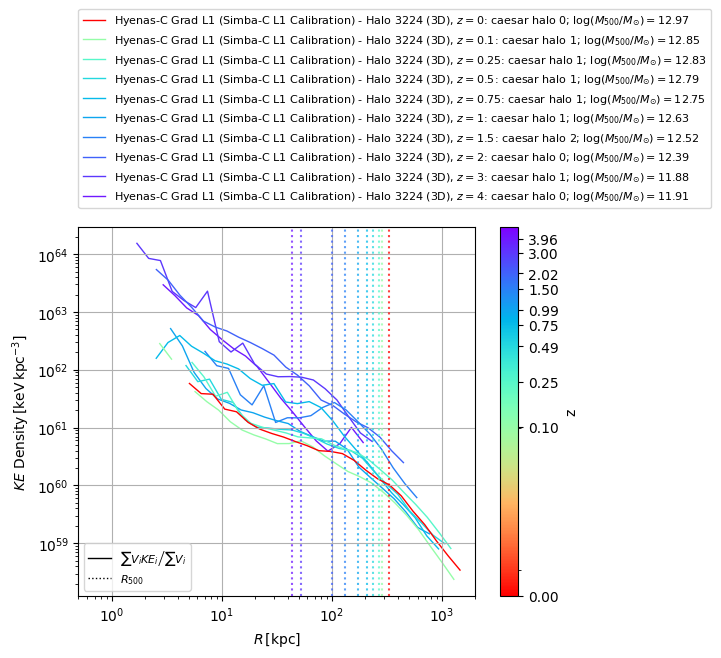

In [490]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV kpc**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-bin']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$KE\,\,\mathrm{Density}\,[\mathrm{keV\,kpc^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[
                  # r'$KE(R)/V_{\mathrm{bin}}(R)$',
                      r'$\left. \sum V_i KE_i \middle/ \sum V_i \right.$',
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3


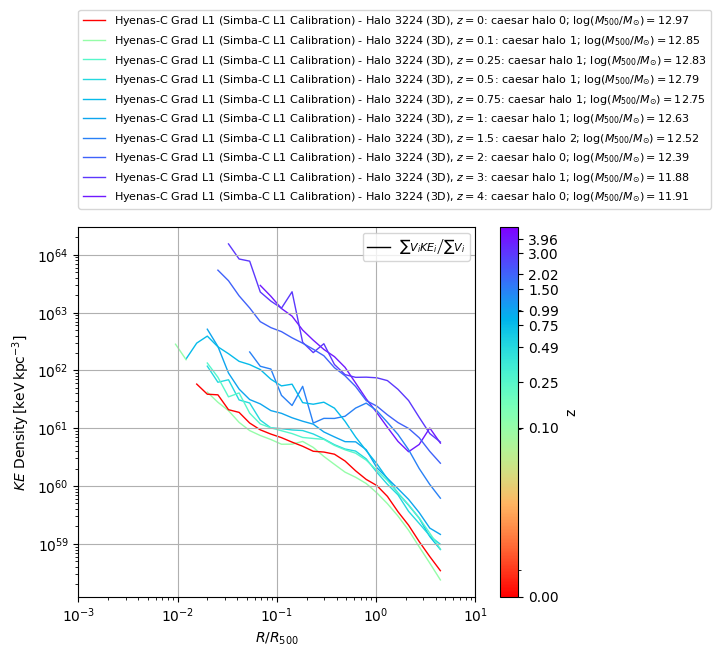

In [491]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

units = 'keV kpc**-3'

i = 0
for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-bin']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
        #          label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-volume_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$KE\,\,\mathrm{Density}\,[\mathrm{keV\,kpc^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=[
                  # r'$KE(R)/V_{\mathrm{bin}}(R)$',
                      r'$\left. \sum V_i KE_i \middle/ \sum V_i \right.$',],
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

## Total Energy & Components

km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2


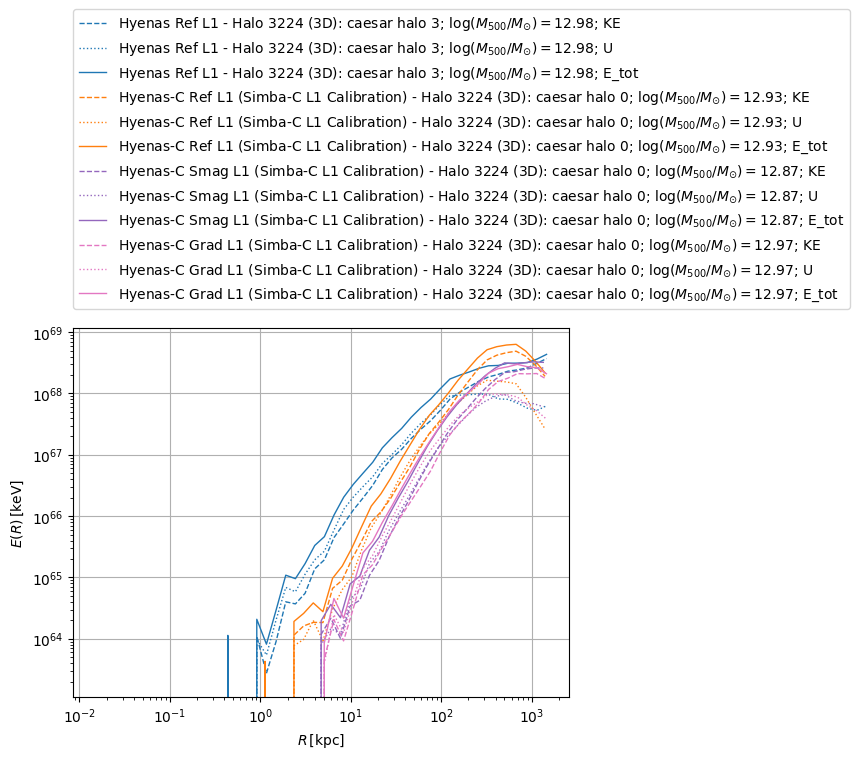

In [305]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'keV'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; KE')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; U')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['E']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; E_tot')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$E(R)\,[\mathrm{keV}]$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2
km**2 Msol s**-2


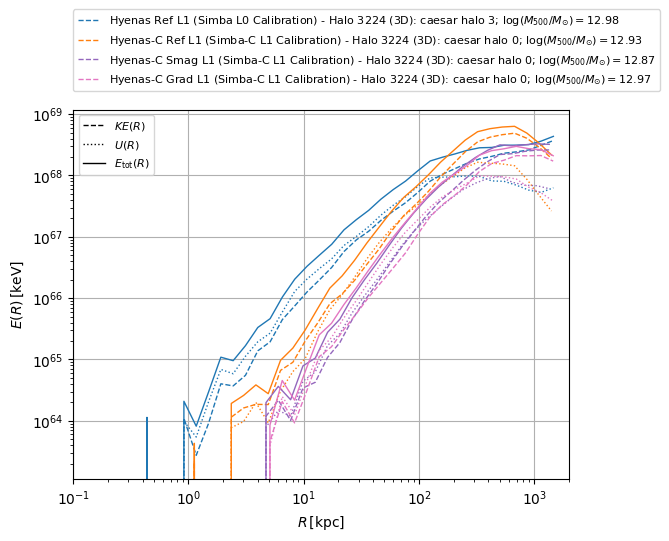

In [127]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'keV'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)
                 # label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; U')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['E']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$E(R)\,[\mathrm{keV}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           Line2D([],[],lw=1,ls='-',color='black',)],
              labels=[r'$KE(R)$', r'$U(R)$', r'$E_{\mathrm{tot}}(R)$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

km**2 s**-2
km**2 s**-2
km**2 s**-2


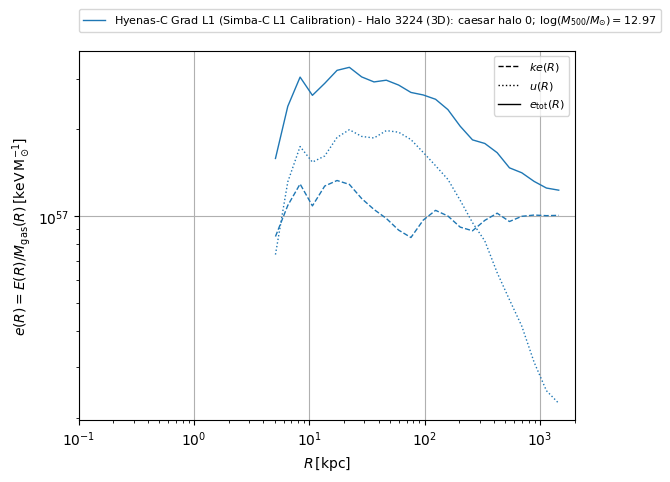

In [148]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'keV Msol**-1'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_per_mass-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['u-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)
                 # label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; U')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['E_per_mass-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$e(R)=E(R)/M_{\mathrm{gas}}(R)\,[\mathrm{keV\,M_\odot^{-1}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           Line2D([],[],lw=1,ls='-',color='black',)],
              labels=[r'$ke(R)$', r'$u(R)$', r'$e_{\mathrm{tot}}(R)$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3
km**2 Msol s**-2 kpc**-3


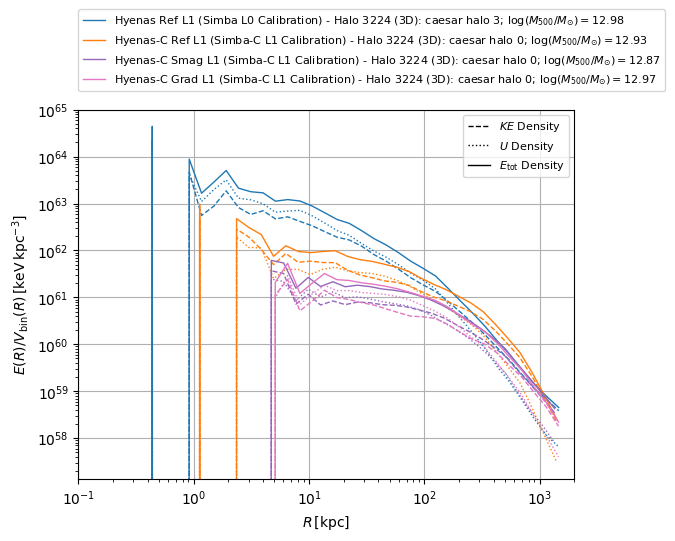

In [153]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'keV kpc**-3'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['KE_total_density-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)
                 # label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['U_density-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',)
                 # label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; U')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['E_density-bin']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$E(R)/V_{\mathrm{bin}}(R)\,[\mathrm{keV\,kpc^{-3}}]$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),
                           Line2D([],[],lw=1,ls='-',color='black',)],
              labels=[r'$KE\,\,\mathrm{Density}$', r'$U\,\,\mathrm{Density}$', r'$E_{\mathrm{tot}}\,\,\mathrm{Density}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.show()

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


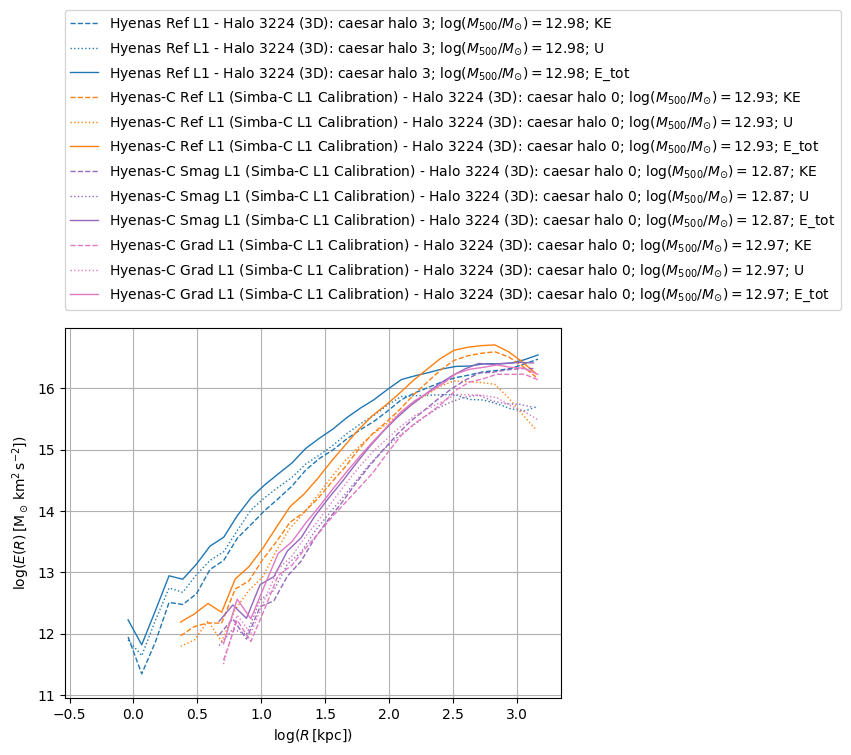

In [306]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0
units = 'keV'

for sim, sim_info in sim_dict.items():
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['log_physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_KE_total']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; KE')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_U']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls=':',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; U')

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_E']
        print(y_profile.units)
        plt.plot(x_profile, y_profile,#.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; E_tot')

        
        i += 1

plt.grid()
# plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$\log(R\,[\mathrm{kpc}])$')
plt.ylabel(r'$\log(E(R)\,[\mathrm{M_\odot\,km^2\,s^{-2}}])$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

## Radial Velocity

km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1


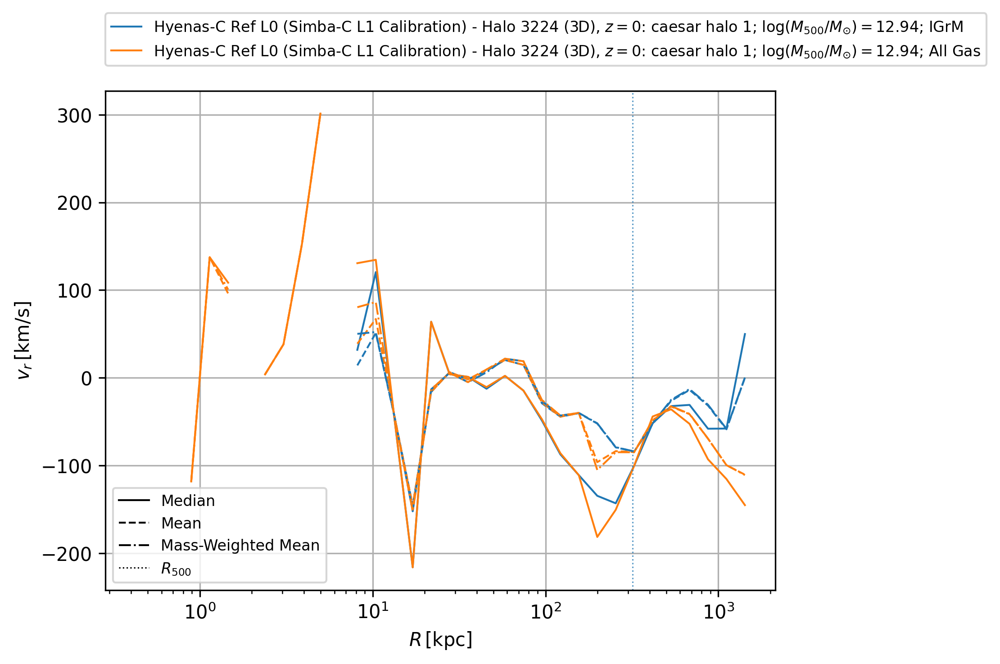

In [40]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-1'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$v_r\,[\mathrm{km/s}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Median', 'Mean',
                      'Mass-Weighted Mean', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1


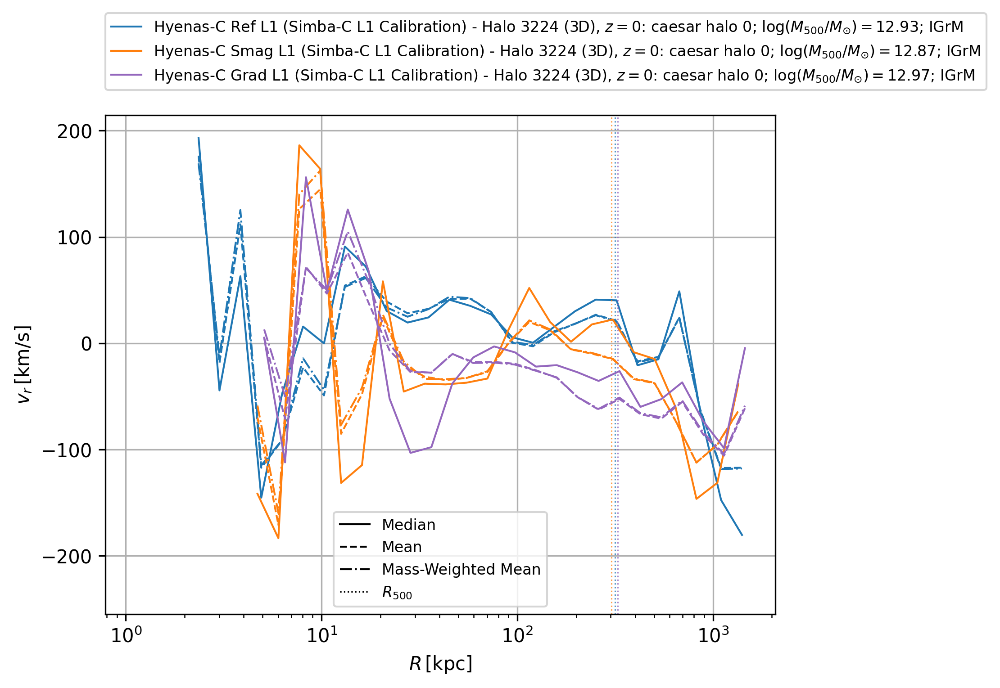

In [28]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-1'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$v_r\,[\mathrm{km/s}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Median', 'Mean',
                      'Mass-Weighted Mean', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1


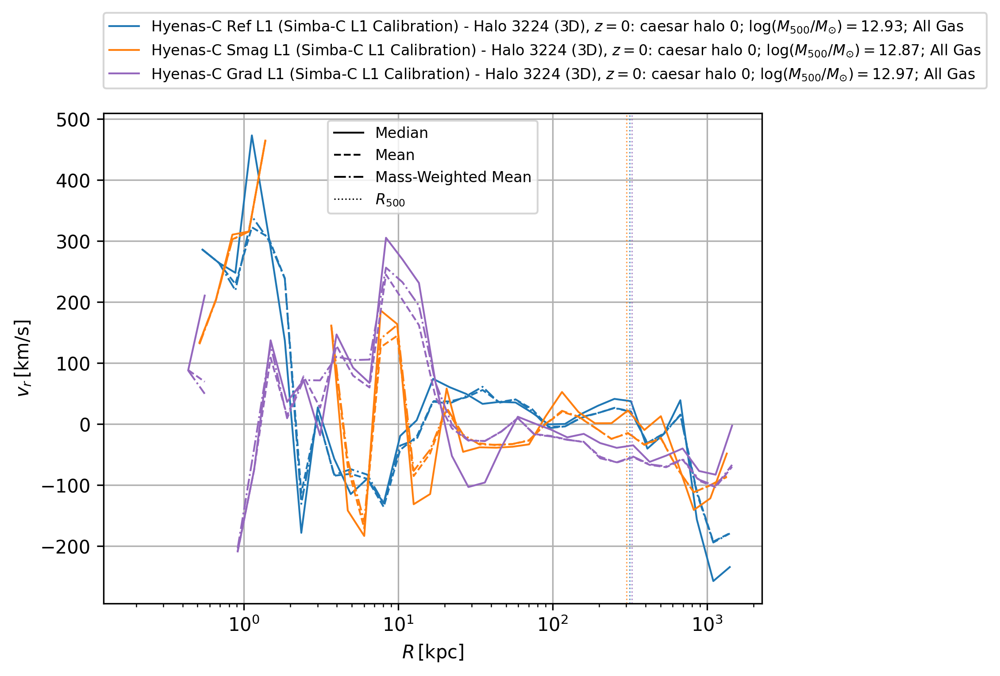

In [29]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-1'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$v_r\,[\mathrm{km/s}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Median', 'Mean',
                      'Mass-Weighted Mean', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1


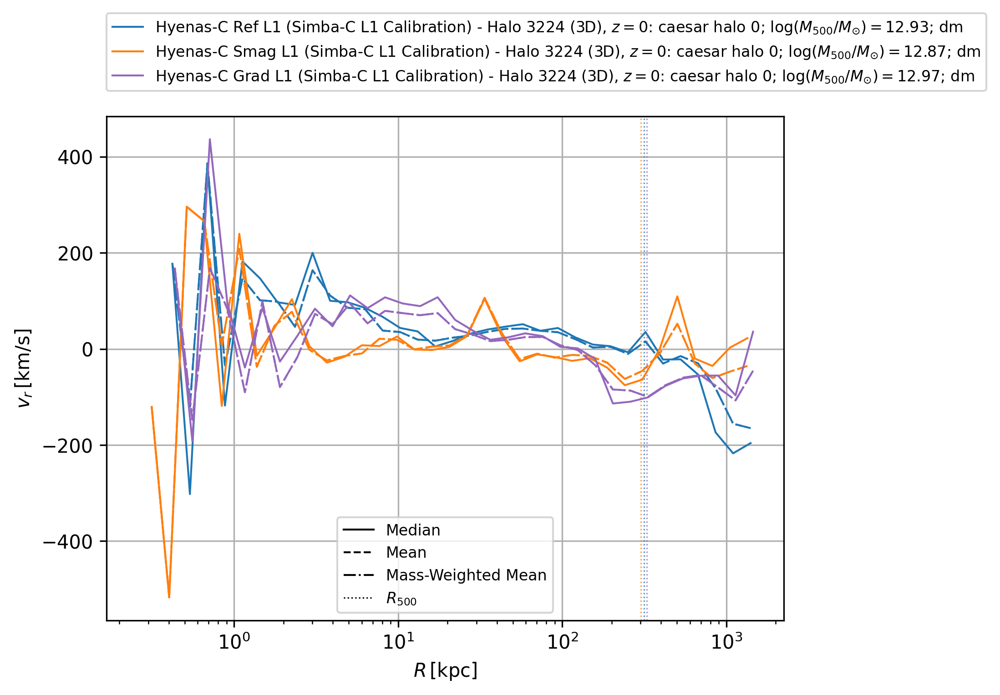

In [30]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-1'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['dm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['vr-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; dm')


        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['vr-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['vr-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$v_r\,[\mathrm{km/s}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Median', 'Mean',
                      'Mass-Weighted Mean', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

## Velocity Magnitude dispersion

km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1


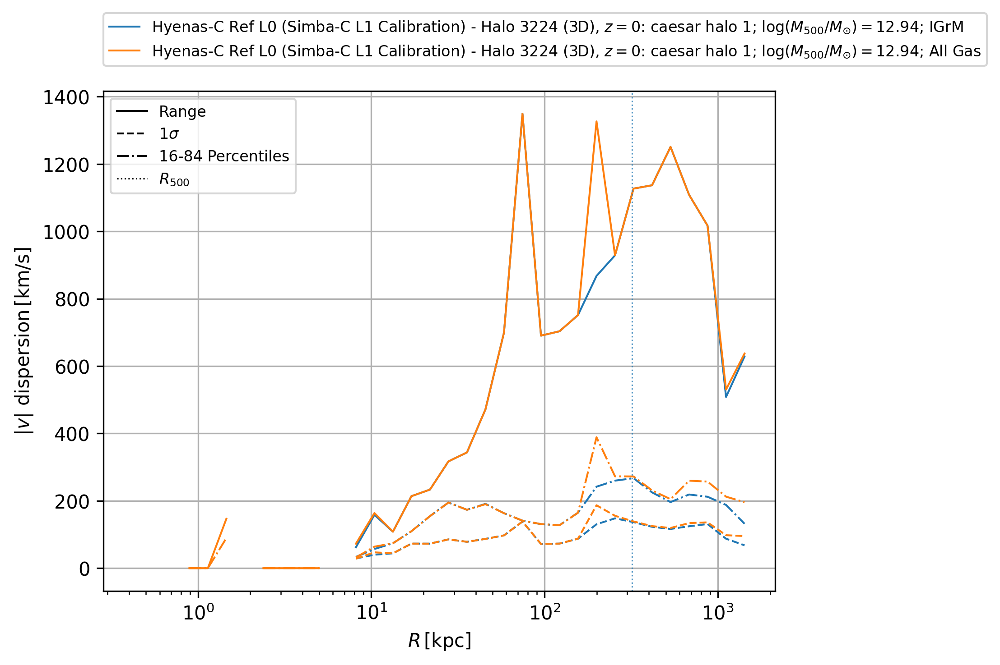

In [42]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-1'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['v_mag-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['v_mag-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['v_mag-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['v_mag-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['v_mag-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['v_mag-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$|v|\,\,\mathrm{dispersion}\,[\mathrm{km/s}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Range', r'$1\sigma$',
                      '16-84 Percentiles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1


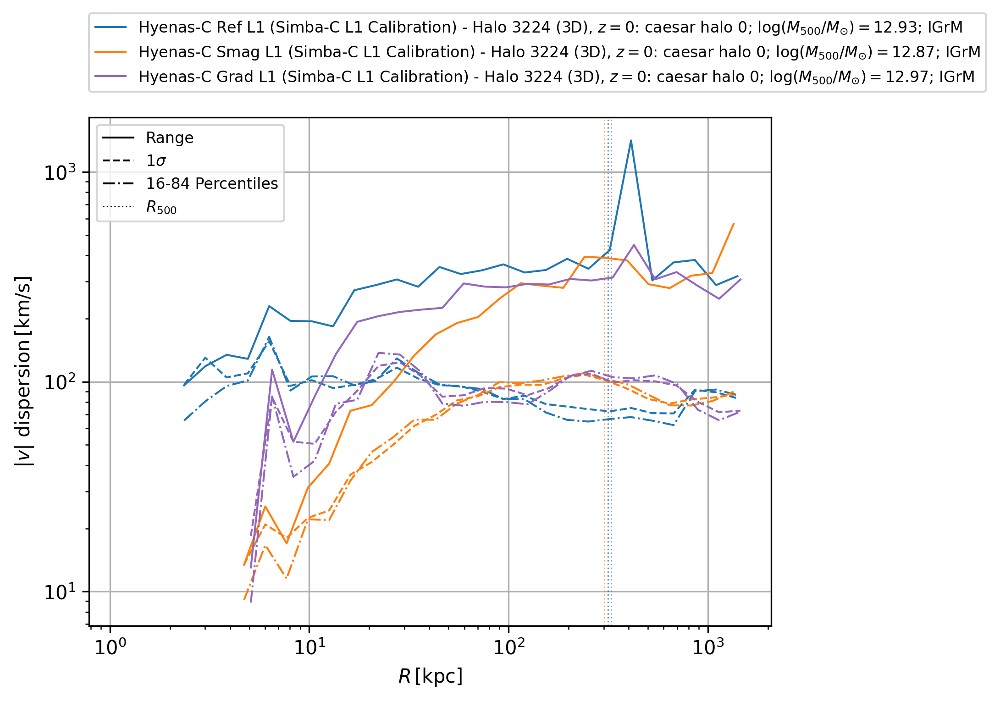

In [32]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-1'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['v_mag-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['v_mag-range']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['v_mag-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['v_mag-std']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['v_mag-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['v_mag-iqr']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$|v|\,\,\mathrm{dispersion}\,[\mathrm{km/s}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Range', r'$1\sigma$',
                      '16-84 Percentiles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1


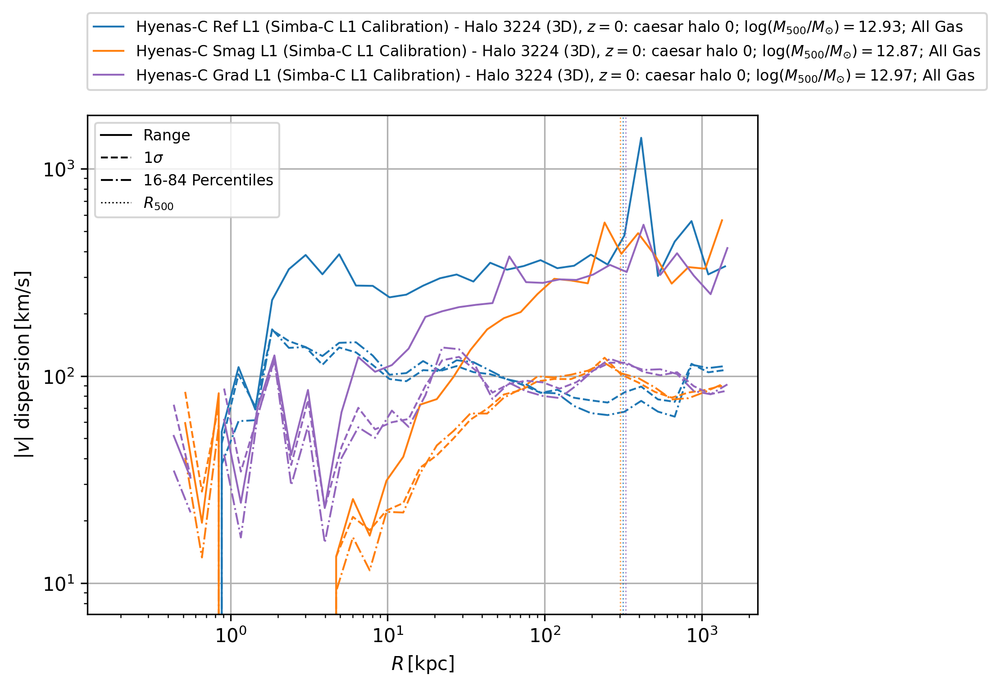

In [34]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-1'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['v_mag-range']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['v_mag-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['v_mag-std']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['v_mag-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['v_mag-iqr']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['v_mag-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$|v|\,\,\mathrm{dispersion}\,[\mathrm{km/s}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Range', r'$1\sigma$',
                      '16-84 Percentiles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1


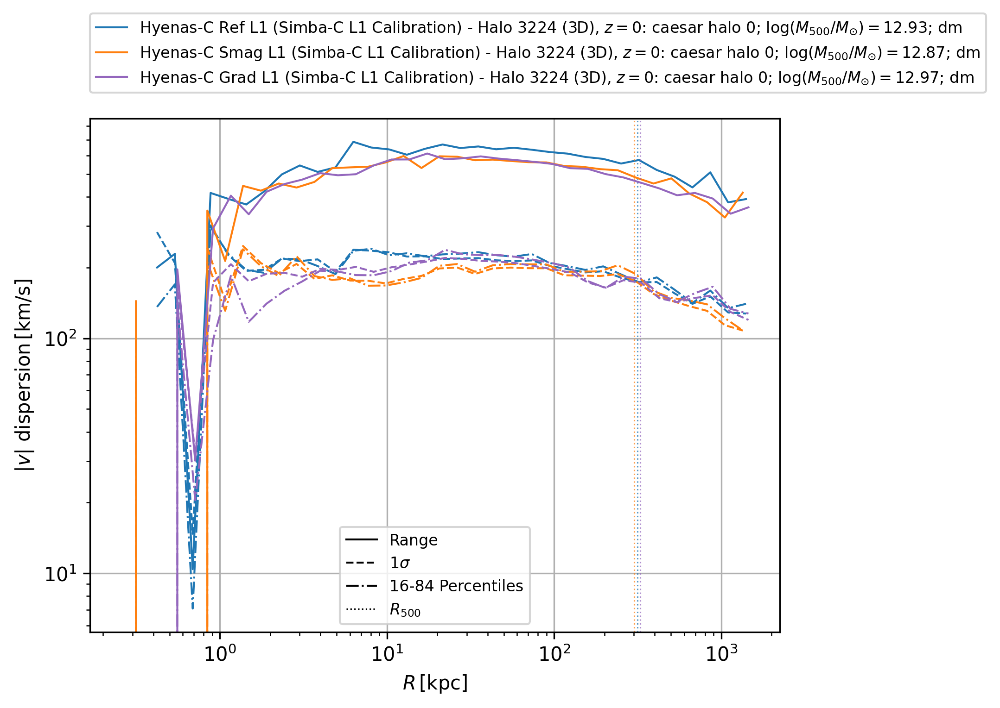

In [36]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-1'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['dm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['v_mag-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; dm')


        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['v_mag-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['v_mag-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$|v|\,\,\mathrm{dispersion}\,[\mathrm{km/s}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Range', r'$1\sigma$',
                      '16-84 Percentiles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

## Radial Velocity dispersion

km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1


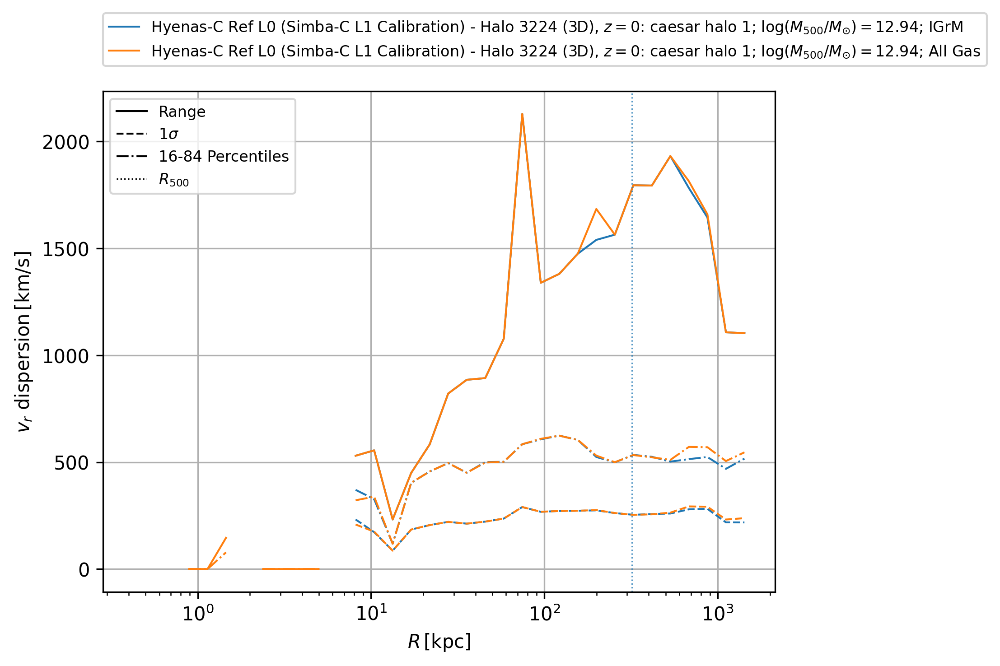

In [44]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-1'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i+1], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$v_r\,\,\mathrm{dispersion}\,[\mathrm{km/s}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Range', r'$1\sigma$',
                      '16-84 Percentiles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1


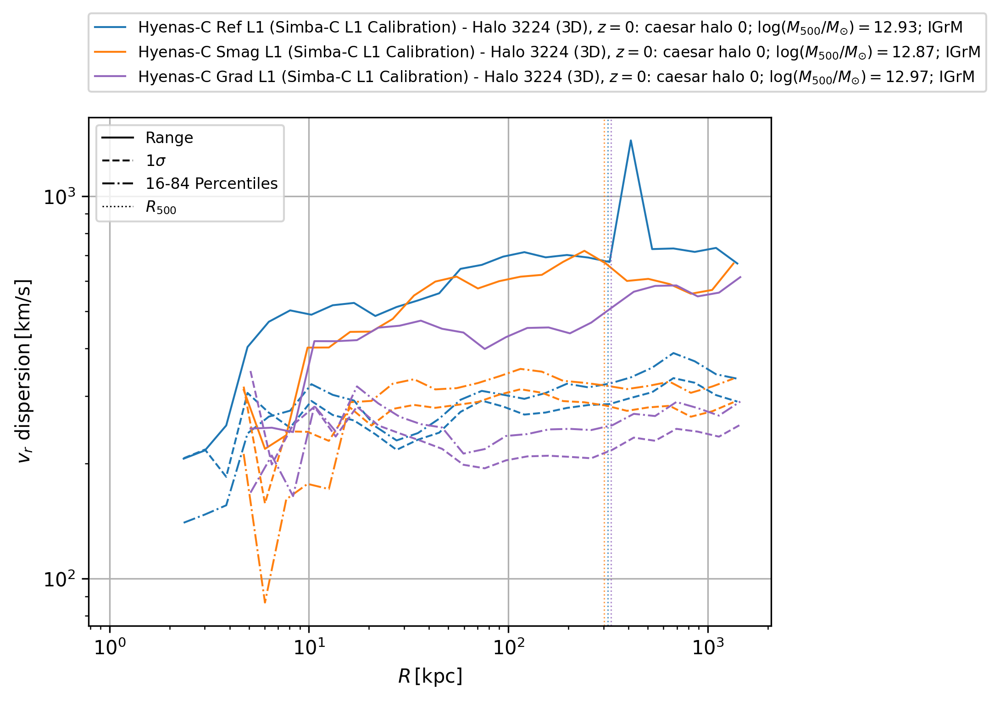

In [38]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-1'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-range']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-std']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-iqr']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$v_r\,\,\mathrm{dispersion}\,[\mathrm{km/s}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Range', r'$1\sigma$',
                      '16-84 Percentiles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1


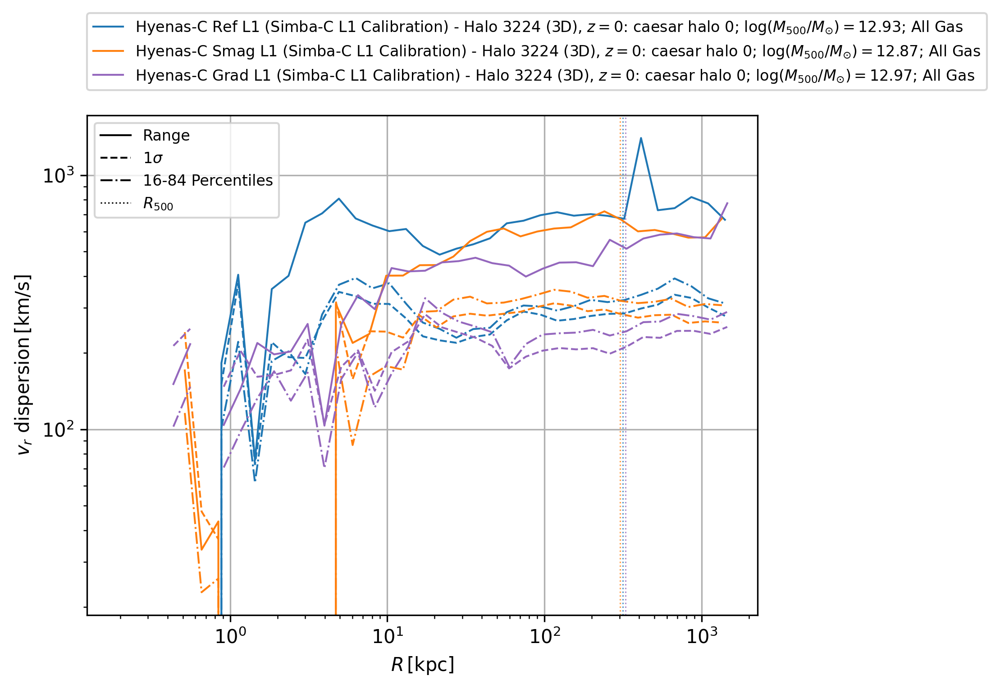

In [40]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-1'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-range']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; IGrM')


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-std']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-iqr']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$v_r\,\,\mathrm{dispersion}\,[\mathrm{km/s}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Range', r'$1\sigma$',
                      '16-84 Percentiles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1
km s**-1


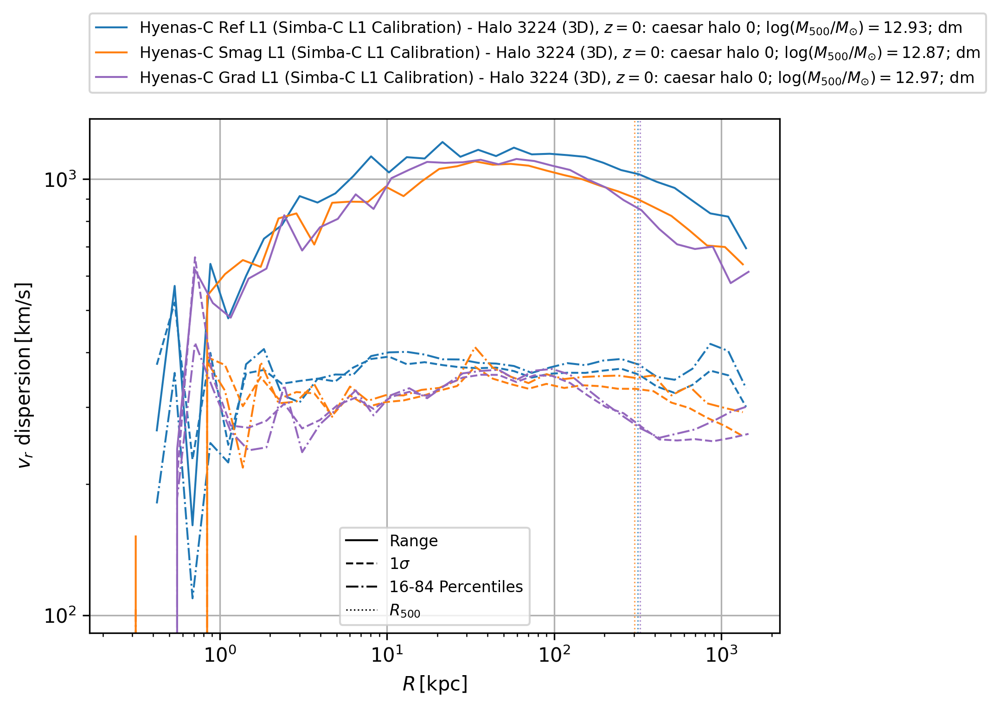

In [42]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = 'km s**-1'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['dm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['vr-range']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; dm')


        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['vr-std']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)


        x_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['dm'][halo_id]['full']['y']['vr-iqr']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$v_r\,\,\mathrm{dispersion}\,[\mathrm{km/s}]$')
ax.legend(fontsize=8, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Range', r'$1\sigma$',
                      '16-84 Percentiles', r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

## Abundance

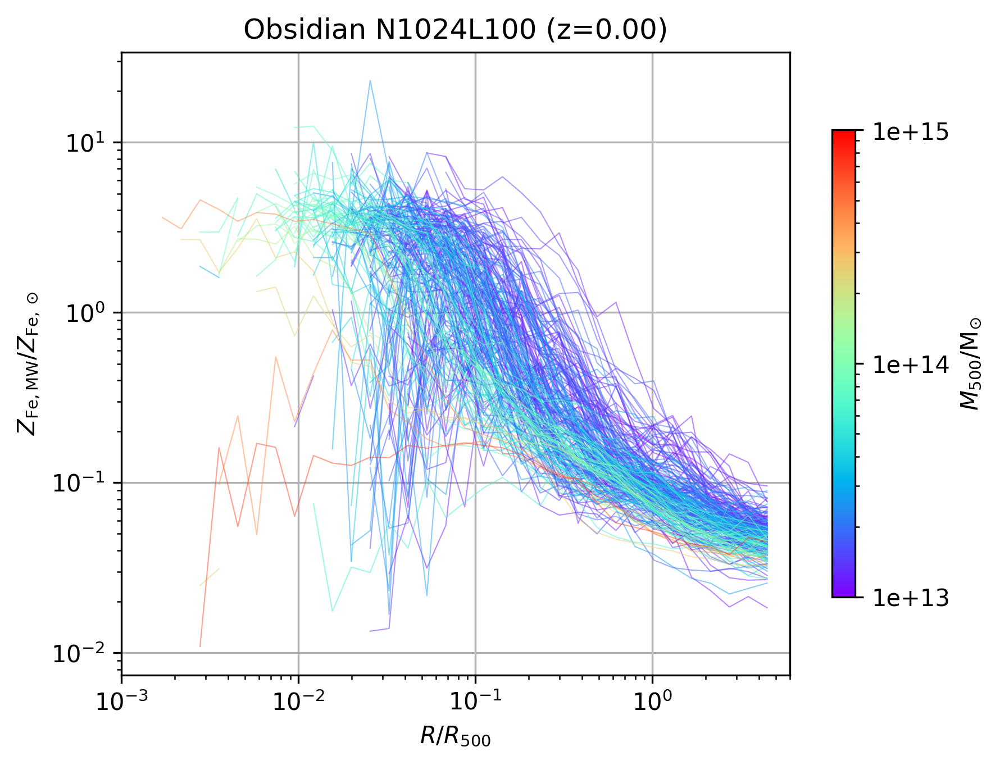

In [43]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0']*9999

lw_list = [0.5]*9999

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['-']*9999

alpha_list = [0.5]*9999

zorder_list = np.linspace(100, 0, 9999)

cmap = plt.get_cmap('rainbow')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.LogNorm(vmin=1e13, vmax=1e15)
# norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

metal = 'Fe'

for i, (sim, sim_info) in enumerate(sim_dict.items()):
    metal_idx = metals_idx[sim_info['sim']][metal]
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        if m500 < pnb.array.SimArray(1e13, units='Msol'): continue
        color = cmap(norm(m500))
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Z-mass_weighted_mean-solar_asplund09'][:,metal_idx]
        # print(y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color, lw=lw_list[i], ls=ls_list[i], alpha=alpha_list[i], zorder=zorder_list[i])
                 # label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 6e0)
# plt.ylim(5e-3, 1e2)

plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$Z_{\mathrm{Fe,MW}}/Z_{\mathrm{Fe},\odot}$')

# title = r'$K=k_B T_{\mathrm{bin}} n_{e,\mathrm{bin}}^{-2/3}$'
# title += '\tL0 (Simba-C L0 Calibration)'
# title += '\t(Simba-C L1 Calibration)'

sim0 = list(sim_dict.keys())[0]
z = sim_dict[sim0]['profile']['cosmo_props']['z']
title = f'Obsidian N1024L100 (z={z:.2f})'
plt.title(title)

ax = plt.gca()
fig = plt.gcf()


# ax.legend(fontsize=8, loc=(0, 1.1))


# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='--',color='black',),
#                            Line2D([],[],lw=2,ls='-',color='black',),],
#               labels=['L0', 'L1'],
#               title='Resolution', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.85))
# ax.add_artist(leg2)

# leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C0',),
#                            Line2D([],[],lw=1,ls='-',color='C1',),
#                            Line2D([],[],lw=1,ls='-',color='C4',),
#                            Line2D([],[],lw=1,ls='-',color='C6',),],
#               labels=['Hyenas Ref', 'Hyenas-C Ref', 'Hyenas-C Smag', 'Hyenas-C Grad'],
#               title='Sub-Grid Model', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.55))
# ax.add_artist(leg3)
# leg3 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='C1',),
#                            Line2D([],[],lw=1,ls='-',color='C4',),
#                            Line2D([],[],lw=1,ls='-',color='C6',),],
#               labels=['Ref', 'Smag', 'Grad'],
#               title='Sub-Grid Model', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.55))
# ax.add_artist(leg3)

# leg4 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',),
#                            Line2D([],[],lw=1,ls='-.',color='black',),
#                            Line2D([],[],lw=1,ls=':',color='black',),],
#               labels=['Full Model', 'Energy Only', 'Momentum Only', 'Metals Only'],
#               title='Turbulent Diffusion', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.25))
# ax.add_artist(leg4)

# leg5 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',alpha=0.5,color='black',),
#                            Line2D([],[],lw=1,ls='-',alpha=1,color='black',),],
#               labels=['L0 Calibration', 'L1 Calibration'],
#               title='Hyenas-C Parameters', title_fontsize=8,
#               fontsize=8, loc=(1.02,0.05))
# ax.add_artist(leg5)


plt.colorbar(mappable=mappable, ax=ax, 
             label=r'$M_{500}/\mathrm{M_{\odot}}$',
             # ticks=z_ticks,
             format='{x:.0e}', pad=0.05, shrink=0.75)

fig.set_dpi(300)
plt.show()

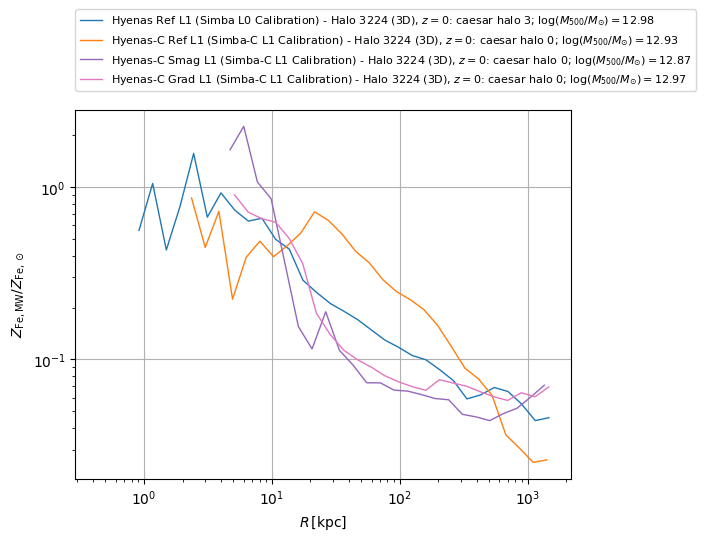

In [508]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C4', 'C4']
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
# ls_list = ['-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-', '--', '-.']

i = 0

metal = 'Fe'

for sim, sim_info in sim_dict.items():
    metal_idx = metals_idx[sim_info['sim']][metal]
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Z-mass_weighted_mean-solar_asplund09'][:,metal_idx]
        # print(x_profile)#, x_profile.units)
        # print(y_profile, y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')
        # print()
        i += 1

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$Z_{\mathrm{Fe,MW}}/Z_{\mathrm{Fe},\odot}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',)],
#               labels=[r'$dP_{\mathrm{IGrM,VW}}/dR$', r'$-GM(<R)\rho(r)/R^2$'],
#               fontsize=8)
# ax.add_artist(leg2)
plt.show()

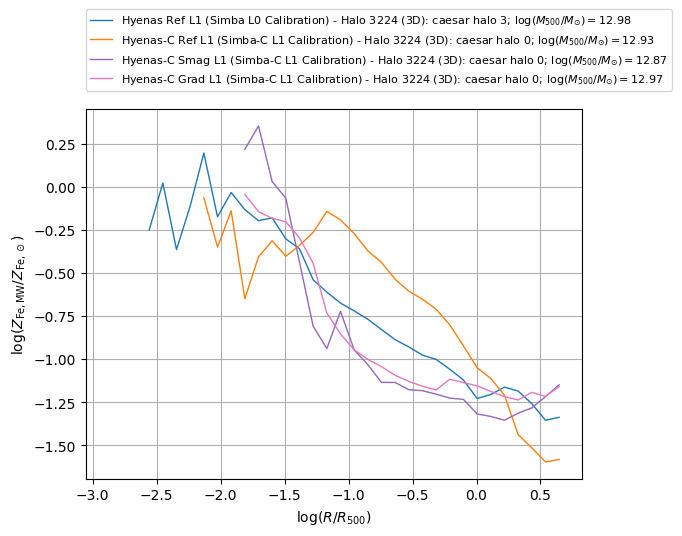

In [154]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C4', 'C4']
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
# ls_list = ['-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-', '--', '-.']

i = 0

metal = 'Fe'

for sim, sim_info in sim_dict.items():
    metal_idx = metals_idx[sim_info['sim']][metal]
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['log_rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['log_Z-mass_weighted_mean-solar_asplund09'][:,metal_idx]
        # print(x_profile)#, x_profile.units)
        # print(y_profile, y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')
        # print()
        i += 1

plt.grid()
# plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$\log(R/R_{500})$')
plt.ylabel(r'$\log(Z_{\mathrm{Fe,MW}}/Z_{\mathrm{Fe},\odot})$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',)],
#               labels=[r'$dP_{\mathrm{IGrM,VW}}/dR$', r'$-GM(<R)\rho(r)/R^2$'],
#               fontsize=8)
# ax.add_artist(leg2)
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


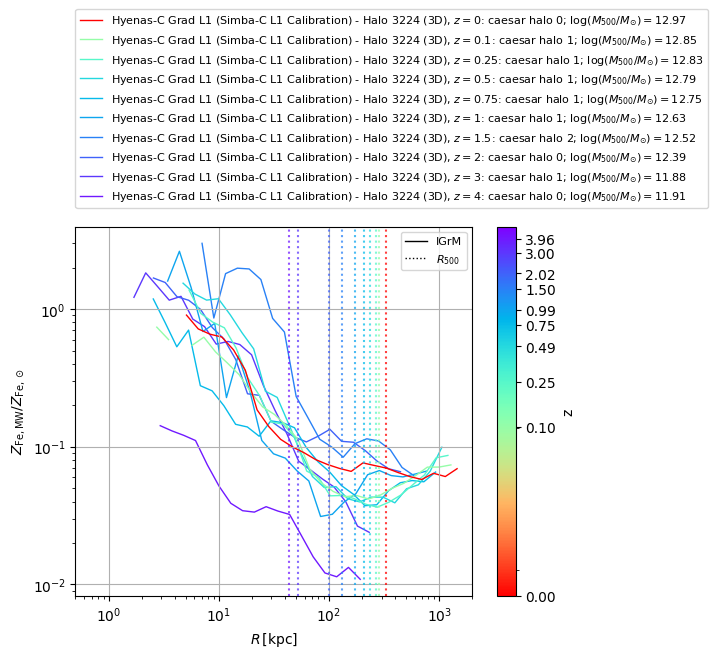

In [492]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

metal = 'Fe'
units = '1'

i = 0
for sim, sim_info in sim_dict.items():
    metal_idx = metals_idx[sim_info['sim']][metal]
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Z-mass_weighted_mean-solar_asplund09'][:,metal_idx]
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(5e-1, 2e3)
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$Z_{\mathrm{Fe,MW}}/Z_{\mathrm{Fe},\odot}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           Line2D([],[],lw=1,ls=':',color='black',),],
              labels=['IGrM',
                  # r'$KE(R)/V_{\mathrm{bin}}(R)$',
                      # r'$\left. \sum V_i KE_i \middle/ \sum V_i \right.$',
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00
1.00e+00


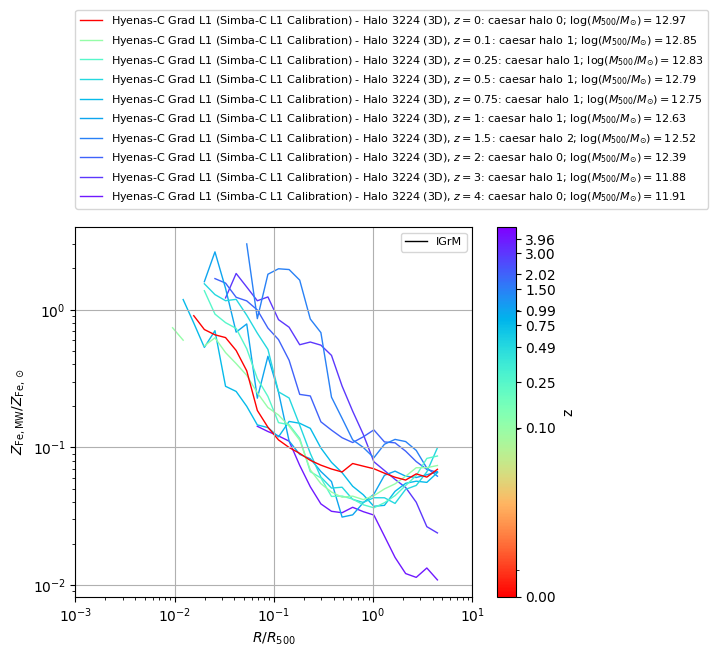

In [493]:
## Redshift evolution

# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
# color_list = ['C0', 'C1', 'C4', 'C6']
color_list = ['C0'] * 10

# lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]
lw_list = [1] * 10

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']
ls_list = ['-'] * 10

# alpha_list = np.linspace(1, 0.1, 10)
alpha_list = [1] * 10
# print(alpha_list)

zorder_list = np.linspace(1, 0, 10)
# print(zorder_list)

cmap = plt.get_cmap('rainbow_r')
# norm = mcolors.Normalize(vmin=0, vmax=5)
norm = mcolors.SymLogNorm(linthresh=0.05, vmin=0, vmax=5)
mappable = cm.ScalarMappable(norm=norm, cmap=cmap)

z_ticks = []

metal = 'Fe'
units = '1'

i = 0
for sim, sim_info in sim_dict.items():
    metal_idx = metals_idx[sim_info['sim']][metal]
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    z = sim_info['profile']['cosmo_props']['z']
    z_ticks.append(float(z))
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        color = cmap(norm(z))

        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Z-mass_weighted_mean-solar_asplund09'][:,metal_idx]
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color, lw=lw_list[i], ls='-', alpha=alpha_list[i], zorder=zorder_list[i],
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        # plt.axvline(x=r500, color=color, alpha=0.75, ls=':')
        
        
        i += 1
        

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlim(1e-3, 1e1)
plt.xlabel(r'$R/R_{500}$')
plt.ylabel(r'$Z_{\mathrm{Fe,MW}}/Z_{\mathrm{Fe},\odot}$')
ax = plt.gca()
ax.legend(fontsize=8, loc=(0, 1.05))
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),],
                           # Line2D([],[],lw=1,ls='--',color='black',),
                           # Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),],
              labels=['IGrM',],
                  # r'$KE(R)/V_{\mathrm{bin}}(R)$',
                      # r'$\left. \sum V_i KE_i \middle/ \sum V_i \right.$',
                      # r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
plt.colorbar(mappable=mappable, ax=ax, label='z', ticks=z_ticks, format='{x:.2f}')
plt.show()

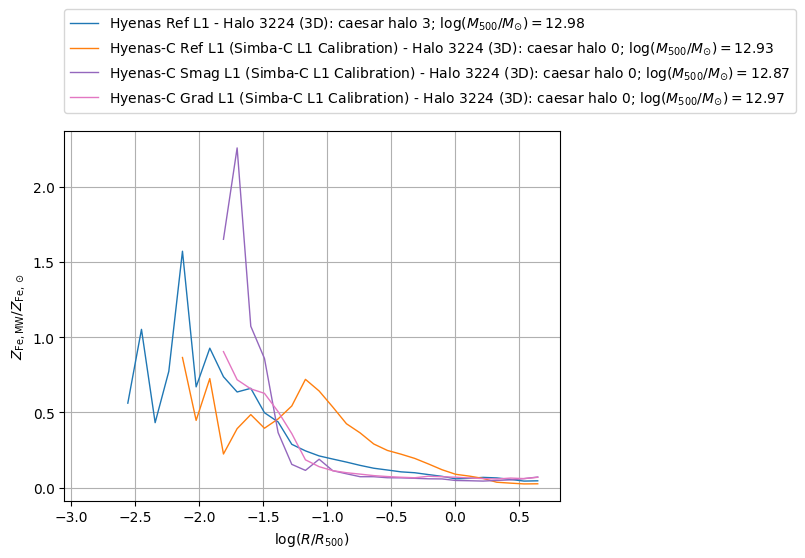

In [309]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C4', 'C4']
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
# ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

i = 0

metal = 'Fe'

for sim, sim_info in sim_dict.items():
    metal_idx = metals_idx[sim_info['sim']][metal]
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['log_rbin_r500_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['Z-mass_weighted_mean-solar_asplund09'][:,metal_idx]
        # print(x_profile)#, x_profile.units)
        # print(y_profile, y_profile.units)
        plt.plot(x_profile, y_profile,
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=rf'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}' )
        # print()
        i += 1

plt.grid()
# plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$\log(R/R_{500})$')
plt.ylabel(r'$Z_{\mathrm{Fe,MW}}/Z_{\mathrm{Fe},\odot}$')
plt.legend(fontsize=10, loc=(0, 1.05))
plt.show()

## Number of Black Holes

1.00e+00
1.00e+00


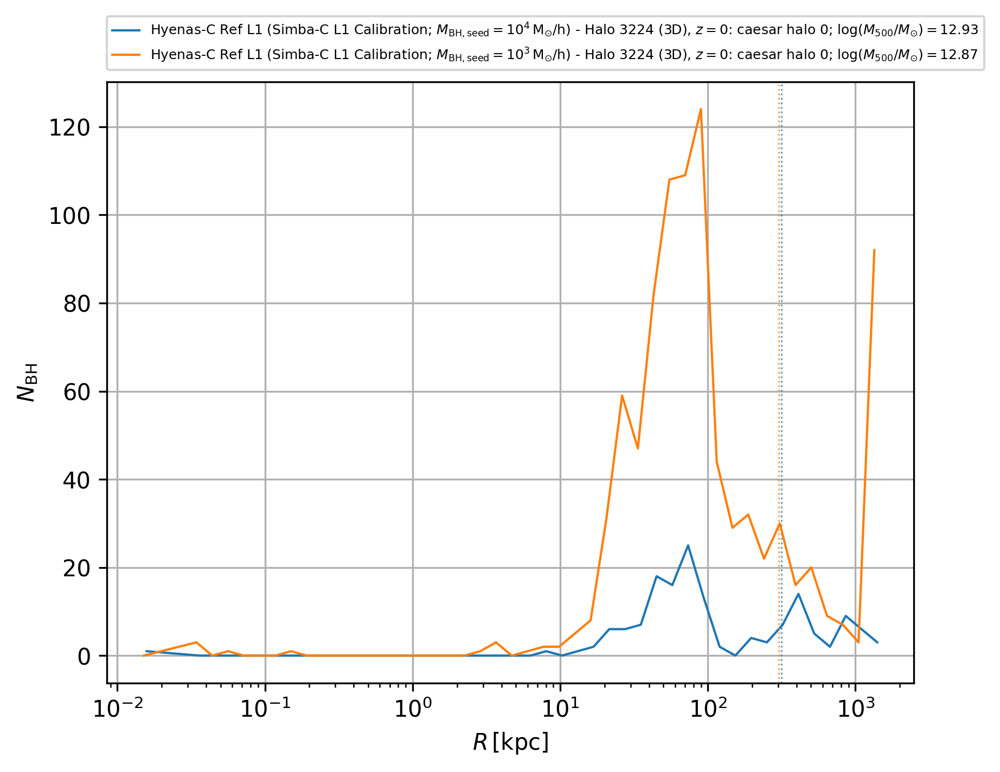

In [24]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = '1' #pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['y']['n']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
# plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$N_{\mathrm{BH}}$')
ax.legend(fontsize=6, loc=(0, 1.02))
# ax.add_artist(leg1)
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',),
#                            Line2D([],[],lw=1,ls='-.',color='black',),
#                            Line2D([],[],lw=1,ls=':',color='black',),
#                            # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
#                            Line2D([],[],lw=0.75,ls=':',color='black',)],
#               labels=['Total NWindLaunches', 'Median NWindLaunches', 'Mean NWindLaunches',
#                       'Mass-Weighted Mean NWindLaunches', r'$R_{500}$'],
#               fontsize=8)
# ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

## Black Hole Mass

NoUnit()
NoUnit()


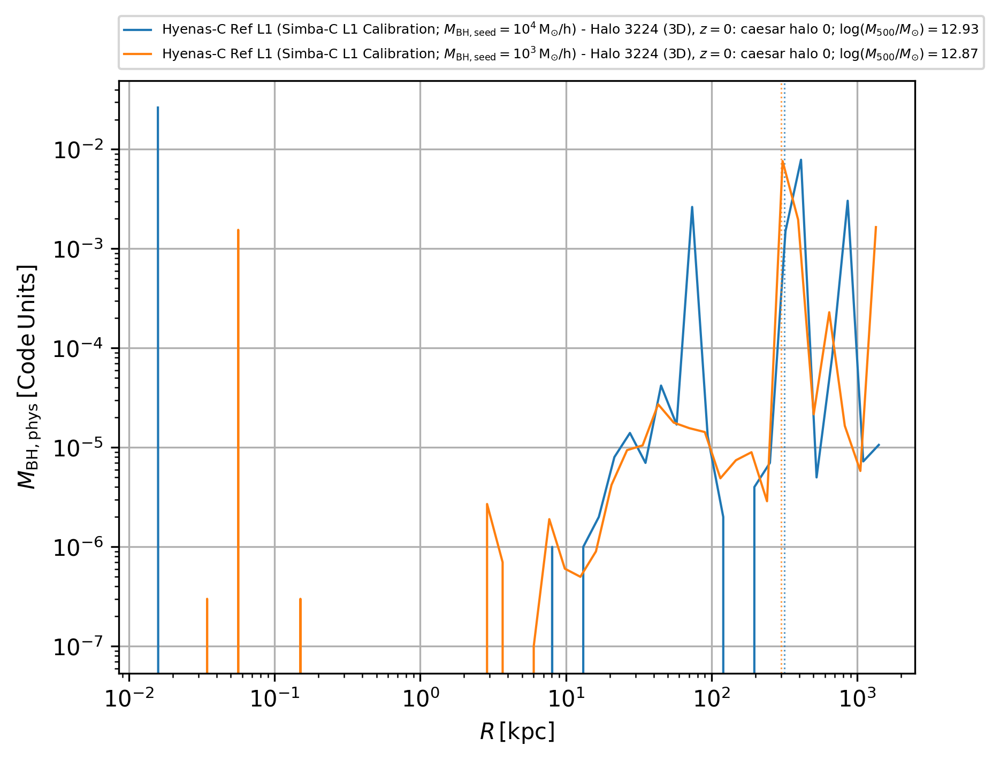

In [23]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit()
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['igrm']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['y']['BH_Mass']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$M_{\mathrm{BH,phys}}\,[\mathrm{Code\,Units}]$')
ax.legend(fontsize=6, loc=(0, 1.02))
# ax.add_artist(leg1)
# leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
#                            Line2D([],[],lw=1,ls='--',color='black',),
#                            Line2D([],[],lw=1,ls='-.',color='black',),
#                            Line2D([],[],lw=1,ls=':',color='black',),
#                            # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
#                            Line2D([],[],lw=0.75,ls=':',color='black',)],
#               labels=['Total NWindLaunches', 'Median NWindLaunches', 'Mean NWindLaunches',
#                       'Mass-Weighted Mean NWindLaunches', r'$R_{500}$'],
#               fontsize=8)
# ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()

## BH Accretion Rate

NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()
NoUnit()


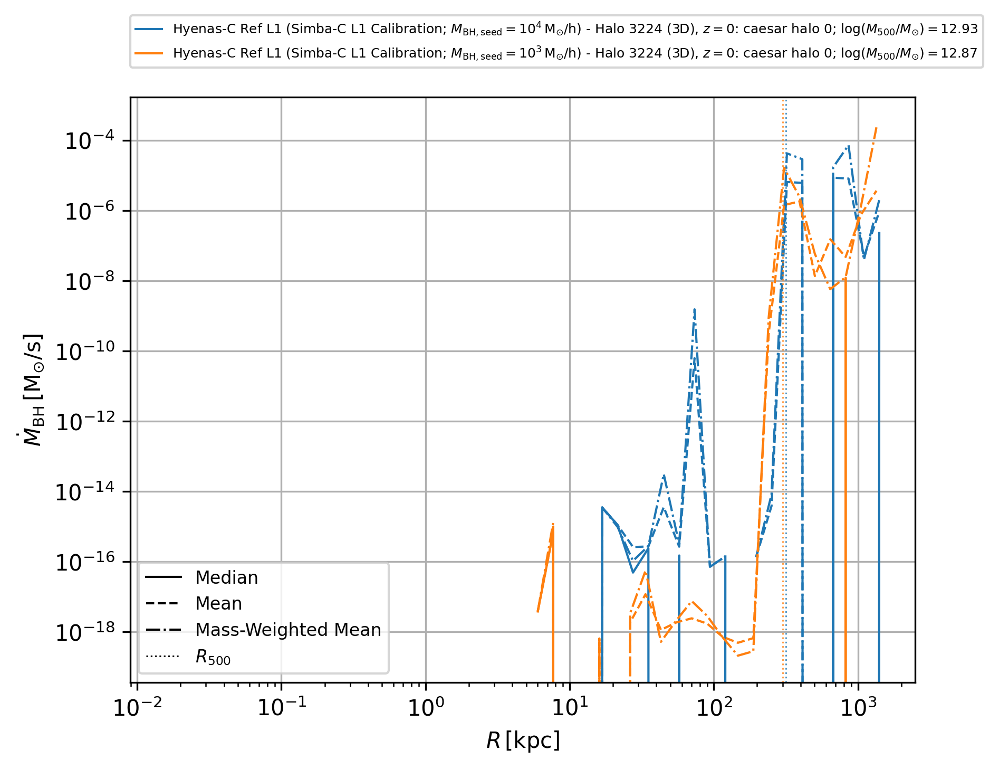

In [26]:
# color_list = ['C0', 'C0', 'C1', 'C1', 'C2', 'C2', 'C3', 'C3', 'C4', 'C4', 'C5', 'C5',]
# color_list = ['C0', 'C4', 'C0', 'C1', 'C4',]
color_list = ['C0', 'C1', 'C4', 'C6', 'C7']

lw_list = [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,]

# ls_list = ['-', '--', '-', '--', '-', '--', '-', '--', '-', '--', '-', '--']
ls_list = ['--', '--', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-']

units = pnb.units.NoUnit() #'Msun s**-1'
# print(units)
i = 0

for sim, sim_info in sim_dict.items():
    # halo_ids = sim_info['profile']['halo_ids']['full']
    halo_ids = sim_info['profile']['halo_ids']['bh']['full']
    for halo_id in halo_ids:
        m500 = sim_info['profile']['halo_info'][halo_id]['M']['500']
        r500 = sim_info['profile']['halo_info'][halo_id]['R']['500']
        
        x_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['x']['physical_rbin_centres']
        # x_profile = sim_info['profile']['xaxis']['full']['bin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['y']['BH_Mdot-median']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-',
                 label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}')


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-median']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-',
        #          label=f'{sim}: caesar halo {halo_id}; ' + r'$\log(M_{500}/M_{\odot})=$' +f'{np.log10(m500):.2f}; All Gas')


        x_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['y']['BH_Mdot-mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='--',)

        
        x_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['x']['physical_rbin_centres']
        
        y_profile = sim_info['profile']['halo_profiles']['bh'][halo_id]['full']['y']['BH_Mdot-mass_weighted_mean']
        print(y_profile.units)
        plt.plot(x_profile, y_profile.in_units(units),
                 color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='--',)


        # x_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['igrm'][halo_id]['full']['y']['vr-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)


        # x_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['x']['physical_rbin_centres']
        
        # y_profile = sim_info['profile']['halo_profiles']['gas'][halo_id]['full']['y']['vr-mass_weighted_mean']
        # print(y_profile.units)
        # plt.plot(x_profile, y_profile.in_units(units),
        #          color=color_list[i], lw=lw_list[i], ls='-.',)

        
        plt.axvline(x=r500, color=color_list[i], alpha=0.75, lw=0.75, ls=':')#, zorder=zorder_list[j])
        
        i += 1

ax = plt.gca()
fig = plt.gcf()
# print(ax)

plt.grid()
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$R\,[\mathrm{kpc}]$')
plt.ylabel(r'$\dot{M}_{\mathrm{BH}}\,[\mathrm{M_{\odot}/s}]$')
ax.legend(fontsize=6, loc=(0, 1.05))
# ax.add_artist(leg1)
leg2 = Legend(ax, handles=[Line2D([],[],lw=1,ls='-',color='black',),
                           Line2D([],[],lw=1,ls='--',color='black',),
                           Line2D([],[],lw=1,ls='-.',color='black',),
                           # Line2D([],[],lw=1,ls=':',color='black',),
                           # Line2D([],[],lw=1,ls=(0,(3,1,1,1,1,1)),color='black',),
                           Line2D([],[],lw=0.75,ls=':',color='black',)],
              labels=['Median', 'Mean',
                      'Mass-Weighted Mean', 
                      r'$R_{500}$'],
              fontsize=8)
ax.add_artist(leg2)
fig.set_dpi(300)
plt.show()